In [1]:
from matplotlib import pylab as plt
import numpy as np
from sklearn.gaussian_process import GaussianProcessRegressor

import numpy as np
from matplotlib import pylab as plt
from matplotlib.ticker import ScalarFormatter
from bayes_opt import BayesianOptimization
from bayes_opt import acquisition
from scipy.stats import norm

In [2]:
import random

random.seed(10)
print(random.random())

0.5714025946899135


In [3]:
class GPUCB(object):

  def __init__(self, data, environment,d,r,RS=0):
    
    self.data = data
    self.environment = environment
    self.r = r
    self.d=d
    self.RS=RS
    self.t=0

    self.X_grid = self.data
    print(self.X_grid.shape)
    self.mu = np.array([0. for _ in range(self.X_grid.shape[0])])
    self.sigma = np.array([0.5 for _ in range(self.X_grid.shape[0])])
    self.X = []
    self.T = []

  def beta_t(self):
    self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05))) 
    self.t=self.t+1
    print(self.beta_k)
    return(self.beta_k)
  def argmax_ucb(self):
    
    return np.argmax( self.mu+self.sigma * np.sqrt(self.beta_t())) #self.mu + self.sigma * np.sqrt(self.beta) self.beta

  def y_max(self):
      return np.max(self.T)
    
  def max_point(self):
    maxGrididx = np.argmax(self.mu)
    x, y = self.X_grid[maxGrididx]
    maxMu = np.amax(self.mu)
    print("\nMaximal point found by python code is %lf at x %lf %lf\n" % (maxMu,x,y) )
    

  def learn(self):
    grid_idx = self.argmax_ucb()
    self.sample(self.X_grid[grid_idx])
    gp = GaussianProcessRegressor(random_state=self.RS)
    gp.fit(self.X, self.T)
    self.mu, self.sigma = gp.predict(self.X_grid, return_std=True)

  
  def sample(self, x, printSampled=True):
    t = self.environment.sample(x)
    if printSampled:
        print("(python) Sampled: ",x," result: %lf" % ( t))
    self.X.append(x)
    self.T.append(t)

In [4]:
class greedy(object):

  def __init__(self, data, environment,RS=0):
    
    self.data = data
    self.environment = environment
    
    self.RS=RS
    self.t=0

    self.X_grid = self.data
    print(self.X_grid.shape)
    self.mu = np.array([0. for _ in range(self.X_grid.shape[0])])
    self.sigma = np.array([0.5 for _ in range(self.X_grid.shape[0])])
    self.X = []
    self.T = []

  
  def argmax_ucb(self):
    
    return np.argmax( self.mu) #self.mu + self.sigma * np.sqrt(self.beta) self.beta
  def y_max(self):
      return np.max(self.T)
    
    
  def max_point(self):
    maxGrididx = np.argmax(self.mu)
    x, y = self.X_grid[maxGrididx]
    maxMu = np.amax(self.mu)
    print("\nMaximal point found by python code is %lf at x \n" % (maxMu))
    

  def learn(self):
    grid_idx = self.argmax_ucb()
    self.sample(self.X_grid[grid_idx])
    gp = GaussianProcessRegressor(random_state=self.RS)
    gp.fit(self.X, self.T)
    self.mu, self.sigma = gp.predict(self.X_grid, return_std=True)

  
  def sample(self, x, printSampled=True):
    t = self.environment.sample(x)
    if printSampled:
        print("(python) Sampled: ",x," result: %lf" % ( t))
    self.X.append(x)
    self.T.append(t)

In [5]:
class pure_exploration(object):

  def __init__(self, data, environment,RS=0):
    
    self.data = data
    self.environment = environment
    
    self.RS=RS
    self.t=0

    self.X_grid = self.data
    print(self.X_grid.shape)
    self.mu = np.array([0. for _ in range(self.X_grid.shape[0])])
    self.sigma = np.array([0.5 for _ in range(self.X_grid.shape[0])])
    self.X = []
    self.T = []

  
  def argmax_ucb(self):
    
    return np.argmax(self.sigma) #self.mu + self.sigma * np.sqrt(self.beta) self.beta
  def y_max(self):
      return np.max(self.T)
    
  def max_point(self):
    maxGrididx = np.argmax(self.mu)
    x, y = self.X_grid[maxGrididx]
    maxMu = np.amax(self.mu)
    print("\nMaximal point found by python code is %lf at x \n" % (maxMu))
    

  def learn(self):
    grid_idx = self.argmax_ucb()
    self.sample(self.X_grid[grid_idx])
    gp = GaussianProcessRegressor(random_state=self.RS)
    gp.fit(self.X, self.T)
    self.mu, self.sigma = gp.predict(self.X_grid, return_std=True)

  
  def sample(self, x, printSampled=True):
    t = self.environment.sample(x)
    if printSampled:
        print("(python) Sampled: ",x," result: %lf" % ( t))
    self.X.append(x)
    self.T.append(t)

In [7]:
class PI(object):

  def __init__(self, data, environment, xi=200,RS=0):
    
    self.data = data
    self.environment = environment
    self.xi = xi
    self.RS=RS
    self.t=0

    self.X_grid = self.data
    print(self.X_grid.shape)
    self.mu = np.array([0. for _ in range(self.X_grid.shape[0])])
    self.sigma = np.array([0.5 for _ in range(self.X_grid.shape[0])])
    self.X = []
    self.T = []
    

  
  def argmax_pi(self):
    
    return np.argmax( norm.cdf((self.mu-self.y_max()-self.xi)/self.sigma)) #self.mu + self.sigma * np.sqrt(self.beta) self.beta
      
  def y_max(self):
      if self.T==[]:
          return 0
      else:
          return np.max(self.T)
    
    
  def max_point(self):
    maxGrididx = np.argmax(self.mu)
    x, y = self.X_grid[maxGrididx]
    maxMu = np.amax(self.mu)
    print("\nMaximal point found by python code is %lf at x \n" % (maxMu))
    

  def learn(self):
    grid_idx = self.argmax_pi()
    self.sample(self.X_grid[grid_idx])
    gp = GaussianProcessRegressor(random_state=self.RS)
    gp.fit(self.X, self.T)
    self.mu, self.sigma = gp.predict(self.X_grid, return_std=True)

  
  def sample(self, x, printSampled=True):
    t = self.environment.sample(x)
    if printSampled:
        print("(python) Sampled: ",x," result: %lf" % ( t))
    self.X.append(x)
    self.T.append(t)

In [8]:
class EI(object):

  def __init__(self, data, environment, xi=200,RS=0):
    
    self.data = data
    self.environment = environment
    self.xi = xi
    self.RS=RS
    self.t=0

    self.X_grid = self.data
    print(self.X_grid.shape)
    self.mu = np.array([0. for _ in range(self.X_grid.shape[0])])
    self.sigma = np.array([0.5 for _ in range(self.X_grid.shape[0])])
    self.X = []
    self.T = []
    

  
  def argmax_ei(self):
    
    return np.argmax( (self.mu-self.y_max()-self.xi)*norm.cdf((self.mu-self.y_max()-self.xi)
                                                              /self.sigma)+self.sigma*norm.pdf((self.mu-self.y_max()-self.xi)/self.sigma)) #self.mu + self.sigma * np.sqrt(self.beta) self.beta
      
  def y_max(self):
      if self.T==[]:
          return 0
      else:
          return np.max(self.T)
    
    
  def max_point(self):
    maxGrididx = np.argmax(self.mu)
    x, y = self.X_grid[maxGrididx]
    maxMu = np.amax(self.mu)
    print("\nMaximal point found by python code is %lf at x \n" % (maxMu))
    

  def learn(self):
    grid_idx = self.argmax_ei()
    self.sample(self.X_grid[grid_idx])
    gp = GaussianProcessRegressor(random_state=self.RS)
    gp.fit(self.X, self.T)
    self.mu, self.sigma = gp.predict(self.X_grid, return_std=True)

  
  def sample(self, x, printSampled=True):
    t = self.environment.sample(x)
    if printSampled:
        print("(python) Sampled: ",x," result: %lf" % ( t))
    self.X.append(x)
    self.T.append(t)

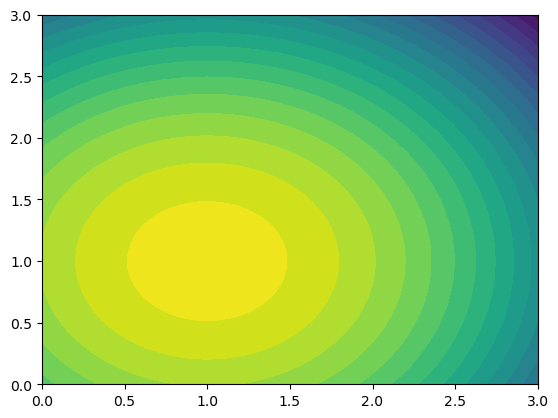

In [9]:
def black_box_function_1(x):
    return -(x[0]-1)**2-(x[1]-1)**2+5+np.random.normal(0,0.05)

data1=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])

u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
# domain (0,2)^2

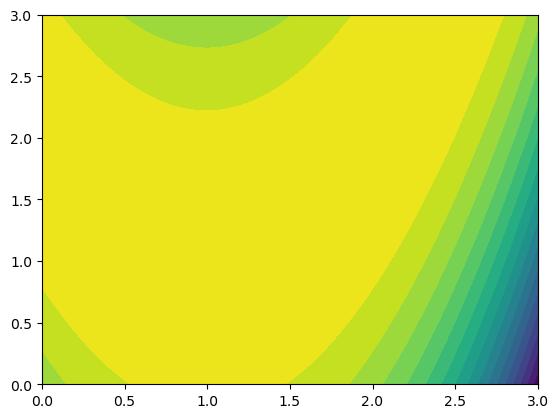

In [10]:
def black_box_function_2(x):
    return -(1-(x[0]-1))**2-100*((x[1]-1)-(x[0]-1)**2)**2 +np.random.normal(0,0.05)

data2=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])
u2=np.linspace(0,3,100)
v2=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u2,v2)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')# domain (-2,2)X(-1,3)

In [12]:
def black_box_function_3(x):
    
    alpha = np.array([1.0, 1.2, 3.0, 3.2])
    A = np.array([[3.0, 10.0, 30.0],
                  [0.1, 10.0, 35.0],
                  [3.0, 10.0, 30.0],
                  [0.1, 10.0, 35.0]])
    P = np.array([[0.3689, 0.1170, 0.2673],
                  [0.4699, 0.4387, 0.7470],
                  [0.1091, 0.8732, 0.5547],
                  [0.03815, 0.5743, 0.8828]])

    
    outer_sum = 0.0
    for i in range(4):
        inner_sum = 0.0
        for j in range(3):
            inner_sum += A[i][j] * (x[j] - P[i][j]) ** 2
        outer_sum += alpha[i] * np.exp(-inner_sum)
        
    return outer_sum+np.random.normal(0,0.05)
data3=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[10000,3])

x = [0.1, 0.5, 0.9]
print("Hartman 3D function value:", black_box_function_3(x))

Hartman 3D function value: 3.556032722651639


## Simulation for 1st function

## Simulation UCB

In [25]:
# for f_2
S=30
regret_gpucb=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_1(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = GPUCB(data_sim, env,d=2,r=3,RS=s)
    for i in range(200):
        agent.learn()
    f_values_gpucb=agent.T
    f_max=5                   # remember to change this value #5
                                                              #0
    regret_simple_gpucb=f_max-np.array(f_values_gpucb)
    regret_gpucb.append(np.cumsum(regret_simple_gpucb))

regret_gpucb = np.asarray(regret_gpucb) #/np.arange(1,201)
mean_regret_gpucb = np.mean(regret_gpucb, axis=0)
var_regret_gpucb = np.var(regret_gpucb, axis=0)

start of iteration number: 1
(10000, 2)
inf
(python) Sampled:  [2.28103159 1.67912719]  result: 2.902995
101.65212366626375
(python) Sampled:  [0.84243981 2.38695172]  result: 3.065483
200.02314071891894
(python) Sampled:  [0.82054318 0.62661245]  result: 4.773437
271.82086326512433
(python) Sampled:  [2.33882413e+00 4.06198812e-05]  result: 2.209300
329.143150662339
(python) Sampled:  [2.96603819 2.99611847]  result: -2.856223
377.25336924955576
(python) Sampled:  [0.00172324 1.45763283]  result: 3.866062
418.9278809845833
(python) Sampled:  [0.02985722 0.01848152]  result: 3.065695
455.8229361690333
(python) Sampled:  [0.0097714  2.99074075]  result: -0.045284
489.012153496524
(python) Sampled:  [2.99705511 0.90626353]  result: 0.996232
519.2343363559902
(python) Sampled:  [1.65352369 2.99788297]  result: 0.554871
547.0213367847697
(python) Sampled:  [1.26545671e+00 3.35070325e-04]  result: 3.847375
572.7697669498258
(python) Sampled:  [1.74083046 0.93746835]  result: 4.418748
596.78

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


911.5373682213558
(python) Sampled:  [2.21538789 2.99395285]  result: -0.485455
921.8208317951093
(python) Sampled:  [0.32392263 2.36413872]  result: 2.695653
931.8607621094397
(python) Sampled:  [2.99954575 1.49343264]  result: 0.641006
941.6693660192805
(python) Sampled:  [2.02006156 0.30425946]  result: 3.432306
951.2579287786708
(python) Sampled:  [2.34124906 1.15355448]  result: 3.186655
960.6369059031123
(python) Sampled:  [0.22038572 1.94421278]  result: 3.488735
969.8160037615386
(python) Sampled:  [0.00985672 1.07859801]  result: 4.054981
978.8042505274924
(python) Sampled:  [6.84599554e-04 2.73348688e+00]  result: 0.999090
987.610058849492
(python) Sampled:  [2.0477091  2.04878167]  result: 2.788751
996.2412813809101
(python) Sampled:  [1.52748048 0.22451164]  result: 4.156353
1004.7052601297988
(python) Sampled:  [1.81401644 0.59376566]  result: 4.191851
1013.0088704410322
(python) Sampled:  [2.79113221 0.40331983]  result: 1.408889
1021.1585603006839
(python) Sampled:  [0.9

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


640.5172897618917
(python) Sampled:  [2.93590852 2.98495526]  result: -2.738106
660.5835980291174
(python) Sampled:  [1.20525835 0.50911915]  result: 4.730868
679.6301492214739
(python) Sampled:  [2.29763536 1.59373057]  result: 3.036889
697.7644488955817
(python) Sampled:  [2.47542789 0.6246363 ]  result: 2.729872
715.0773547422529
(python) Sampled:  [0.54447557 0.41321248]  result: 4.385376
731.6463959390958
(python) Sampled:  [0.78867417 2.99757425]  result: 1.029986
747.5382972107486
(python) Sampled:  [0.47700263 1.47473193]  result: 4.532115
762.8109271212483
(python) Sampled:  [2.99475341 2.11066846]  result: -0.170748
777.5148222500466
(python) Sampled:  [1.02264327 1.63612311]  result: 4.597456
791.6943940704294
(python) Sampled:  [1.26577208 2.34899979]  result: 3.093647
805.3888950957959
(python) Sampled:  [0.7058543  0.89418886]  result: 4.845160
818.6332000475828
(python) Sampled:  [1.2648666  1.03765288]  result: 4.835847
831.4584432303665
(python) Sampled:  [0.0083944 0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


879.0875662311352
(python) Sampled:  [1.03271565 1.02041968]  result: 4.985212
890.1857596919293
(python) Sampled:  [0.82388007 0.69962906]  result: 4.939256
900.9971378371887
(python) Sampled:  [2.98752656 0.54622096]  result: 0.751804
911.5373682213558
(python) Sampled:  [0.28158312 1.05599954]  result: 4.494215
921.8208317951093
(python) Sampled:  [0.76073481 2.99856957]  result: 0.976207
931.8607621094397
(python) Sampled:  [2.67985548 2.56039735]  result: -0.190132
941.6693660192805
(python) Sampled:  [0.64153532 1.95238751]  result: 3.934084
951.2579287786708
(python) Sampled:  [1.39065587 1.32572818]  result: 4.857266
960.6369059031123
(python) Sampled:  [1.74492845 1.21272812]  result: 4.456659
969.8160037615386
(python) Sampled:  [2.31144881 0.33083081]  result: 2.775561
978.8042505274924
(python) Sampled:  [0.3504738 2.9856863]  result: 0.652286
987.610058849492
(python) Sampled:  [0.91081969 0.86954743]  result: 4.899117
996.2412813809101
(python) Sampled:  [2.99687373 2.511

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


867.6854420507261
(python) Sampled:  [1.76929606 0.96063191]  result: 4.391734
879.0875662311352
(python) Sampled:  [1.93274989 1.94079734]  result: 3.318932
890.1857596919293
(python) Sampled:  [1.73591198 2.99714134]  result: 0.447998
900.9971378371887
(python) Sampled:  [1.62926731 0.34177364]  result: 4.184565
911.5373682213558
(python) Sampled:  [0.00810744 1.83097194]  result: 3.341509
921.8208317951093
(python) Sampled:  [0.45946331 2.61830858]  result: 2.048424
931.8607621094397
(python) Sampled:  [0.96740551 0.84200735]  result: 5.053357
941.6693660192805
(python) Sampled:  [2.9894016  2.20555311]  result: -0.385803
951.2579287786708
(python) Sampled:  [2.00857927 1.48445155]  result: 3.738831
960.6369059031123
(python) Sampled:  [0.2453954  0.35055071]  result: 4.003832
969.8160037615386
(python) Sampled:  [0.30236884 0.00987298]  result: 3.510780
978.8042505274924
(python) Sampled:  [1.00194043 2.64033045]  result: 2.265808
987.610058849492
(python) Sampled:  [0.78003792 1.4

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


715.0773547422529
(python) Sampled:  [0.00424409 0.50663509]  result: 3.737239
731.6463959390958
(python) Sampled:  [2.43354025 0.58391077]  result: 2.700066
747.5382972107486
(python) Sampled:  [1.52069224 1.15753012]  result: 4.684835
762.8109271212483
(python) Sampled:  [0.66725974 2.99954243]  result: 0.921392
777.5148222500466
(python) Sampled:  [0.73239071 1.44401799]  result: 4.778339
791.6943940704294
(python) Sampled:  [0.55279055 1.00187454]  result: 4.848328
805.3888950957959
(python) Sampled:  [1.11488574 1.40556697]  result: 4.764070
818.6332000475828
(python) Sampled:  [1.09522416 0.562608  ]  result: 4.794887
831.4584432303665
(python) Sampled:  [1.26194147 0.85475843]  result: 4.854700
843.8925429388612
(python) Sampled:  [0.84560273 0.8624505 ]  result: 4.889083
855.9606362455148
(python) Sampled:  [0.83041351 1.12490563]  result: 4.988454
867.6854420507261
(python) Sampled:  [0.90773734 1.11927966]  result: 4.954075
879.0875662311352
(python) Sampled:  [2.31104582 2.9

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


900.9971378371887
(python) Sampled:  [0.06389288 0.0095472 ]  result: 3.097571
911.5373682213558
(python) Sampled:  [0.43813473 2.48018149]  result: 2.512219
921.8208317951093
(python) Sampled:  [1.35609485 0.3614641 ]  result: 4.513954
931.8607621094397
(python) Sampled:  [1.43177979 1.35988194]  result: 4.648135
941.6693660192805
(python) Sampled:  [1.48289493 2.54399429]  result: 2.409272
951.2579287786708
(python) Sampled:  [2.52705996 0.0099947 ]  result: 1.647288
960.6369059031123
(python) Sampled:  [0.98923296 1.11526079]  result: 4.959070
969.8160037615386
(python) Sampled:  [0.78702833 0.88649717]  result: 4.887421
978.8042505274924
(python) Sampled:  [2.68912144 2.46258858]  result: 0.045142
987.610058849492
(python) Sampled:  [1.5585068  0.00680716]  result: 3.742704
996.2412813809101
(python) Sampled:  [0.00769843 2.75575952]  result: 0.883238
1004.7052601297988
(python) Sampled:  [2.12042207 2.40378913]  result: 1.784455
1013.0088704410322
(python) Sampled:  [0.31955867 2.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


867.6854420507261
(python) Sampled:  [0.5814453  0.01000544]  result: 3.813605
879.0875662311352
(python) Sampled:  [0.93830333 1.00837018]  result: 4.998927
890.1857596919293
(python) Sampled:  [0.80477637 0.98876462]  result: 5.008797
900.9971378371887
(python) Sampled:  [0.83706438 1.01174775]  result: 5.011885
911.5373682213558
(python) Sampled:  [0.83706438 1.01174775]  result: 5.035025
921.8208317951093
(python) Sampled:  [2.62807013 2.37876659]  result: 0.383667
931.8607621094397
(python) Sampled:  [0.48983482 2.99486259]  result: 0.724786
941.6693660192805
(python) Sampled:  [2.90967983 1.21086177]  result: 1.232943
951.2579287786708
(python) Sampled:  [2.55879717 0.01381905]  result: 1.561814
960.6369059031123
(python) Sampled:  [0.20427268 0.00201462]  result: 3.421326
969.8160037615386
(python) Sampled:  [0.33107095 2.18205506]  result: 3.040092
978.8042505274924
(python) Sampled:  [1.09455558 0.29154527]  result: 4.405109
987.610058849492
(python) Sampled:  [2.66000463 1.80

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


791.6943940704294
(python) Sampled:  [1.37293495 1.85904625]  result: 4.088659
805.3888950957959
(python) Sampled:  [1.10105797 0.95084704]  result: 4.996857
818.6332000475828
(python) Sampled:  [0.30870488 2.22021764]  result: 3.056520
831.4584432303665
(python) Sampled:  [0.89802701 1.15104904]  result: 5.030417
843.8925429388612
(python) Sampled:  [1.01922205 1.12624577]  result: 5.002667
855.9606362455148
(python) Sampled:  [2.65040849 2.99744342]  result: -1.735207
867.6854420507261
(python) Sampled:  [2.17736011 1.48027756]  result: 3.334512
879.0875662311352
(python) Sampled:  [0.85764057 1.76170741]  result: 4.370578
890.1857596919293
(python) Sampled:  [8.71815277e-04 2.52153778e+00]  result: 1.692917
900.9971378371887
(python) Sampled:  [0.95125355 0.89193949]  result: 5.077714
911.5373682213558
(python) Sampled:  [0.95274    0.81865466]  result: 4.951087
921.8208317951093
(python) Sampled:  [2.52057887 0.33908847]  result: 2.243678
931.8607621094397
(python) Sampled:  [2.761

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


843.8925429388612
(python) Sampled:  [1.0436804  0.85478823]  result: 4.909828
855.9606362455148
(python) Sampled:  [2.99918468 0.26807877]  result: 0.475201
867.6854420507261
(python) Sampled:  [1.31557548 2.52313526]  result: 2.526626
879.0875662311352
(python) Sampled:  [0.36817439 2.43920558]  result: 2.558595
890.1857596919293
(python) Sampled:  [1.13374877 0.0264828 ]  result: 4.004387
900.9971378371887
(python) Sampled:  [1.32388537 1.0141453 ]  result: 4.879916
911.5373682213558
(python) Sampled:  [2.15139658 2.99412564]  result: -0.292226
921.8208317951093
(python) Sampled:  [1.49935481 0.2816254 ]  result: 4.261898
931.8607621094397
(python) Sampled:  [2.99076307 0.0158099 ]  result: 0.136824
941.6693660192805
(python) Sampled:  [2.2323609  0.98213989]  result: 3.412384
951.2579287786708
(python) Sampled:  [0.66558297 0.2663629 ]  result: 4.306206
960.6369059031123
(python) Sampled:  [2.02083547e+00 2.98828206e-04]  result: 2.887298
969.8160037615386
(python) Sampled:  [0.255

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


(python) Sampled:  [2.99318482 2.98762286]  result: -2.904399
489.012153496524
(python) Sampled:  [1.57293874 1.52159158]  result: 4.403568
519.2343363559902
(python) Sampled:  [2.99927532 0.02082356]  result: 0.026347
547.0213367847697
(python) Sampled:  [0.00664371 1.13600846]  result: 4.005468
572.7697669498258
(python) Sampled:  [2.99872877 1.85883595]  result: 0.328412
596.7838915948072
(python) Sampled:  [0.8484902 1.9246308]  result: 4.277414
619.3026315918867
(python) Sampled:  [8.88753686e-01 6.81462754e-04]  result: 3.911678
640.5172897618917
(python) Sampled:  [0.02918119 2.97005314]  result: 0.108770
660.5835980291174
(python) Sampled:  [1.7140906  0.70743821]  result: 4.337369
679.6301492214739
(python) Sampled:  [2.27901858 1.52378953]  result: 3.062914
697.7644488955817
(python) Sampled:  [0.56904671 1.41352908]  result: 4.584379
715.0773547422529
(python) Sampled:  [1.59660482 2.99576855]  result: 0.614230
731.6463959390958
(python) Sampled:  [0.31302645 0.47576482]  re

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


640.5172897618917
(python) Sampled:  [1.35194353e-04 9.24837360e-01]  result: 4.040155
660.5835980291174
(python) Sampled:  [0.94436577 2.99311878]  result: 1.071665
679.6301492214739
(python) Sampled:  [1.17439363 0.60664492]  result: 4.785988
697.7644488955817
(python) Sampled:  [2.9935578  2.98322762]  result: -2.909584
715.0773547422529
(python) Sampled:  [0.54908459 2.18948651]  result: 3.419147
731.6463959390958
(python) Sampled:  [0.44215641 0.46036055]  result: 4.363954
747.5382972107486
(python) Sampled:  [2.34649676 0.52166585]  result: 2.975802
762.8109271212483
(python) Sampled:  [1.13915286 1.08972932]  result: 5.048403
777.5148222500466
(python) Sampled:  [2.44837296 1.37493277]  result: 2.758588
791.6943940704294
(python) Sampled:  [1.52845771 1.44686842]  result: 4.559057
805.3888950957959
(python) Sampled:  [0.85168909 0.83261436]  result: 4.889473
818.6332000475828
(python) Sampled:  [1.32575919 0.00728018]  result: 3.890171
831.4584432303665
(python) Sampled:  [0.575

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


747.5382972107486
(python) Sampled:  [1.08019028 0.47662326]  result: 4.769684
762.8109271212483
(python) Sampled:  [0.00576801 0.61979941]  result: 3.876857
777.5148222500466
(python) Sampled:  [1.6407134  1.26509125]  result: 4.491891
791.6943940704294
(python) Sampled:  [0.8085581  2.99834707]  result: 0.981938
805.3888950957959
(python) Sampled:  [1.61836167 0.38359863]  result: 4.220373
818.6332000475828
(python) Sampled:  [0.67781838 1.00415329]  result: 4.913269
831.4584432303665
(python) Sampled:  [1.09170207 1.36642331]  result: 4.782514
843.8925429388612
(python) Sampled:  [0.86863001 0.78739305]  result: 4.932615
855.9606362455148
(python) Sampled:  [0.98520461 1.02829678]  result: 4.995742
867.6854420507261
(python) Sampled:  [1.07764087 0.88595221]  result: 4.935184
879.0875662311352
(python) Sampled:  [1.31006203 2.54842348]  result: 2.567897
890.1857596919293
(python) Sampled:  [0.69334973 0.36308711]  result: 4.526435
900.9971378371887
(python) Sampled:  [2.59219598 0.3

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


101.65212366626375
(python) Sampled:  [0.9939566  0.79253033]  result: 4.964793
200.02314071891894
(python) Sampled:  [2.46325907 1.04248387]  result: 2.893091
271.82086326512433
(python) Sampled:  [2.99721528 2.97470868]  result: -2.930556
329.143150662339
(python) Sampled:  [2.15810544e-04 1.77060029e+00]  result: 3.464855
377.25336924955576
(python) Sampled:  [0.04262845 0.0294397 ]  result: 3.202952
418.9278809845833
(python) Sampled:  [2.96212688 0.0120699 ]  result: 0.248680
455.8229361690333
(python) Sampled:  [0.07253584 2.98923806]  result: 0.161000
489.012153496524
(python) Sampled:  [1.55059462 0.00175951]  result: 3.672047
519.2343363559902
(python) Sampled:  [2.99676011 1.79098022]  result: 0.385589
547.0213367847697
(python) Sampled:  [1.74111677 2.9950105 ]  result: 0.479780
572.7697669498258
(python) Sampled:  [1.92248723 1.77957851]  result: 3.549589
596.7838915948072
(python) Sampled:  [0.0113641  0.84665925]  result: 4.065209
619.3026315918867
(python) Sampled:  [0.7

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


777.5148222500466
(python) Sampled:  [0.70054095 1.10801125]  result: 4.877792
791.6943940704294
(python) Sampled:  [2.9997966 2.0629653]  result: 0.041798
805.3888950957959
(python) Sampled:  [1.39380839 1.00522314]  result: 4.917842
818.6332000475828
(python) Sampled:  [1.36881388 0.00214523]  result: 3.912248
831.4584432303665
(python) Sampled:  [1.03399689 1.16000209]  result: 4.953698
843.8925429388612
(python) Sampled:  [0.84265775 0.84073866]  result: 4.852158
855.9606362455148
(python) Sampled:  [1.08178198 0.37242662]  result: 4.521204
867.6854420507261
(python) Sampled:  [2.48976975 1.43036006]  result: 2.631610
879.0875662311352
(python) Sampled:  [0.8315191  1.44165487]  result: 4.691054
890.1857596919293
(python) Sampled:  [0.29995693 0.00271466]  result: 3.581593
900.9971378371887
(python) Sampled:  [1.19477592 0.83586806]  result: 4.934899
911.5373682213558
(python) Sampled:  [0.3059363 2.5561227]  result: 2.258037
921.8208317951093
(python) Sampled:  [1.12302838 2.99887

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


619.3026315918867
(python) Sampled:  [2.99621926 2.07743513]  result: -0.183549
640.5172897618917
(python) Sampled:  [2.98490234 0.0131531 ]  result: 0.095666
660.5835980291174
(python) Sampled:  [2.09755589 2.98245539]  result: -0.145637
679.6301492214739
(python) Sampled:  [0.54230797 0.00404649]  result: 3.830506
697.7644488955817
(python) Sampled:  [0.00358738 1.81087277]  result: 3.310017
715.0773547422529
(python) Sampled:  [1.25448151 2.23465313]  result: 3.448567
731.6463959390958
(python) Sampled:  [0.4592738  1.23951997]  result: 4.699009
747.5382972107486
(python) Sampled:  [0.30913688 0.55377344]  result: 4.277545
762.8109271212483
(python) Sampled:  [2.34291459 1.28704747]  result: 3.064065
777.5148222500466
(python) Sampled:  [1.12977995 1.0029724 ]  result: 4.941799
791.6943940704294
(python) Sampled:  [2.53426596 0.61444295]  result: 2.510654
805.3888950957959
(python) Sampled:  [1.49954728 0.50338247]  result: 4.467685
818.6332000475828
(python) Sampled:  [0.75515278 0

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


572.7697669498258
(python) Sampled:  [2.98999009 2.16560981]  result: -0.261451
596.7838915948072
(python) Sampled:  [0.01832453 2.9947949 ]  result: 0.090284
619.3026315918867
(python) Sampled:  [2.04794712 2.05120864]  result: 2.824741
640.5172897618917
(python) Sampled:  [0.00784092 1.60731787]  result: 3.743103
660.5835980291174
(python) Sampled:  [0.80196754 0.00197894]  result: 4.006369
679.6301492214739
(python) Sampled:  [0.68921802 1.64790934]  result: 4.494655
697.7644488955817
(python) Sampled:  [1.24272429 2.25347647]  result: 3.346022
715.0773547422529
(python) Sampled:  [2.24419849 0.0062266 ]  result: 2.464914
731.6463959390958
(python) Sampled:  [2.26793271 1.43708787]  result: 3.144889
747.5382972107486
(python) Sampled:  [0.83545873 1.09127927]  result: 5.018231
762.8109271212483
(python) Sampled:  [1.42831331 0.93804038]  result: 4.767963
777.5148222500466
(python) Sampled:  [0.00267786 0.61648042]  result: 3.876244
791.6943940704294
(python) Sampled:  [0.43368463 0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [0.01524354 0.43051424]  result: 3.749265
931.8607621094397
(python) Sampled:  [0.41964982 2.78486346]  result: 1.462160
941.6693660192805
(python) Sampled:  [2.61508269 0.51051331]  result: 2.127784
951.2579287786708
(python) Sampled:  [1.32413634 2.790426  ]  result: 1.574960
960.6369059031123
(python) Sampled:  [2.99366205 1.86429834]  result: 0.249002
969.8160037615386
(python) Sampled:  [2.23159461 0.88696302]  result: 3.511448
978.8042505274924
(python) Sampled:  [2.3002655  1.72175848]  result: 2.867203
987.610058849492
(python) Sampled:  [2.33160351 2.68554447]  result: 0.478109
996.2412813809101
(python) Sampled:  [1.95850686e+00 1.71350011e-03]  result: 3.019060
1004.7052601297988
(python) Sampled:  [0.25181305 0.00109422]  result: 3.496611
1013.0088704410322
(python) Sampled:  [0.62231936 1.35645508]  result: 4.746640
1021.1585603006839
(python) Sampled:  [1.71484530e-03 2.12461532e+00]  result: 2.684377
1029.1603855508163
(python) Sample

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


791.6943940704294
(python) Sampled:  [0.54345553 1.62477683]  result: 4.435342
805.3888950957959
(python) Sampled:  [0.00259365 1.21094806]  result: 4.042413
818.6332000475828
(python) Sampled:  [1.39848227 0.52077423]  result: 4.573405
831.4584432303665
(python) Sampled:  [1.1336636  0.89901707]  result: 4.926555
843.8925429388612
(python) Sampled:  [0.73964565 0.8599551 ]  result: 4.987446
855.9606362455148
(python) Sampled:  [0.53127262 2.9935274 ]  result: 0.839355
867.6854420507261
(python) Sampled:  [1.59269088 1.49289552]  result: 4.416600
879.0875662311352
(python) Sampled:  [0.60703246 0.71534079]  result: 4.687783
890.1857596919293
(python) Sampled:  [1.22892704 2.037934  ]  result: 3.931327
900.9971378371887
(python) Sampled:  [0.64228445 0.00886406]  result: 3.848779
911.5373682213558
(python) Sampled:  [2.52755375 2.48005915]  result: 0.520156
921.8208317951093
(python) Sampled:  [0.20193229 2.34154941]  result: 2.545221
931.8607621094397
(python) Sampled:  [2.3077458  1.0

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


831.4584432303665
(python) Sampled:  [0.56226446 1.00615336]  result: 4.698221
843.8925429388612
(python) Sampled:  [1.06702914 1.05208018]  result: 4.985651
855.9606362455148
(python) Sampled:  [1.08691216 0.94987764]  result: 5.036749
867.6854420507261
(python) Sampled:  [2.41373868 1.24563902]  result: 2.928371
879.0875662311352
(python) Sampled:  [0.00986861 0.46305545]  result: 3.708562
890.1857596919293
(python) Sampled:  [2.21277912e+00 2.03362460e-03]  result: 2.475468
900.9971378371887
(python) Sampled:  [2.98637581 2.30150396]  result: -0.637895
911.5373682213558
(python) Sampled:  [1.28740749 2.99784411]  result: 0.816979
921.8208317951093
(python) Sampled:  [1.13883849 0.87432666]  result: 5.052726
931.8607621094397
(python) Sampled:  [1.11667308 0.86564102]  result: 4.917115
941.6693660192805
(python) Sampled:  [0.56854185 2.99664865]  result: 0.800467
951.2579287786708
(python) Sampled:  [0.00269942 1.49597915]  result: 3.804583
960.6369059031123
(python) Sampled:  [2.582

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


619.3026315918867
(python) Sampled:  [0.02450903 2.96179939]  result: 0.160224
640.5172897618917
(python) Sampled:  [1.90301575 2.9787675 ]  result: 0.218677
660.5835980291174
(python) Sampled:  [0.86426215 0.00547423]  result: 3.889647
679.6301492214739
(python) Sampled:  [2.22991913 1.64743266]  result: 3.067192
697.7644488955817
(python) Sampled:  [0.74201238 2.27304354]  result: 3.273847
715.0773547422529
(python) Sampled:  [2.27459014 0.0143678 ]  result: 2.389444
731.6463959390958
(python) Sampled:  [1.60026368 0.49883746]  result: 4.426714
747.5382972107486
(python) Sampled:  [0.42872585 1.30818305]  result: 4.626656
762.8109271212483
(python) Sampled:  [1.098715   0.95705335]  result: 4.981198
777.5148222500466
(python) Sampled:  [1.08001668 0.45835905]  result: 4.671741
791.6943940704294
(python) Sampled:  [0.00976749 0.46940155]  result: 3.685745
805.3888950957959
(python) Sampled:  [0.77881936 1.05005292]  result: 4.891109
818.6332000475828
(python) Sampled:  [2.39872317 2.3

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


596.7838915948072
(python) Sampled:  [1.75594659 1.67248989]  result: 3.958912
619.3026315918867
(python) Sampled:  [1.01954961 1.12446272]  result: 4.977727
640.5172897618917
(python) Sampled:  [0.01287017 2.13831297]  result: 2.752521
660.5835980291174
(python) Sampled:  [2.24248791 0.00369032]  result: 2.451475
679.6301492214739
(python) Sampled:  [0.00347902 0.61863639]  result: 3.851995
697.7644488955817
(python) Sampled:  [0.75235475 2.99145607]  result: 0.988132
715.0773547422529
(python) Sampled:  [2.30135528 1.26229462]  result: 3.162425
731.6463959390958
(python) Sampled:  [2.98375006 1.9272033 ]  result: 0.221352
747.5382972107486
(python) Sampled:  [0.49034323 1.22864017]  result: 4.705621
762.8109271212483
(python) Sampled:  [1.09307473 0.55685219]  result: 4.778841
777.5148222500466
(python) Sampled:  [1.34796602 2.35438797]  result: 3.126772
791.6943940704294
(python) Sampled:  [0.74525871 0.00552587]  result: 3.912305
805.3888950957959
(python) Sampled:  [2.51110668 0.5

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


762.8109271212483
(python) Sampled:  [1.0081785  1.06559162]  result: 4.997800
777.5148222500466
(python) Sampled:  [2.22574306 0.00613911]  result: 2.435226
791.6943940704294
(python) Sampled:  [0.46322754 1.38794758]  result: 4.556637
805.3888950957959
(python) Sampled:  [2.42070833 2.31255914]  result: 1.267850
818.6332000475828
(python) Sampled:  [1.7448411  0.60987984]  result: 4.273615
831.4584432303665
(python) Sampled:  [1.32210942 1.44090691]  result: 4.719835
843.8925429388612
(python) Sampled:  [1.18388122 0.90972292]  result: 4.981468
855.9606362455148
(python) Sampled:  [0.98294788 0.79894905]  result: 4.957612
867.6854420507261
(python) Sampled:  [0.78394469 1.02292924]  result: 4.940158
879.0875662311352
(python) Sampled:  [1.03722777 0.99507558]  result: 5.102987
890.1857596919293
(python) Sampled:  [0.17583225 1.91122076]  result: 3.401678
900.9971378371887
(python) Sampled:  [2.98635507 2.40074177]  result: -0.824354
911.5373682213558
(python) Sampled:  [2.30687396 0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


762.8109271212483
(python) Sampled:  [1.70931447 2.99948253]  result: 0.503613
777.5148222500466
(python) Sampled:  [0.45623798 1.15421566]  result: 4.780499
791.6943940704294
(python) Sampled:  [1.53660511 1.08109415]  result: 4.720324
805.3888950957959
(python) Sampled:  [0.46313849 0.00775816]  result: 3.687677
818.6332000475828
(python) Sampled:  [1.00479823 0.86768449]  result: 5.064381
831.4584432303665
(python) Sampled:  [1.85011733 2.0670396 ]  result: 3.127250
843.8925429388612
(python) Sampled:  [0.53514529 2.43700048]  result: 2.636261
855.9606362455148
(python) Sampled:  [0.83498606 0.99322839]  result: 4.935121
867.6854420507261
(python) Sampled:  [2.57674379 0.45471169]  result: 2.212345
879.0875662311352
(python) Sampled:  [0.94303042 0.42783325]  result: 4.626863
890.1857596919293
(python) Sampled:  [1.15910013 0.95523889]  result: 4.935604
900.9971378371887
(python) Sampled:  [2.9982175  0.43809105]  result: 0.788352
911.5373682213558
(python) Sampled:  [2.16181567 1.3

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


731.6463959390958
(python) Sampled:  [0.43286242 0.45344103]  result: 4.433232
747.5382972107486
(python) Sampled:  [0.51827054 1.84255466]  result: 3.992090
762.8109271212483
(python) Sampled:  [1.48784653e+00 4.46136486e-04]  result: 3.892570
777.5148222500466
(python) Sampled:  [1.17867116 1.0897368 ]  result: 5.013543
791.6943940704294
(python) Sampled:  [2.01182283 2.56933875]  result: 1.460658
805.3888950957959
(python) Sampled:  [0.62240064 0.90045732]  result: 4.853201
818.6332000475828
(python) Sampled:  [1.33942618 0.78626573]  result: 4.827064
831.4584432303665
(python) Sampled:  [0.96628946 1.00309688]  result: 4.972064
843.8925429388612
(python) Sampled:  [1.06994847 1.29136986]  result: 4.941533
855.9606362455148
(python) Sampled:  [1.15756537 1.13282158]  result: 4.922130
867.6854420507261
(python) Sampled:  [0.04580075 2.97271554]  result: 0.215452
879.0875662311352
(python) Sampled:  [2.03201296 0.00655573]  result: 2.961885
890.1857596919293
(python) Sampled:  [2.9884

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


747.5382972107486
(python) Sampled:  [0.43635844 0.4954461 ]  result: 4.562326
762.8109271212483
(python) Sampled:  [1.41967685 0.86923527]  result: 4.871638
777.5148222500466
(python) Sampled:  [1.03279482 0.50233315]  result: 4.753357
791.6943940704294
(python) Sampled:  [1.01445327 1.32294985]  result: 4.831852
805.3888950957959
(python) Sampled:  [1.59620826 0.45169514]  result: 4.315901
818.6332000475828
(python) Sampled:  [1.351622   1.20719294]  result: 4.782129
831.4584432303665
(python) Sampled:  [1.14130963 0.87912908]  result: 4.965986
843.8925429388612
(python) Sampled:  [1.12356037 0.94198245]  result: 4.946405
855.9606362455148
(python) Sampled:  [2.44968467 2.30920582]  result: 1.149715
867.6854420507261
(python) Sampled:  [0.65764676 1.64618752]  result: 4.427030
879.0875662311352
(python) Sampled:  [0.35446272 0.89782714]  result: 4.549363
890.1857596919293
(python) Sampled:  [0.00296449 1.38503447]  result: 3.805140
900.9971378371887
(python) Sampled:  [0.42845303 2.7

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


547.0213367847697
(python) Sampled:  [2.98083203 0.04193583]  result: 0.214488
572.7697669498258
(python) Sampled:  [1.56354777 0.67557184]  result: 4.492865
596.7838915948072
(python) Sampled:  [1.28352231 0.00636766]  result: 3.918533
619.3026315918867
(python) Sampled:  [0.89373285 1.30696103]  result: 4.933737
640.5172897618917
(python) Sampled:  [2.97263917 2.06603144]  result: -0.022272
660.5835980291174
(python) Sampled:  [1.89411379 2.45786193]  result: 2.084170
679.6301492214739
(python) Sampled:  [1.16330435 2.11184848]  result: 3.739801
697.7644488955817
(python) Sampled:  [4.24420840e-04 1.82811258e+00]  result: 3.368247
715.0773547422529
(python) Sampled:  [2.31000449 0.7845534 ]  result: 3.251876
731.6463959390958
(python) Sampled:  [0.61973594 0.00111791]  result: 3.788664
747.5382972107486
(python) Sampled:  [0.41387499 1.29351142]  result: 4.649237
762.8109271212483
(python) Sampled:  [2.37407929 1.61091224]  result: 2.723192
777.5148222500466
(python) Sampled:  [0.913

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


931.8607621094397
(python) Sampled:  [0.9711637  1.41782479]  result: 4.791594
941.6693660192805
(python) Sampled:  [1.01384355 0.01242712]  result: 4.033630
951.2579287786708
(python) Sampled:  [0.88469649 0.84791707]  result: 4.862830
960.6369059031123
(python) Sampled:  [2.57305581 1.02358414]  result: 2.494326
969.8160037615386
(python) Sampled:  [0.16850452 0.91135697]  result: 4.345240
978.8042505274924
(python) Sampled:  [0.24476659 0.10908656]  result: 3.625610
987.610058849492
(python) Sampled:  [2.11001444 2.49925598]  result: 1.488785
996.2412813809101
(python) Sampled:  [2.59242423 2.12898993]  result: 1.135050
1004.7052601297988
(python) Sampled:  [2.55464053 2.9974541 ]  result: -1.399903
1013.0088704410322
(python) Sampled:  [7.83729039e-04 1.71397104e+00]  result: 3.502258
1021.1585603006839
(python) Sampled:  [2.2295773  1.06181288]  result: 3.481250
1029.1603855508163
(python) Sampled:  [0.32944684 0.00133987]  result: 3.554785
1037.020041517973
(python) Sampled:  [1.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


747.5382972107486
(python) Sampled:  [1.40399994 0.37208136]  result: 4.374880
762.8109271212483
(python) Sampled:  [0.53724914 1.05508432]  result: 4.776509
777.5148222500466
(python) Sampled:  [1.00177366 1.13628317]  result: 5.072477
791.6943940704294
(python) Sampled:  [0.00170397 0.67910745]  result: 3.879175
805.3888950957959
(python) Sampled:  [1.02418837 0.93492017]  result: 5.006863
818.6332000475828
(python) Sampled:  [2.09327869 2.99356777]  result: -0.192798
831.4584432303665
(python) Sampled:  [1.23040854 1.25801535]  result: 4.868391
843.8925429388612
(python) Sampled:  [2.42126489 1.22399613]  result: 2.919637
855.9606362455148
(python) Sampled:  [0.82515017 1.00989535]  result: 4.957440
867.6854420507261
(python) Sampled:  [2.31343708 0.01363952]  result: 2.315845
879.0875662311352
(python) Sampled:  [2.36404061 2.00406709]  result: 2.101197
890.1857596919293
(python) Sampled:  [0.91633543 1.21546031]  result: 5.013228
900.9971378371887
(python) Sampled:  [1.14848608 2.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


489.012153496524
(python) Sampled:  [2.99838458 1.2728231 ]  result: 0.876374
519.2343363559902
(python) Sampled:  [1.57258565 1.3020682 ]  result: 4.506491
547.0213367847697
(python) Sampled:  [2.92875099 0.00575287]  result: 0.281949
572.7697669498258
(python) Sampled:  [0.01199082 1.78531231]  result: 3.361339
596.7838915948072
(python) Sampled:  [0.98940586 2.05021399]  result: 3.933222
619.3026315918867
(python) Sampled:  [0.00570754 0.89546016]  result: 3.977585
640.5172897618917
(python) Sampled:  [1.27888259 0.60663012]  result: 4.842677
660.5835980291174
(python) Sampled:  [1.88301039 0.01183779]  result: 3.230273
679.6301492214739
(python) Sampled:  [0.53292341 0.40646864]  result: 4.395193
697.7644488955817
(python) Sampled:  [2.99667165 2.07767467]  result: -0.128240
715.0773547422529
(python) Sampled:  [2.26601171 1.36886688]  result: 3.306038
731.6463959390958
(python) Sampled:  [1.57982575 2.0604726 ]  result: 3.564875
747.5382972107486
(python) Sampled:  [0.63818833 2.9

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


596.7838915948072
(python) Sampled:  [1.89364903 1.23700849]  result: 4.098361
619.3026315918867
(python) Sampled:  [1.21905838e-04 2.12374038e+00]  result: 2.812335
640.5172897618917
(python) Sampled:  [2.9996921  1.96199706]  result: 0.150718
660.5835980291174
(python) Sampled:  [0.80082155 2.40749262]  result: 3.072619
679.6301492214739
(python) Sampled:  [1.42452564 0.69110531]  result: 4.702416
697.7644488955817
(python) Sampled:  [1.48629593 2.04387684]  result: 3.690888
715.0773547422529
(python) Sampled:  [0.00848888 0.5895838 ]  result: 3.964111
731.6463959390958
(python) Sampled:  [1.64598746 0.0048171 ]  result: 3.585971
747.5382972107486
(python) Sampled:  [0.48475158 1.53787446]  result: 4.358940
762.8109271212483
(python) Sampled:  [0.52072501 0.40331953]  result: 4.402012
777.5148222500466
(python) Sampled:  [0.46225298 0.97688148]  result: 4.669181
791.6943940704294
(python) Sampled:  [1.23749899 1.08951674]  result: 4.948889
805.3888950957959
(python) Sampled:  [2.1824

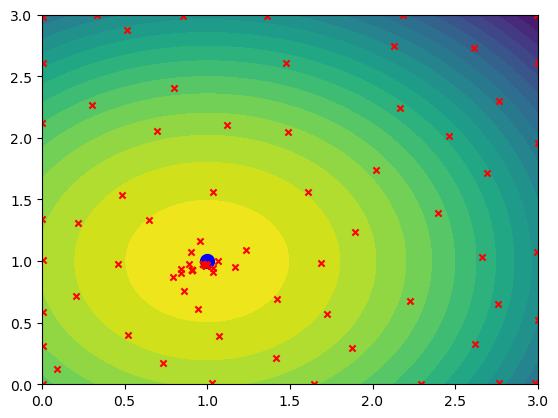

In [26]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')


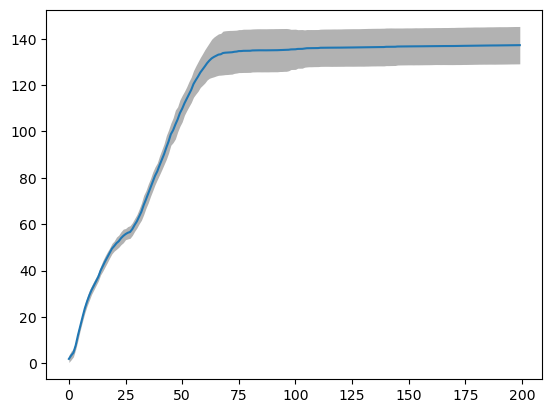

In [27]:
plt.plot(mean_regret_gpucb)
plt.fill_between(range(200), mean_regret_gpucb+np.sqrt(var_regret_gpucb),mean_regret_gpucb-np.sqrt(var_regret_gpucb),color="black" , alpha=.3, linewidth=0)

## Simulation Greedy

In [28]:
# for f_2
S=30
regret_greedy=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_1(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = greedy(data_sim, env,RS=s)
    for i in range(200):
        agent.learn()
    f_values_greedy=agent.T
    f_max=5                   # remember to change this value #5
                                                              #0
    regret_simple_greedy=f_max-np.array(f_values_greedy)
    regret_greedy.append(np.cumsum(regret_simple_greedy))

regret_greedy = np.asarray(regret_greedy) #/np.arange(1,201)
mean_regret_greedy = np.mean(regret_greedy, axis=0)
var_regret_greedy = np.var(regret_greedy, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [2.54136005 0.99004896]  result: 2.573246
(python) Sampled:  [2.54136005 0.99004896]  result: 2.596219
(python) Sampled:  [2.54136005 0.99004896]  result: 2.612667
(python) Sampled:  [2.54136005 0.99004896]  result: 2.613065
(python) Sampled:  [2.54136005 0.99004896]  result: 2.626838
(python) Sampled:  [2.54136005 0.99004896]  result: 2.669672
(python) Sampled:  [2.54136005 0.99004896]  result: 2.630420
(python) Sampled:  [2.54136005 0.99004896]  result: 2.701627
(python) Sampled:  [2.54136005 0.99004896]  result: 2.647842
(python) Sampled:  [2.54136005 0.99004896]  result: 2.592486
(python) Sampled:  [2.54136005 0.99004896]  result: 2.615559
(python) Sampled:  [2.54136005 0.99004896]  result: 2.694541
(python) Sampled:  [2.54136005 0.99004896]  result: 2.658261
(python) Sampled:  [2.54136005 0.99004896]  result: 2.661815
(python) Sampled:  [2.54136005 0.99004896]  result: 2.619794
(python) Sampled:  [2.54136005 0.99004896]  r

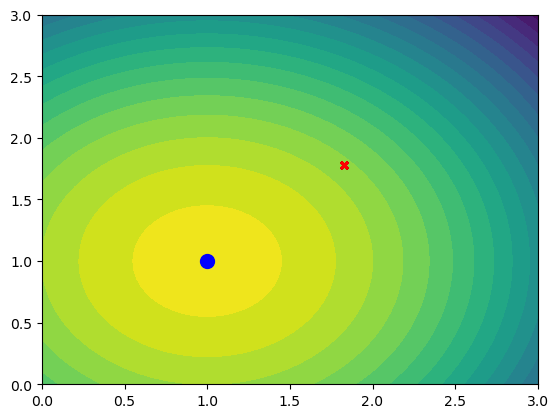

In [29]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')


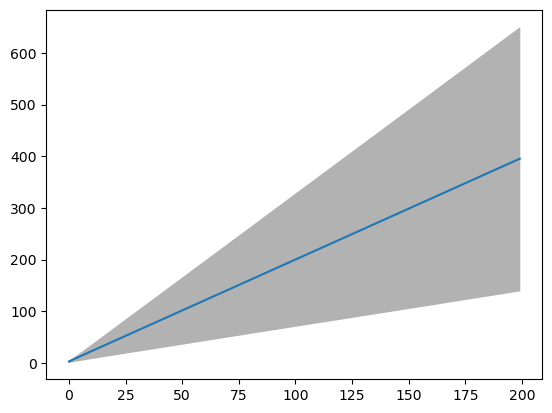

In [30]:
plt.plot(mean_regret_greedy)
plt.fill_between(range(200), mean_regret_greedy+np.sqrt(var_regret_greedy),mean_regret_greedy-np.sqrt(var_regret_greedy),color="black" , alpha=.3, linewidth=0)

## Simulation Pure exploration

In [31]:
# for f_2
S=30
regret_pexp=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_1(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = pure_exploration(data_sim, env,RS=s)
    for i in range(200):
        agent.learn()
    f_values_pexp=agent.T
    f_max=5                   # remember to change this value #5
                                                              #0
    regret_simple_pexp=f_max-np.array(f_values_pexp)
    regret_pexp.append(np.cumsum(regret_simple_pexp))

regret_pexp = np.asarray(regret_pexp) #/np.arange(1,201)
mean_regret_pexp = np.mean(regret_pexp, axis=0)
var_regret_pexp = np.var(regret_pexp, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [2.47442007 2.21547712]  result: 1.283372
(python) Sampled:  [0.00063167 0.01837047]  result: 2.962830
(python) Sampled:  [0.01925358 2.9674885 ]  result: 0.128035
(python) Sampled:  [2.99862565 0.00493479]  result: 0.010127
(python) Sampled:  [1.04971103 1.30649701]  result: 4.882840
(python) Sampled:  [1.53840751 0.00730688]  result: 3.768023
(python) Sampled:  [1.47131269 2.99286012]  result: 0.735874
(python) Sampled:  [2.97357781 2.99625067]  result: -2.882107
(python) Sampled:  [0.00622223 1.59506387]  result: 3.738232
(python) Sampled:  [2.99746714 1.1262501 ]  result: 1.023557
(python) Sampled:  [2.10754883 0.89288831]  result: 3.771968
(python) Sampled:  [0.78984834 2.2985939 ]  result: 3.201074
(python) Sampled:  [0.01319383 0.6985072 ]  result: 3.917482
(python) Sampled:  [7.14567071e-01 7.00969171e-04]  result: 3.896266
(python) Sampled:  [2.989488   2.17165824]  result: -0.317204
(python) Sampled:  [1.6402754  1.90

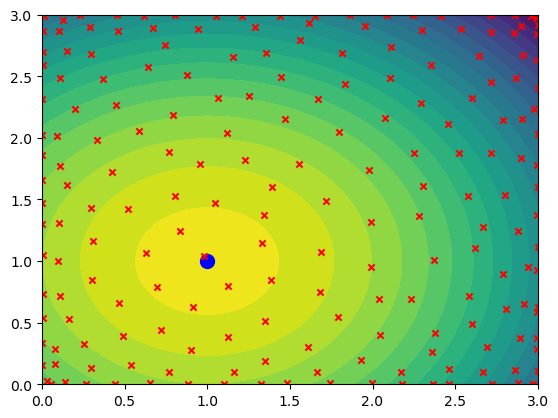

In [32]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')


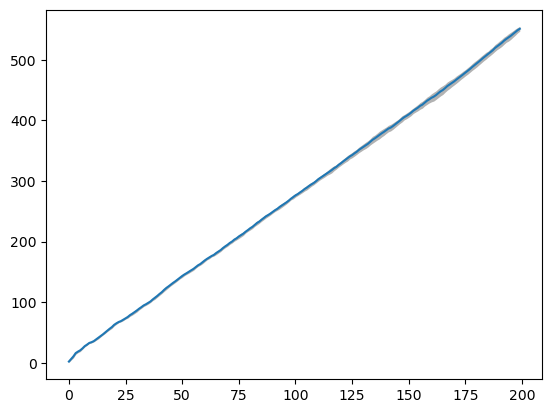

In [33]:
plt.plot(mean_regret_pexp)
plt.fill_between(range(200), mean_regret_pexp+np.sqrt(var_regret_pexp),mean_regret_pexp-np.sqrt(var_regret_pexp),color="black" , alpha=.3, linewidth=0)

## Simulation PI

In [34]:
[0,0.0001,0.0005,0.0008,0.001,0.003,0.005,0.007,0.01,0.05,0.8,0.1,0.3,0.5,0.7,1,1.5,2,2.5,3,3.5,4,4.5,5]

[0,
 0.0001,
 0.0005,
 0.0008,
 0.001,
 0.003,
 0.005,
 0.007,
 0.01,
 0.05,
 0.8,
 0.1,
 0.3,
 0.5,
 0.7,
 1,
 1.5,
 2,
 2.5,
 3,
 3.5,
 4,
 4.5,
 5]

In [35]:
xi_values=[0,0.0001,0.0005,0.0008,0.001,0.003,0.005,0.007,0.01,0.05,0.8,0.1,0.3,0.5,0.7,1,1.5,2,2.5,3]
total_cum_regret=[]
for x in xi_values:
    S=10
    regret_pi=[]
    class DummyEnvironment_sim(object):
        def sample(self, x):
          return black_box_function_1(x)

    for s in range(S):
        print("start of iteration number:",s+1)
        env = DummyEnvironment_sim()
        data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[1000,2])         # remember to change this value    
                                                                                #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                                # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
        agent = PI(data_sim, env,xi=x,RS=s)
        for i in range(150):
            agent.learn()
        f_values_pi=agent.T
        f_max=5                   # remember to change this value #5
                                                                  #0
        regret_simple_pi=f_max-np.array(f_values_pi)
        regret_pi.append(np.cumsum(regret_simple_pi))
    regret_pi = np.asarray(regret_pi) #/np.arange(1,201)
    mean_regret_pi = np.mean(regret_pi, axis=0)
    total_cum_regret.append(sum(mean_regret_pi))


xi_cv_pi=xi_values[np.argmin(np.array(total_cum_regret))]



    

start of iteration number: 1
(1000, 2)
(python) Sampled:  [2.69825213 0.26455835]  result: 1.572062
(python) Sampled:  [2.69825213 0.26455835]  result: 1.562099
(python) Sampled:  [2.71778986 0.19310619]  result: 1.390587
(python) Sampled:  [2.63599445 0.43595245]  result: 2.090283
(python) Sampled:  [2.32648302 1.07063381]  result: 3.184592
(python) Sampled:  [2.33804135 1.05540813]  result: 3.206800
(python) Sampled:  [2.41645995 1.03982386]  result: 2.992383
(python) Sampled:  [1.94696992 0.90624393]  result: 3.993883
(python) Sampled:  [2.00299554 0.87878263]  result: 3.948732
(python) Sampled:  [1.91002359 0.99187237]  result: 4.202828
(python) Sampled:  [1.89687747 1.01024989]  result: 4.192842
(python) Sampled:  [2.99161986 0.51732776]  result: 0.775807
(python) Sampled:  [1.98600789 1.05676691]  result: 3.953358
(python) Sampled:  [2.62807427 1.97869174]  result: 1.396833
(python) Sampled:  [0.68985627 1.03197152]  result: 4.861492
(python) Sampled:  [0.9464321 1.2097883]  resu

In [36]:

print(xi_cv_pi)

1


In [37]:
# for f_2
S=30
regret_pi=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_1(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = PI(data_sim, env,xi=xi_cv_pi,RS=s)
    for i in range(200):
        agent.learn()
    f_values_pi=agent.T
    f_max=5                   # remember to change this value #5
                                                              #0
    regret_simple_pi=f_max-np.array(f_values_pi)
    regret_pi.append(np.cumsum(regret_simple_pi))

regret_pi = np.asarray(regret_pi) #/np.arange(1,201)
mean_regret_pi = np.mean(regret_pi, axis=0)
var_regret_pi = np.var(regret_pi, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [0.32186203 0.10124748]  result: 3.778894
(python) Sampled:  [0.35855776 0.78564843]  result: 4.562370
(python) Sampled:  [0.98145634 0.68049649]  result: 4.878799
(python) Sampled:  [1.01222352 1.44572107]  result: 4.824001
(python) Sampled:  [1.7515696  1.23594476]  result: 4.363020
(python) Sampled:  [1.80176263 2.289637  ]  result: 2.654285
(python) Sampled:  [1.97255359e-04 2.01179273e+00]  result: 2.936281
(python) Sampled:  [2.01652096 0.02491006]  result: 3.055700
(python) Sampled:  [2.98539871 0.90896044]  result: 1.024443
(python) Sampled:  [0.69788127 2.99910311]  result: 0.993953
(python) Sampled:  [2.98698401 2.97274789]  result: -2.789730
(python) Sampled:  [1.10689781 0.00603725]  result: 3.983747
(python) Sampled:  [2.9913899  0.02653039]  result: 0.182025
(python) Sampled:  [0.00684775 1.22695305]  result: 3.957192
(python) Sampled:  [0.97407394 2.10578386]  result: 3.810613
(python) Sampled:  [2.66941485 1.796

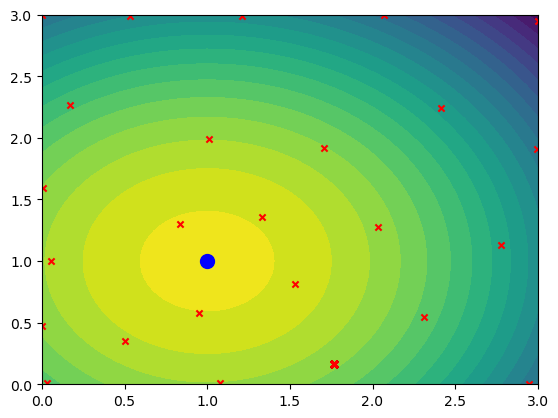

In [38]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

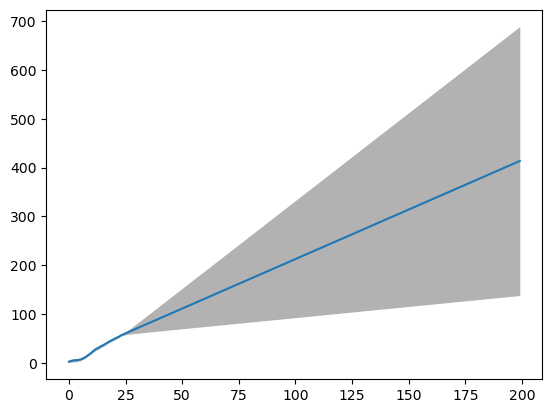

In [39]:
plt.plot(mean_regret_pi)
plt.fill_between(range(200), mean_regret_pi+np.sqrt(var_regret_pi),mean_regret_pi-np.sqrt(var_regret_pi),color="black" , alpha=.3, linewidth=0)

## Simulation EI

In [40]:
xi_values=[0,0.0001,0.0005,0.0008,0.001,0.003,0.005,0.007,0.01,0.05,0.8,0.1,0.3,0.5,0.7,1,1.5,2,2.5,3]
total_cum_regret=[]
for x in xi_values:
    S=10
    regret_ei=[]
    class DummyEnvironment_sim(object):
        def sample(self, x):
          return black_box_function_1(x)

    for s in range(S):
        print("start of iteration number:",s+1)
        env = DummyEnvironment_sim()
        data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[1000,2])         # remember to change this value    
                                                                                #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                                # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
        agent = EI(data_sim, env,xi=x,RS=s)
        for i in range(150):
            agent.learn()
        f_values_ei=agent.T
        f_max=5                   # remember to change this value #5
                                                                  #0
        regret_simple_ei=f_max-np.array(f_values_ei)
        regret_ei.append(np.cumsum(regret_simple_ei))
    regret_ei = np.asarray(regret_ei) #/np.arange(1,201)
    mean_regret_ei = np.mean(regret_ei, axis=0)
    total_cum_regret.append(sum(mean_regret_ei))


xi_cv_ei=xi_values[np.argmin(np.array(total_cum_regret))]



    

start of iteration number: 1
(1000, 2)
(python) Sampled:  [0.62520283 0.01935636]  result: 3.831394
(python) Sampled:  [0.8854558  0.16591296]  result: 4.304770
(python) Sampled:  [1.11027061 0.31932402]  result: 4.461799
(python) Sampled:  [0.90475736 0.57283762]  result: 4.763988
(python) Sampled:  [0.93588167 0.68828816]  result: 4.815810
(python) Sampled:  [0.80807136 0.88738934]  result: 5.013455
(python) Sampled:  [0.5130513  1.06151732]  result: 4.764264
(python) Sampled:  [0.77012458 1.1112605 ]  result: 4.918271
(python) Sampled:  [0.72803445 0.90258152]  result: 4.936008
(python) Sampled:  [0.00853889 1.49520889]  result: 3.748358
(python) Sampled:  [0.01107596 0.0696534 ]  result: 3.167464
(python) Sampled:  [0.00530106 1.22595315]  result: 4.018260
(python) Sampled:  [0.73778396 0.94898397]  result: 4.873746
(python) Sampled:  [1.94100703 1.83925102]  result: 3.394847
(python) Sampled:  [2.20576166 0.01473068]  result: 2.602962
(python) Sampled:  [1.5470364  1.55937244]  re

In [41]:
xi_cv_ei

3

In [42]:
# for f_2
S=30
regret_ei=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_1(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = EI(data_sim, env,xi=xi_cv_ei,RS=s)
    for i in range(200):
        agent.learn()
    f_values_ei=agent.T
    f_max=5                   # remember to change this value #5
                                                              #0
    regret_simple_ei=f_max-np.array(f_values_ei)
    regret_ei.append(np.cumsum(regret_simple_ei))

regret_ei = np.asarray(regret_ei) #/np.arange(1,201)
mean_regret_ei = np.mean(regret_ei, axis=0)
var_regret_ei = np.var(regret_ei, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [1.38988569 2.26565977]  result: 3.154050
(python) Sampled:  [0.22592062 2.44330421]  result: 2.249330
(python) Sampled:  [0.94099583 1.18402446]  result: 4.924610
(python) Sampled:  [1.96687523 0.88036071]  result: 4.103162
(python) Sampled:  [1.08183554 0.03615989]  result: 4.096799
(python) Sampled:  [0.0099495  0.49327524]  result: 3.760435
(python) Sampled:  [2.99239044 2.07834221]  result: -0.201143
(python) Sampled:  [2.98473325 0.021494  ]  result: 0.135489
(python) Sampled:  [0.00560152 1.38422937]  result: 3.900304
(python) Sampled:  [2.10331283 2.99524254]  result: -0.243807
(python) Sampled:  [1.95580154 0.00995347]  result: 3.005918
(python) Sampled:  [0.95239926 2.9949743 ]  result: 1.010034
(python) Sampled:  [2.9945065  1.03572658]  result: 1.048825
(python) Sampled:  [0.0345425  0.00725052]  result: 3.175026
(python) Sampled:  [1.98449106 1.65413246]  result: 3.589337
(python) Sampled:  [2.98972885 2.96290659] 

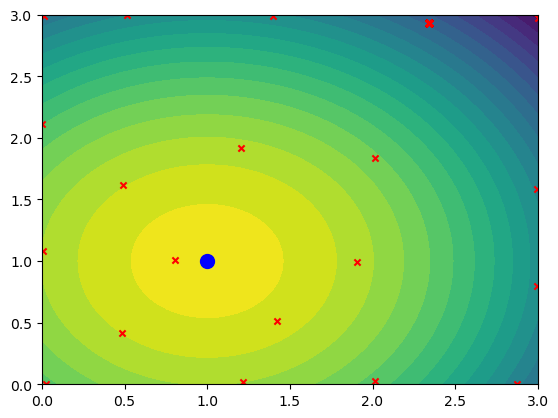

In [43]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

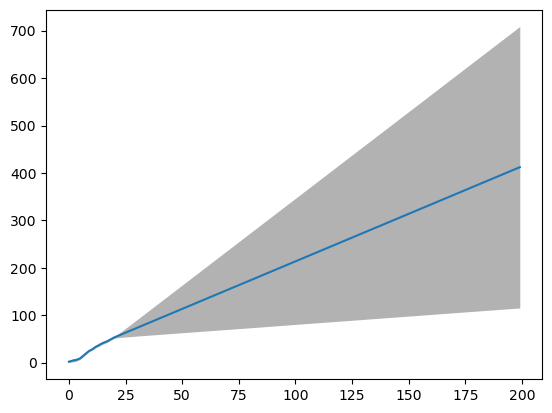

In [44]:
plt.plot(mean_regret_ei)
plt.fill_between(range(200), mean_regret_ei+np.sqrt(var_regret_ei),mean_regret_ei-np.sqrt(var_regret_ei),color="black" , alpha=.3, linewidth=0)

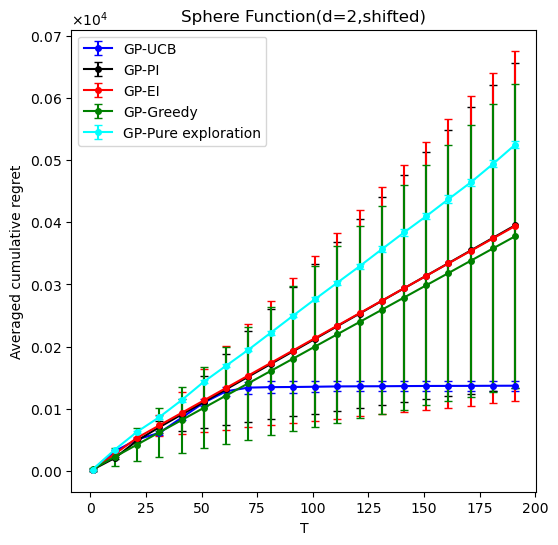

In [45]:
T = np.arange(1, 201)  

# Define the interval for showing error bars (e.g., every 10 points)
interval = 10

plt.figure(figsize=(6,6))
# Plot GP-UCB with error bars
plt.errorbar(T[::interval], mean_regret_gpucb[::interval], yerr=np.sqrt(var_regret_gpucb)[::interval],
             label="GP-UCB", fmt='-o', color='blue', capsize=3, markersize=4)

# Plot GP-PI with error bars
plt.errorbar(T[::interval], mean_regret_pi[::interval], yerr=np.sqrt(var_regret_pi)[::interval],
             label="GP-PI", fmt='-o', color='black', capsize=3, markersize=4)

# Plot GP-EI with error bars
plt.errorbar(T[::interval], mean_regret_ei[::interval], yerr=np.sqrt(var_regret_ei)[::interval],
             label="GP-EI", fmt='-o', color='red', capsize=3, markersize=4)

# Plot GP-Greedy with error bars
plt.errorbar(T[::interval], mean_regret_greedy[::interval], yerr=np.sqrt(var_regret_greedy)[::interval],
             label="GP-Greedy", fmt='-o', color='green', capsize=3, markersize=4)

# Plot GP-Pure exploration with error bars
plt.errorbar(T[::interval], mean_regret_pexp[::interval], yerr=np.sqrt(var_regret_pexp)[::interval],
             label="GP-Pure exploration", fmt='-o', color='cyan', capsize=3, markersize=4)

# Set labels and legend
plt.xlabel("T")
plt.ylabel("Averaged cumulative regret")
plt.legend()
plt.title("Sphere Function(d=2,shifted)")
# Use ScalarFormatter to set scientific notation on the y-axis
plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
plt.ticklabel_format(axis='y', style='sci', scilimits=(4,4))  # Set scientific notation with exponent 4
plt.show()


## Simulation for 2nd function

## Simulation UCB

In [46]:
# for f_2
S=30
regret_gpucb=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_2(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = GPUCB(data_sim, env,d=2,r=3,RS=s)
    for i in range(200):
        agent.learn()
    f_values_gpucb=agent.T
    f_max=0                   # remember to change this value #5
                                                              #0
    regret_simple_gpucb=f_max-np.array(f_values_gpucb)
    regret_gpucb.append(np.cumsum(regret_simple_gpucb))

regret_gpucb = np.asarray(regret_gpucb) #/np.arange(1,201)
mean_regret_gpucb = np.mean(regret_gpucb, axis=0)
var_regret_gpucb = np.var(regret_gpucb, axis=0)

start of iteration number: 1
(10000, 2)
inf
(python) Sampled:  [1.89062759 0.26868667]  result: -232.487212
101.65212366626375
(python) Sampled:  [0.06063042 2.99553321]  result: -127.707546
200.02314071891894
(python) Sampled:  [2.99051614 2.96523235]  result: -399.745698
271.82086326512433
(python) Sampled:  [0.01055142 0.05041715]  result: -375.812076
329.143150662339
(python) Sampled:  [2.99818569 0.06751212]  result: -2426.855956
377.25336924955576
(python) Sampled:  [1.25792129 0.66843281]  result: -16.465145
418.9278809845833
(python) Sampled:  [1.33393641 0.00203625]  result: -123.500161
455.8229361690333
(python) Sampled:  [1.61352967 0.99982915]  result: -14.473182
489.012153496524
(python) Sampled:  [1.5279166  0.64438454]  result: -40.555531
519.2343363559902
(python) Sampled:  [0.65284525 1.62950827]  result: -27.737225
547.0213367847697
(python) Sampled:  [1.27379067 1.40948055]  result: -11.685888
572.7697669498258
(python) Sampled:  [0.29867369 1.15448613]  result: -14.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [1.9557047 1.9267138]  result: -0.020596
931.8607621094397
(python) Sampled:  [1.9557047 1.9267138]  result: 0.024341
941.6693660192805
(python) Sampled:  [1.9557047 1.9267138]  result: -0.020818
951.2579287786708
(python) Sampled:  [1.9557047 1.9267138]  result: -0.093024
960.6369059031123
(python) Sampled:  [1.9557047 1.9267138]  result: -0.019438
969.8160037615386
(python) Sampled:  [1.9557047 1.9267138]  result: -0.025936
978.8042505274924
(python) Sampled:  [1.9557047 1.9267138]  result: 0.025269
987.610058849492
(python) Sampled:  [1.9557047 1.9267138]  result: -0.058642
996.2412813809101
(python) Sampled:  [1.9557047 1.9267138]  result: -0.070189
1004.7052601297988
(python) Sampled:  [1.9557047 1.9267138]  result: 0.008982
1013.0088704410322
(python) Sampled:  [1.9557047 1.9267138]  result: 0.008521
1021.1585603006839
(python) Sampled:  [1.9557047 1.9267138]  result: -0.017474
1029.1603855508163
(python) Sampled:  [1.9557047 1.9267138]  resul

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


867.6854420507261
(python) Sampled:  [2.39124245 2.98167079]  result: -0.271872
879.0875662311352
(python) Sampled:  [0.62192143 0.40372083]  result: -56.503689
890.1857596919293
(python) Sampled:  [1.96545226 1.52827877]  result: -16.202799
900.9971378371887
(python) Sampled:  [2.09412487 2.21650334]  result: 0.003081
911.5373682213558
(python) Sampled:  [2.319993  2.8880881]  result: -2.238464
921.8208317951093
(python) Sampled:  [2.30363507 2.98336931]  result: -8.008368
931.8607621094397
(python) Sampled:  [1.96161449 1.93642322]  result: 0.002102
941.6693660192805
(python) Sampled:  [1.58819022 1.34905663]  result: -0.218390
951.2579287786708
(python) Sampled:  [2.03660322 2.06787054]  result: 0.065571
960.6369059031123
(python) Sampled:  [2.19034382 2.44233438]  result: -0.080767
969.8160037615386
(python) Sampled:  [2.03660322 2.06787054]  result: -0.000559
978.8042505274924
(python) Sampled:  [1.97320485 1.93815468]  result: -0.098604
987.610058849492
(python) Sampled:  [2.0829

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [0.37367128 1.40427077]  result: -2.537329
931.8607621094397
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.588861
941.6693660192805
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.501474
951.2579287786708
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.572836
960.6369059031123
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.635205
969.8160037615386
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.545420
978.8042505274924
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.500665
987.610058849492
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.694076
996.2412813809101
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.577546
1004.7052601297988
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.506950
1013.0088704410322
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.478782
1021.1585603006839
(python) Sampled:  [0.41367485 1.3517249 ]  result: -2.581461
1029.1603855508163
(python) Sampled:  

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


867.6854420507261
(python) Sampled:  [0.30244261 1.49979263]  result: -2.777018
879.0875662311352
(python) Sampled:  [0.56915856 2.99652922]  result: -330.020825
890.1857596919293
(python) Sampled:  [0.30244261 1.49979263]  result: -2.807385
900.9971378371887
(python) Sampled:  [0.30244261 1.49979263]  result: -2.883412
911.5373682213558
(python) Sampled:  [0.30244261 1.49979263]  result: -2.939647
921.8208317951093
(python) Sampled:  [0.30244261 1.49979263]  result: -2.894622
931.8607621094397
(python) Sampled:  [0.30244261 1.49979263]  result: -2.841001
941.6693660192805
(python) Sampled:  [0.30244261 1.49979263]  result: -2.906035
951.2579287786708
(python) Sampled:  [0.30244261 1.49979263]  result: -2.920167
960.6369059031123
(python) Sampled:  [0.30244261 1.49979263]  result: -2.781934
969.8160037615386
(python) Sampled:  [0.30244261 1.49979263]  result: -2.911104
978.8042505274924
(python) Sampled:  [0.30244261 1.49979263]  result: -2.825510
987.610058849492
(python) Sampled:  [0

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


855.9606362455148
(python) Sampled:  [2.14365197 2.32931114]  result: -0.085146
867.6854420507261
(python) Sampled:  [2.14365197 2.32931114]  result: -0.084950
879.0875662311352
(python) Sampled:  [2.14365197 2.32931114]  result: -0.100913
890.1857596919293
(python) Sampled:  [2.14365197 2.32931114]  result: -0.062495
900.9971378371887
(python) Sampled:  [2.14365197 2.32931114]  result: -0.043246
911.5373682213558
(python) Sampled:  [2.14365197 2.32931114]  result: -0.054592
921.8208317951093
(python) Sampled:  [2.14365197 2.32931114]  result: -0.162441
931.8607621094397
(python) Sampled:  [2.14365197 2.32931114]  result: -0.021163
941.6693660192805
(python) Sampled:  [2.14365197 2.32931114]  result: -0.023199
951.2579287786708
(python) Sampled:  [2.14365197 2.32931114]  result: -0.050062
960.6369059031123
(python) Sampled:  [2.14365197 2.32931114]  result: -0.007815
969.8160037615386
(python) Sampled:  [2.14365197 2.32931114]  result: -0.023435
978.8042505274924
(python) Sampled:  [2.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [2.02261722 2.12617416]  result: -0.631037
931.8607621094397
(python) Sampled:  [2.02261722 2.12617416]  result: -0.699338
941.6693660192805
(python) Sampled:  [2.02261722 2.12617416]  result: -0.698800
951.2579287786708
(python) Sampled:  [2.02261722 2.12617416]  result: -0.691132
960.6369059031123
(python) Sampled:  [2.02261722 2.12617416]  result: -0.578650
969.8160037615386
(python) Sampled:  [2.02261722 2.12617416]  result: -0.609942
978.8042505274924
(python) Sampled:  [2.02261722 2.12617416]  result: -0.647403
987.610058849492
(python) Sampled:  [2.02261722 2.12617416]  result: -0.649604
996.2412813809101
(python) Sampled:  [2.02261722 2.12617416]  result: -0.678195
1004.7052601297988
(python) Sampled:  [2.02261722 2.12617416]  result: -0.675284
1013.0088704410322
(python) Sampled:  [2.02261722 2.12617416]  result: -0.641842
1021.1585603006839
(python) Sampled:  [2.02261722 2.12617416]  result: -0.640388
1029.1603855508163
(python) Sampled:  

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


640.5172897618917
(python) Sampled:  [0.01677895 1.98769905]  result: -4.001261
660.5835980291174
(python) Sampled:  [0.01677895 1.98769905]  result: -3.949543
679.6301492214739
(python) Sampled:  [0.01677895 1.98769905]  result: -3.974120
697.7644488955817
(python) Sampled:  [0.01677895 1.98769905]  result: -4.068909
715.0773547422529
(python) Sampled:  [0.01677895 1.98769905]  result: -3.983865
731.6463959390958
(python) Sampled:  [0.01677895 1.98769905]  result: -3.999842
747.5382972107486
(python) Sampled:  [0.01677895 1.98769905]  result: -3.942021
762.8109271212483
(python) Sampled:  [0.01677895 1.98769905]  result: -4.004469
777.5148222500466
(python) Sampled:  [0.01677895 1.98769905]  result: -3.935484
791.6943940704294
(python) Sampled:  [0.01677895 1.98769905]  result: -3.924717
805.3888950957959
(python) Sampled:  [0.01677895 1.98769905]  result: -4.024257
818.6332000475828
(python) Sampled:  [0.01677895 1.98769905]  result: -3.989392
831.4584432303665
(python) Sampled:  [0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [0.96154021 1.03942585]  result: -1.242047
931.8607621094397
(python) Sampled:  [2.1615872  2.65075457]  result: -9.218787
941.6693660192805
(python) Sampled:  [1.62648425 1.36323356]  result: -0.168109
951.2579287786708
(python) Sampled:  [1.54390909 1.25542241]  result: -0.481167
960.6369059031123
(python) Sampled:  [1.63931241 1.40510284]  result: -0.074489
969.8160037615386
(python) Sampled:  [1.63931241 1.40510284]  result: -0.202881
978.8042505274924
(python) Sampled:  [1.63931241 1.40510284]  result: -0.161713
987.610058849492
(python) Sampled:  [1.63931241 1.40510284]  result: -0.136286
996.2412813809101
(python) Sampled:  [1.63931241 1.40510284]  result: -0.194735
1004.7052601297988
(python) Sampled:  [1.63931241 1.40510284]  result: -0.078618
1013.0088704410322
(python) Sampled:  [1.63931241 1.40510284]  result: -0.161395
1021.1585603006839
(python) Sampled:  [1.63931241 1.40510284]  result: -0.131879
1029.1603855508163
(python) Sampled:  

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


805.3888950957959
(python) Sampled:  [0.85036327 1.33630788]  result: -11.244676
818.6332000475828
(python) Sampled:  [2.03812619e-03 2.18504444e+00]  result: -7.632440
831.4584432303665
(python) Sampled:  [0.27678182 1.59751267]  result: -3.474284
843.8925429388612
(python) Sampled:  [2.25550618 2.57427317]  result: -0.066874
855.9606362455148
(python) Sampled:  [2.25550618 2.57427317]  result: -0.027891
867.6854420507261
(python) Sampled:  [2.25550618 2.57427317]  result: 0.003792
879.0875662311352
(python) Sampled:  [2.25550618 2.57427317]  result: -0.114121
890.1857596919293
(python) Sampled:  [2.25550618 2.57427317]  result: -0.068783
900.9971378371887
(python) Sampled:  [2.25550618 2.57427317]  result: -0.130434
911.5373682213558
(python) Sampled:  [2.25550618 2.57427317]  result: 0.002417
921.8208317951093
(python) Sampled:  [2.25550618 2.57427317]  result: -0.110527
931.8607621094397
(python) Sampled:  [2.25550618 2.57427317]  result: -0.129288
941.6693660192805
(python) Sample

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


inf
(python) Sampled:  [1.70030611 2.91450661]  result: -202.879317
101.65212366626375
(python) Sampled:  [0.03117579 0.00343035]  result: -378.441869
200.02314071891894
(python) Sampled:  [2.99518063 0.01495576]  result: -2466.894451
271.82086326512433
(python) Sampled:  [0.00619384 2.99709693]  result: -105.702922
329.143150662339
(python) Sampled:  [2.98362013 2.9988216 ]  result: -375.779332
377.25336924955576
(python) Sampled:  [1.14803845e-03 2.18072583e+00]  result: -7.415771
418.9278809845833
(python) Sampled:  [0.00609553 1.94821743]  result: -4.058803
455.8229361690333
(python) Sampled:  [0.00408971 2.02704239]  result: -4.014282
489.012153496524
(python) Sampled:  [0.04469736 1.98832688]  result: -4.473790
519.2343363559902
(python) Sampled:  [0.00420475 1.99585425]  result: -4.066448
547.0213367847697
(python) Sampled:  [0.00205724 0.79461359]  result: -148.217289
572.7697669498258
(python) Sampled:  [0.14908658 1.20828242]  result: -30.024270
596.7838915948072
(python) Sam

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


931.8607621094397
(python) Sampled:  [1.9577041  1.92589311]  result: -0.026735
941.6693660192805
(python) Sampled:  [1.9577041  1.92589311]  result: -0.013651
951.2579287786708
(python) Sampled:  [1.9577041  1.92589311]  result: 0.044212
960.6369059031123
(python) Sampled:  [1.9577041  1.92589311]  result: -0.045323
969.8160037615386
(python) Sampled:  [1.9577041  1.92589311]  result: -0.043074
978.8042505274924
(python) Sampled:  [1.9577041  1.92589311]  result: 0.032922
987.610058849492
(python) Sampled:  [1.9577041  1.92589311]  result: 0.041921
996.2412813809101
(python) Sampled:  [1.9577041  1.92589311]  result: 0.022048
1004.7052601297988
(python) Sampled:  [1.9577041  1.92589311]  result: 0.052609
1013.0088704410322
(python) Sampled:  [1.9577041  1.92589311]  result: -0.013214
1021.1585603006839
(python) Sampled:  [1.9577041  1.92589311]  result: 0.041970
1029.1603855508163
(python) Sampled:  [1.9577041  1.92589311]  result: 0.022618
1037.020041517973
(python) Sampled:  [1.9577

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


855.9606362455148
(python) Sampled:  [0.00539348 2.04373053]  result: -4.359559
867.6854420507261
(python) Sampled:  [0.00539348 2.04373053]  result: -4.340757
879.0875662311352
(python) Sampled:  [0.00539348 2.04373053]  result: -4.347502
890.1857596919293
(python) Sampled:  [0.00539348 2.04373053]  result: -4.207298
900.9971378371887
(python) Sampled:  [0.00539348 2.04373053]  result: -4.252953
911.5373682213558
(python) Sampled:  [0.00539348 2.04373053]  result: -4.221437
921.8208317951093
(python) Sampled:  [0.00539348 2.04373053]  result: -4.303364
931.8607621094397
(python) Sampled:  [0.00539348 2.04373053]  result: -4.300827
941.6693660192805
(python) Sampled:  [0.00539348 2.04373053]  result: -4.303282
951.2579287786708
(python) Sampled:  [0.00539348 2.04373053]  result: -4.284425
960.6369059031123
(python) Sampled:  [0.00539348 2.04373053]  result: -4.306571
969.8160037615386
(python) Sampled:  [0.00539348 2.04373053]  result: -4.244158
978.8042505274924
(python) Sampled:  [0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [1.80468594 1.65706285]  result: -0.031241
931.8607621094397
(python) Sampled:  [1.80468594 1.65706285]  result: -0.080226
941.6693660192805
(python) Sampled:  [1.80468594 1.65706285]  result: 0.063085
951.2579287786708
(python) Sampled:  [1.80468594 1.65706285]  result: -0.032785
960.6369059031123
(python) Sampled:  [1.80468594 1.65706285]  result: -0.032357
969.8160037615386
(python) Sampled:  [1.80468594 1.65706285]  result: -0.048679
978.8042505274924
(python) Sampled:  [1.80468594 1.65706285]  result: -0.075065
987.610058849492
(python) Sampled:  [1.80468594 1.65706285]  result: -0.073522
996.2412813809101
(python) Sampled:  [1.80468594 1.65706285]  result: -0.101969
1004.7052601297988
(python) Sampled:  [1.80468594 1.65706285]  result: -0.163247
1013.0088704410322
(python) Sampled:  [1.80468594 1.65706285]  result: -0.018201
1021.1585603006839
(python) Sampled:  [1.80468594 1.65706285]  result: -0.108678
1029.1603855508163
(python) Sampled:  [

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


547.0213367847697
(python) Sampled:  [0.56884704 1.43262895]  result: -8.219793
572.7697669498258
(python) Sampled:  [2.05693348 2.1035829 ]  result: -0.111527
596.7838915948072
(python) Sampled:  [1.20915945 1.18843827]  result: -2.742625
619.3026315918867
(python) Sampled:  [0.00279999 1.46272406]  result: -32.323056
640.5172897618917
(python) Sampled:  [1.23369531 1.37550657]  result: -10.838032
660.5835980291174
(python) Sampled:  [1.36898150e+00 2.85506854e-04]  result: -129.442589
679.6301492214739
(python) Sampled:  [0.20488293 1.8900002 ]  result: -9.777766
697.7644488955817
(python) Sampled:  [0.91414123 0.85360078]  result: -3.576437
715.0773547422529
(python) Sampled:  [1.16638394 0.91111742]  result: -2.097971
731.6463959390958
(python) Sampled:  [1.78804364 1.70455354]  result: -0.770832
747.5382972107486
(python) Sampled:  [0.99226257 1.02585581]  result: -1.000721
762.8109271212483
(python) Sampled:  [2.00250159 2.01849177]  result: -0.027448
777.5148222500466
(python) S

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


731.6463959390958
(python) Sampled:  [2.18584396 2.39088027]  result: -0.009503
747.5382972107486
(python) Sampled:  [2.18584396 2.39088027]  result: -0.105696
762.8109271212483
(python) Sampled:  [2.18584396 2.39088027]  result: -0.026765
777.5148222500466
(python) Sampled:  [2.18584396 2.39088027]  result: -0.123394
791.6943940704294
(python) Sampled:  [2.18584396 2.39088027]  result: -0.088037
805.3888950957959
(python) Sampled:  [2.18584396 2.39088027]  result: -0.038615
818.6332000475828
(python) Sampled:  [2.18584396 2.39088027]  result: -0.048833
831.4584432303665
(python) Sampled:  [2.18584396 2.39088027]  result: -0.102634
843.8925429388612
(python) Sampled:  [2.18584396 2.39088027]  result: -0.072546
855.9606362455148
(python) Sampled:  [2.18584396 2.39088027]  result: -0.044397
867.6854420507261
(python) Sampled:  [2.18584396 2.39088027]  result: -0.087257
879.0875662311352
(python) Sampled:  [2.18584396 2.39088027]  result: -0.003590
890.1857596919293
(python) Sampled:  [2.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


805.3888950957959
(python) Sampled:  [0.00244775 2.10286582]  result: -5.125283
818.6332000475828
(python) Sampled:  [0.00244775 2.10286582]  result: -5.139359
831.4584432303665
(python) Sampled:  [0.00244775 2.10286582]  result: -5.224450
843.8925429388612
(python) Sampled:  [0.00244775 2.10286582]  result: -5.122192
855.9606362455148
(python) Sampled:  [0.00244775 2.10286582]  result: -5.190065
867.6854420507261
(python) Sampled:  [0.00244775 2.10286582]  result: -5.200559
879.0875662311352
(python) Sampled:  [0.00244775 2.10286582]  result: -5.136614
890.1857596919293
(python) Sampled:  [0.00244775 2.10286582]  result: -5.128273
900.9971378371887
(python) Sampled:  [0.00244775 2.10286582]  result: -5.091502
911.5373682213558
(python) Sampled:  [0.00244775 2.10286582]  result: -5.166787
921.8208317951093
(python) Sampled:  [0.00244775 2.10286582]  result: -5.110923
931.8607621094397
(python) Sampled:  [0.00244775 2.10286582]  result: -5.172740
941.6693660192805
(python) Sampled:  [0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


879.0875662311352
(python) Sampled:  [0.29123892 1.52557653]  result: -2.943176
890.1857596919293
(python) Sampled:  [0.29123892 1.52557653]  result: -2.969501
900.9971378371887
(python) Sampled:  [0.29123892 1.52557653]  result: -2.961102
911.5373682213558
(python) Sampled:  [0.29123892 1.52557653]  result: -2.979243
921.8208317951093
(python) Sampled:  [0.29123892 1.52557653]  result: -2.995497
931.8607621094397
(python) Sampled:  [0.29123892 1.52557653]  result: -2.955543
941.6693660192805
(python) Sampled:  [0.29123892 1.52557653]  result: -2.928821
951.2579287786708
(python) Sampled:  [0.29123892 1.52557653]  result: -2.984618
960.6369059031123
(python) Sampled:  [0.29123892 1.52557653]  result: -2.904735
969.8160037615386
(python) Sampled:  [0.29123892 1.52557653]  result: -3.072541
978.8042505274924
(python) Sampled:  [0.29123892 1.52557653]  result: -3.070673
987.610058849492
(python) Sampled:  [0.29123892 1.52557653]  result: -2.952013
996.2412813809101
(python) Sampled:  [0.2

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


619.3026315918867
(python) Sampled:  [0.12396143 1.79093807]  result: -3.565983
640.5172897618917
(python) Sampled:  [0.12396143 1.79093807]  result: -3.535315
660.5835980291174
(python) Sampled:  [0.12396143 1.79093807]  result: -3.634920
679.6301492214739
(python) Sampled:  [0.12396143 1.79093807]  result: -3.580139
697.7644488955817
(python) Sampled:  [0.12396143 1.79093807]  result: -3.535606
715.0773547422529
(python) Sampled:  [0.12396143 1.79093807]  result: -3.564826
731.6463959390958
(python) Sampled:  [0.12396143 1.79093807]  result: -3.605728
747.5382972107486
(python) Sampled:  [0.12396143 1.79093807]  result: -3.594770
762.8109271212483
(python) Sampled:  [0.12396143 1.79093807]  result: -3.622590
777.5148222500466
(python) Sampled:  [0.12396143 1.79093807]  result: -3.460662
791.6943940704294
(python) Sampled:  [0.12396143 1.79093807]  result: -3.565234
805.3888950957959
(python) Sampled:  [0.12396143 1.79093807]  result: -3.563999
818.6332000475828
(python) Sampled:  [0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


805.3888950957959
(python) Sampled:  [1.82533527 1.69473655]  result: -0.111436
818.6332000475828
(python) Sampled:  [1.82533527 1.69473655]  result: -0.004432
831.4584432303665
(python) Sampled:  [1.82533527 1.69473655]  result: 0.002253
843.8925429388612
(python) Sampled:  [1.82533527 1.69473655]  result: -0.028123
855.9606362455148
(python) Sampled:  [1.82533527 1.69473655]  result: -0.059169
867.6854420507261
(python) Sampled:  [1.82533527 1.69473655]  result: -0.038467
879.0875662311352
(python) Sampled:  [1.82533527 1.69473655]  result: -0.062451
890.1857596919293
(python) Sampled:  [1.82533527 1.69473655]  result: -0.008326
900.9971378371887
(python) Sampled:  [1.82533527 1.69473655]  result: -0.048913
911.5373682213558
(python) Sampled:  [1.82533527 1.69473655]  result: -0.064700
921.8208317951093
(python) Sampled:  [1.82533527 1.69473655]  result: -0.126161
931.8607621094397
(python) Sampled:  [1.82533527 1.69473655]  result: -0.037042
941.6693660192805
(python) Sampled:  [1.8

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


831.4584432303665
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.636616
843.8925429388612
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.540947
855.9606362455148
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.618958
867.6854420507261
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.567810
879.0875662311352
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.549004
890.1857596919293
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.577831
900.9971378371887
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.569631
911.5373682213558
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.585480
921.8208317951093
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.520846
931.8607621094397
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.589908
941.6693660192805
(python) Sampled:  [3.64505307e-04 2.07242246e+00]  result: -4.466269
951.2579287786708
(python) Sampl

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


762.8109271212483
(python) Sampled:  [0.137645   1.38185394]  result: -16.518275
777.5148222500466
(python) Sampled:  [1.72351884 1.50990825]  result: -0.150609
791.6943940704294
(python) Sampled:  [0.28729662 1.56230122]  result: -3.224613
805.3888950957959
(python) Sampled:  [0.57375087 2.9927342 ]  result: -330.022274
818.6332000475828
(python) Sampled:  [1.74176781 1.54942146]  result: -0.131434
831.4584432303665
(python) Sampled:  [1.72953267 1.53287723]  result: -0.150485
843.8925429388612
(python) Sampled:  [1.72953267 1.53287723]  result: -0.063095
855.9606362455148
(python) Sampled:  [1.72953267 1.53287723]  result: -0.008336
867.6854420507261
(python) Sampled:  [1.72953267 1.53287723]  result: -0.040740
879.0875662311352
(python) Sampled:  [0.92573002 0.00487752]  result: -101.312214
890.1857596919293
(python) Sampled:  [1.72953267 1.53287723]  result: -0.131385
900.9971378371887
(python) Sampled:  [1.72953267 1.53287723]  result: -0.120928
911.5373682213558
(python) Sampled:

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


640.5172897618917
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -4.034778
660.5835980291174
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -3.952066
679.6301492214739
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -3.940660
697.7644488955817
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -3.993641
715.0773547422529
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -4.050533
731.6463959390958
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -4.043769
747.5382972107486
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -3.996016
762.8109271212483
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -4.106886
777.5148222500466
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -4.044195
791.6943940704294
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -3.987562
805.3888950957959
(python) Sampled:  [5.04451822e-06 1.98819004e+00]  result: -3.986070
818.6332000475828
(python) Sampl

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


572.7697669498258
(python) Sampled:  [0.01923511 1.98690157]  result: -4.009833
596.7838915948072
(python) Sampled:  [0.01923511 1.98690157]  result: -4.004823
619.3026315918867
(python) Sampled:  [0.01923511 1.98690157]  result: -3.990517
640.5172897618917
(python) Sampled:  [0.01923511 1.98690157]  result: -4.011354
660.5835980291174
(python) Sampled:  [0.01923511 1.98690157]  result: -3.918892
679.6301492214739
(python) Sampled:  [0.01923511 1.98690157]  result: -4.052636
697.7644488955817
(python) Sampled:  [0.01923511 1.98690157]  result: -3.922050
715.0773547422529
(python) Sampled:  [0.01923511 1.98690157]  result: -3.990631
731.6463959390958
(python) Sampled:  [0.01923511 1.98690157]  result: -3.946933
747.5382972107486
(python) Sampled:  [0.01923511 1.98690157]  result: -3.957286
762.8109271212483
(python) Sampled:  [0.01923511 1.98690157]  result: -3.936882
777.5148222500466
(python) Sampled:  [0.01923511 1.98690157]  result: -4.007597
791.6943940704294
(python) Sampled:  [0.

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


762.8109271212483
(python) Sampled:  [1.88948246 1.8169401 ]  result: -0.058975
777.5148222500466
(python) Sampled:  [1.86731309 1.74182062]  result: 0.025319
791.6943940704294
(python) Sampled:  [0.016568   2.15578022]  result: -7.468316
805.3888950957959
(python) Sampled:  [0.1129176  1.84809786]  result: -3.928563
818.6332000475828
(python) Sampled:  [1.84356331 1.75967676]  result: -0.229845
831.4584432303665
(python) Sampled:  [1.71439074 1.49915434]  result: -0.016562
843.8925429388612
(python) Sampled:  [2.2671779  2.77859629]  result: -3.045676
855.9606362455148
(python) Sampled:  [2.2022176  2.49405974]  result: -0.327548
867.6854420507261
(python) Sampled:  [2.10478669 2.99499155]  result: -60.005432
879.0875662311352
(python) Sampled:  [2.12647778 2.429739  ]  result: -2.707595
890.1857596919293
(python) Sampled:  [2.40780966 2.99976888]  result: -0.210121
900.9971378371887
(python) Sampled:  [2.12747949 2.26738668]  result: 0.002169
911.5373682213558
(python) Sampled:  [1.7

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


547.0213367847697
(python) Sampled:  [0.26491198 1.87866825]  result: -14.457759
572.7697669498258
(python) Sampled:  [0.42636556 1.31741693]  result: -2.458889
596.7838915948072
(python) Sampled:  [0.36886631 1.46110702]  result: -2.993191
619.3026315918867
(python) Sampled:  [0.82616789 0.1473514 ]  result: -79.364669
640.5172897618917
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.350092
660.5835980291174
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.316754
679.6301492214739
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.369012
697.7644488955817
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.391871
715.0773547422529
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.339824
731.6463959390958
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.341696
747.5382972107486
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.430060
762.8109271212483
(python) Sampled:  [0.46950587 1.2838585 ]  result: -2.333767
777.5148222500466
(python) Sampled:  [

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [1.77899043 1.60188971]  result: -0.038816
931.8607621094397
(python) Sampled:  [1.77899043 1.60188971]  result: -0.043441
941.6693660192805
(python) Sampled:  [1.77899043 1.60188971]  result: -0.176834
951.2579287786708
(python) Sampled:  [1.77899043 1.60188971]  result: -0.085573
960.6369059031123
(python) Sampled:  [1.77899043 1.60188971]  result: -0.107130
969.8160037615386
(python) Sampled:  [1.77899043 1.60188971]  result: -0.021941
978.8042505274924
(python) Sampled:  [1.77899043 1.60188971]  result: -0.123463
987.610058849492
(python) Sampled:  [1.77899043 1.60188971]  result: 0.007317
996.2412813809101
(python) Sampled:  [1.77899043 1.60188971]  result: 0.014486
1004.7052601297988
(python) Sampled:  [1.77899043 1.60188971]  result: 0.009062
1013.0088704410322
(python) Sampled:  [1.77899043 1.60188971]  result: 0.042454
1021.1585603006839
(python) Sampled:  [1.77899043 1.60188971]  result: -0.124520
1029.1603855508163
(python) Sampled:  [1.7

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


911.5373682213558
(python) Sampled:  [0.00363352 2.01551643]  result: -4.075869
921.8208317951093
(python) Sampled:  [0.00363352 2.01551643]  result: -4.047621
931.8607621094397
(python) Sampled:  [0.00363352 2.01551643]  result: -4.136032
941.6693660192805
(python) Sampled:  [0.00363352 2.01551643]  result: -3.988624
951.2579287786708
(python) Sampled:  [0.00363352 2.01551643]  result: -4.043852
960.6369059031123
(python) Sampled:  [0.00363352 2.01551643]  result: -4.046029
969.8160037615386
(python) Sampled:  [0.00363352 2.01551643]  result: -4.056766
978.8042505274924
(python) Sampled:  [0.00363352 2.01551643]  result: -4.038275
987.610058849492
(python) Sampled:  [0.00363352 2.01551643]  result: -4.085418
996.2412813809101
(python) Sampled:  [0.00363352 2.01551643]  result: -4.047418
1004.7052601297988
(python) Sampled:  [0.00363352 2.01551643]  result: -4.069835
1013.0088704410322
(python) Sampled:  [0.00363352 2.01551643]  result: -4.066342
1021.1585603006839
(python) Sampled:  [

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


660.5835980291174
(python) Sampled:  [0.02058414 1.38444458]  result: -37.028463
679.6301492214739
(python) Sampled:  [0.53754077 1.12751081]  result: -2.874763
697.7644488955817
(python) Sampled:  [2.18897516 2.35877507]  result: -0.261106
715.0773547422529
(python) Sampled:  [0.7020879  1.06636311]  result: -1.681059
731.6463959390958
(python) Sampled:  [2.24174506 2.51346943]  result: -0.121226
747.5382972107486
(python) Sampled:  [0.00675989 1.90544988]  result: -4.680859
762.8109271212483
(python) Sampled:  [0.67036042 1.30820127]  result: -5.708585
777.5148222500466
(python) Sampled:  [7.15764114e-04 2.15956971e+00]  result: -6.581767
791.6943940704294
(python) Sampled:  [2.37839125 2.88107424]  result: -0.144690
805.3888950957959
(python) Sampled:  [1.93063703 1.91939654]  result: -0.277241
818.6332000475828
(python) Sampled:  [2.05848438 2.1438623 ]  result: -0.072794
831.4584432303665
(python) Sampled:  [2.13403059 2.28040402]  result: -0.007080
843.8925429388612
(python) Samp

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


855.9606362455148
(python) Sampled:  [2.03994235 2.07698959]  result: -0.036682
867.6854420507261
(python) Sampled:  [0.00155606 1.04422859]  result: -94.805133
879.0875662311352
(python) Sampled:  [0.56854176 1.21406756]  result: -2.108762
890.1857596919293
(python) Sampled:  [1.83123392 1.78892715]  result: -0.988964
900.9971378371887
(python) Sampled:  [1.72646761 1.36368364]  result: -2.758690
911.5373682213558
(python) Sampled:  [1.81827101 1.57811488]  result: -0.834542
921.8208317951093
(python) Sampled:  [1.06336169 0.73603535]  result: -8.081576
931.8607621094397
(python) Sampled:  [1.19904833 1.00416372]  result: -0.800889
941.6693660192805
(python) Sampled:  [1.46318879 1.22813804]  result: -0.361952
951.2579287786708
(python) Sampled:  [0.96482146 0.99735537]  result: -1.019663
960.6369059031123
(python) Sampled:  [2.07990557 2.16739868]  result: -0.029936
969.8160037615386
(python) Sampled:  [2.06314135 2.12892765]  result: -0.038335
978.8042505274924
(python) Sampled:  [1

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


921.8208317951093
(python) Sampled:  [1.99429903 2.01023632]  result: 0.037418
931.8607621094397
(python) Sampled:  [1.99429903 2.01023632]  result: -0.043247
941.6693660192805
(python) Sampled:  [1.99429903 2.01023632]  result: -0.026079
951.2579287786708
(python) Sampled:  [1.99429903 2.01023632]  result: 0.032929
960.6369059031123
(python) Sampled:  [1.99429903 2.01023632]  result: -0.091760
969.8160037615386
(python) Sampled:  [1.99429903 2.01023632]  result: -0.092962
978.8042505274924
(python) Sampled:  [1.99429903 2.01023632]  result: 0.017344
987.610058849492
(python) Sampled:  [1.99429903 2.01023632]  result: -0.020738
996.2412813809101
(python) Sampled:  [1.99429903 2.01023632]  result: -0.013043
1004.7052601297988
(python) Sampled:  [1.99429903 2.01023632]  result: -0.027827
1013.0088704410322
(python) Sampled:  [1.99429903 2.01023632]  result: -0.107028
1021.1585603006839
(python) Sampled:  [1.99429903 2.01023632]  result: 0.010960
1029.1603855508163
(python) Sampled:  [1.9

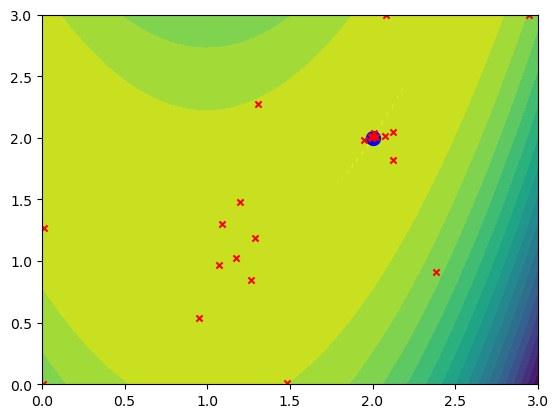

In [47]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')


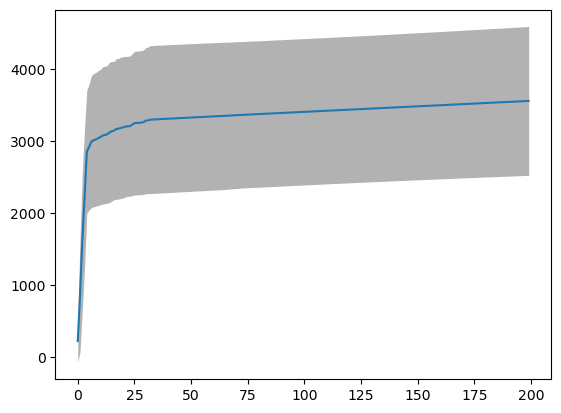

In [48]:
plt.plot(mean_regret_gpucb)
plt.fill_between(range(200), mean_regret_gpucb+np.sqrt(var_regret_gpucb),mean_regret_gpucb-np.sqrt(var_regret_gpucb),color="black" , alpha=.3, linewidth=0)

## Greedy

In [49]:
# for f_2
S=30
regret_greedy=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_2(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = greedy(data_sim, env,RS=s)
    for i in range(200):
        agent.learn()
    f_values_greedy=agent.T
    f_max=0                   # remember to change this value #5
                                                              #0
    regret_simple_greedy=f_max-np.array(f_values_greedy)
    regret_greedy.append(np.cumsum(regret_simple_greedy))

regret_greedy = np.asarray(regret_greedy) #/np.arange(1,201)
mean_regret_greedy = np.mean(regret_greedy, axis=0)
var_regret_greedy = np.var(regret_greedy, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [0.94122883 2.77868499]  result: -316.208702
(python) Sampled:  [2.9914364  0.01908084]  result: -2448.076398
(python) Sampled:  [0.00123759 0.15715515]  result: -342.829833
(python) Sampled:  [2.96161407 2.98526721]  result: -347.912739
(python) Sampled:  [0.0079856  2.97650497]  result: -102.478676
(python) Sampled:  [0.0079856  2.97650497]  result: -102.473205
(python) Sampled:  [0.0079856  2.97650497]  result: -102.379249
(python) Sampled:  [0.0079856  2.97650497]  result: -102.484453
(python) Sampled:  [0.0079856  2.97650497]  result: -102.454319
(python) Sampled:  [0.0079856  2.97650497]  result: -102.510035
(python) Sampled:  [0.0079856  2.97650497]  result: -102.377344
(python) Sampled:  [0.0079856  2.97650497]  result: -102.482151
(python) Sampled:  [0.0079856  2.97650497]  result: -102.395569
(python) Sampled:  [0.0079856  2.97650497]  result: -102.472353
(python) Sampled:  [0.0079856  2.97650497]  result: -102.449930

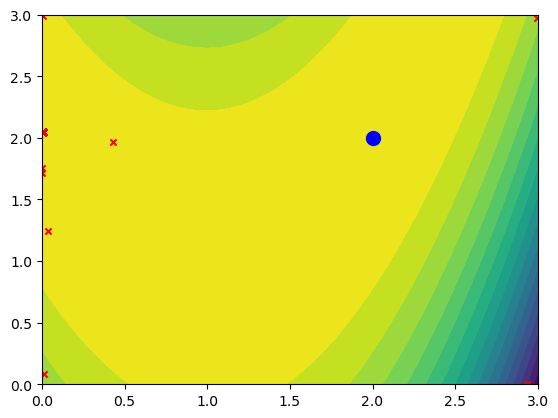

In [50]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')


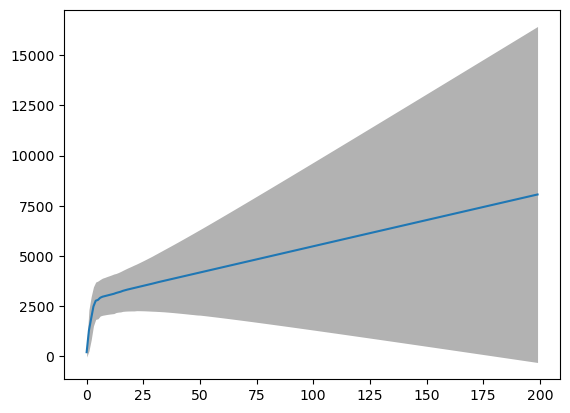

In [51]:
plt.plot(mean_regret_greedy)
plt.fill_between(range(200), mean_regret_greedy+np.sqrt(var_regret_greedy),mean_regret_greedy-np.sqrt(var_regret_greedy),color="black" , alpha=.3, linewidth=0)

## Pure exp

In [52]:
# for f_2
S=30
regret_pexp=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_2(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = pure_exploration(data_sim, env,RS=s)
    for i in range(200):
        agent.learn()
    f_values_pexp=agent.T
    f_max=0                   # remember to change this value #5
                                                              #0
    regret_simple_pexp=f_max-np.array(f_values_pexp)
    regret_pexp.append(np.cumsum(regret_simple_pexp))

regret_pexp = np.asarray(regret_pexp) #/np.arange(1,201)
mean_regret_pexp = np.mean(regret_pexp, axis=0)
var_regret_pexp = np.var(regret_pexp, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [0.76661355 2.85416918]  result: -325.351908
(python) Sampled:  [2.99303117 0.0393249 ]  result: -2434.274248
(python) Sampled:  [0.01826689 0.01072532]  result: -385.362195
(python) Sampled:  [2.99018546 2.95867419]  result: -401.838698
(python) Sampled:  [1.61501306 1.21834157]  result: -2.786147
(python) Sampled:  [0.00382039 1.59736754]  result: -19.600113
(python) Sampled:  [2.99354572 1.60649466]  result: -1135.170201
(python) Sampled:  [1.51888753 0.00216867]  result: -160.827970
(python) Sampled:  [1.91646715 2.99878472]  result: -134.297887
(python) Sampled:  [0.02958436 2.97964926]  result: -111.591471
(python) Sampled:  [0.65188978 0.75408941]  result: -15.234460
(python) Sampled:  [2.05714579 2.17164039]  result: -0.309441
(python) Sampled:  [0.89888023 1.89122637]  result: -78.822869
(python) Sampled:  [2.49547448 0.68573412]  result: -650.817579
(python) Sampled:  [7.53218154e-01 2.33712430e-04]  result: -113.9561

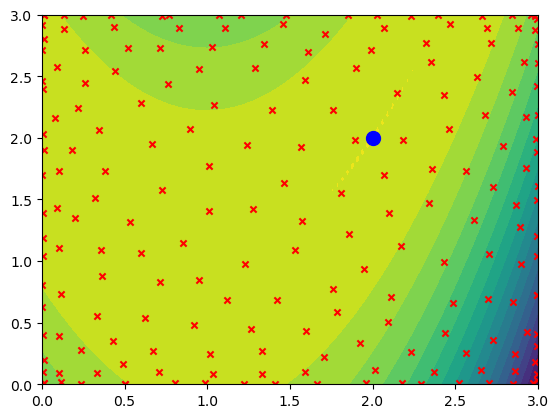

In [53]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')


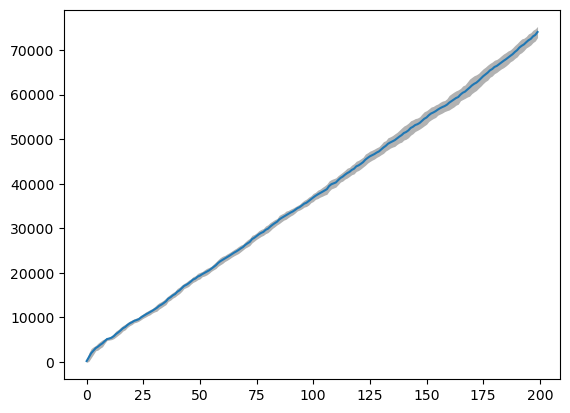

In [54]:
plt.plot(mean_regret_pexp)
plt.fill_between(range(200), mean_regret_pexp+np.sqrt(var_regret_pexp),mean_regret_pexp-np.sqrt(var_regret_pexp),color="black" , alpha=.3, linewidth=0)

## Simulation PI

In [55]:
xi_values=[0,0.0001,0.0005,0.0008,0.001,0.003,0.005,0.007,0.01,0.05,0.8,0.1,0.3,0.5,0.7,1,1.5,2,2.5,3]
total_cum_regret=[]
for x in xi_values:
    S=10
    regret_pi=[]
    class DummyEnvironment_sim(object):
        def sample(self, x):
          return black_box_function_2(x)

    for s in range(S):
        print("start of iteration number:",s+1)
        env = DummyEnvironment_sim()
        data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[1000,2])         # remember to change this value    
                                                                                #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                                # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
        agent = PI(data_sim, env,xi=x,RS=s)
        for i in range(150):
            agent.learn()
        f_values_pi=agent.T
        f_max=0                   # remember to change this value #5
                                                                  #0
        regret_simple_pi=f_max-np.array(f_values_pi)
        regret_pi.append(np.cumsum(regret_simple_pi))
    regret_pi = np.asarray(regret_pi) #/np.arange(1,201)
    mean_regret_pi = np.mean(regret_pi, axis=0)
    total_cum_regret.append(sum(mean_regret_pi))


xi_cv_pi=xi_values[np.argmin(np.array(total_cum_regret))]



    

start of iteration number: 1
(1000, 2)
(python) Sampled:  [0.67168471 0.5403043 ]  result: -34.014067
(python) Sampled:  [2.76290105 0.56996758]  result: -1252.188671
(python) Sampled:  [0.30091927 0.21878735]  result: -164.126869
(python) Sampled:  [0.800084   2.56358461]  result: -233.544371
(python) Sampled:  [0.72011537 0.76970595]  result: -11.135712
(python) Sampled:  [0.67828954 1.04830907]  result: -2.198496
(python) Sampled:  [0.58065022 1.14430642]  result: -2.057058
(python) Sampled:  [0.58065022 1.14430642]  result: -2.099049
(python) Sampled:  [0.67168471 0.5403043 ]  result: -33.905166
(python) Sampled:  [0.67168471 0.5403043 ]  result: -33.953837
(python) Sampled:  [0.67168471 0.5403043 ]  result: -33.970052
(python) Sampled:  [0.67168471 0.5403043 ]  result: -33.933616
(python) Sampled:  [0.67168471 0.5403043 ]  result: -34.031654
(python) Sampled:  [0.67168471 0.5403043 ]  result: -33.946124
(python) Sampled:  [0.67168471 0.5403043 ]  result: -33.928292
(python) Sample

In [56]:
xi_cv_pi

0.1

In [57]:
# for f_2
S=30
regret_pi=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_2(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = PI(data_sim, env,xi=xi_cv_pi,RS=s)
    for i in range(200):
        agent.learn()
    f_values_pi=agent.T
    f_max=0                   # remember to change this value #5
                                                              #0
    regret_simple_pi=f_max-np.array(f_values_pi)
    regret_pi.append(np.cumsum(regret_simple_pi))

regret_pi = np.asarray(regret_pi) #/np.arange(1,201)
mean_regret_pi = np.mean(regret_pi, axis=0)
var_regret_pi = np.var(regret_pi, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [1.74258337 1.60411272]  result: -0.338002
(python) Sampled:  [0.01218248 0.07160619]  result: -366.508208
(python) Sampled:  [1.64976261 2.61766663]  result: -142.970184
(python) Sampled:  [2.48839797 0.11803494]  result: -959.632444
(python) Sampled:  [0.86081808 1.52828105]  result: -27.293907
(python) Sampled:  [1.68414668 1.89062905]  result: -17.961837
(python) Sampled:  [1.47920636 1.52885194]  result: -9.228760
(python) Sampled:  [2.21596438 1.67410687]  result: -64.742301
(python) Sampled:  [0.25179911 2.22875013]  result: -47.738614
(python) Sampled:  [0.45456439 1.67085384]  result: -16.371569
(python) Sampled:  [1.64581365 1.69757296]  result: -8.047091
(python) Sampled:  [1.20625491 0.88813015]  result: -3.066059
(python) Sampled:  [0.06028441 1.70619181]  result: -6.969947
(python) Sampled:  [0.80979234 1.07769849]  result: -1.651566
(python) Sampled:  [1.33185486 1.01180593]  result: -1.422332
(python) Sampled:  

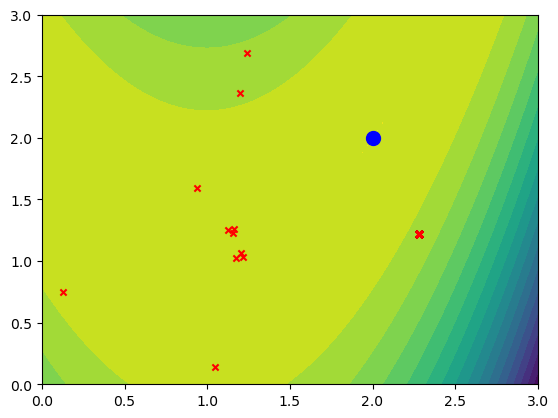

In [58]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

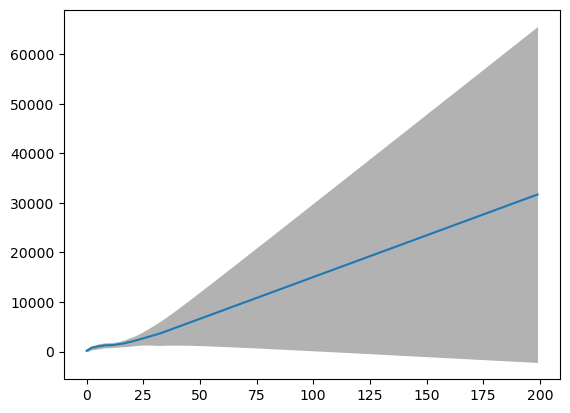

In [59]:
plt.plot(mean_regret_pi)
plt.fill_between(range(200), mean_regret_pi+np.sqrt(var_regret_pi),mean_regret_pi-np.sqrt(var_regret_pi),color="black" , alpha=.3, linewidth=0)

## Simulation EI

In [60]:
xi_values=[0,0.0001,0.0005,0.0008,0.001,0.003,0.005,0.007,0.01,0.05,0.8,0.1,0.3,0.5,0.7,1,1.5,2,2.5,3]
total_cum_regret=[]
for x in xi_values:
    S=10
    regret_ei=[]
    class DummyEnvironment_sim(object):
        def sample(self, x):
          return black_box_function_2(x)

    for s in range(S):
        print("start of iteration number:",s+1)
        env = DummyEnvironment_sim()
        data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[1000,2])         # remember to change this value    
                                                                                #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                                # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
        agent = EI(data_sim, env,xi=x,RS=s)
        for i in range(150):
            agent.learn()
        f_values_ei=agent.T
        f_max=0                  # remember to change this value #5
                                                                  #0
        regret_simple_ei=f_max-np.array(f_values_ei)
        regret_ei.append(np.cumsum(regret_simple_ei))
    regret_ei = np.asarray(regret_ei) #/np.arange(1,201)
    mean_regret_ei = np.mean(regret_ei, axis=0)
    total_cum_regret.append(sum(mean_regret_ei))


xi_cv_ei=xi_values[np.argmin(np.array(total_cum_regret))]



    

start of iteration number: 1
(1000, 2)
(python) Sampled:  [1.10169198 2.24947505]  result: -154.298097
(python) Sampled:  [2.68581491e+00 1.25232836e-03]  result: -1475.627389
(python) Sampled:  [2.89845957 2.98516929]  result: -262.929394
(python) Sampled:  [0.02478835 2.92051261]  result: -97.864425
(python) Sampled:  [0.00634337 0.70402678]  result: -168.652505
(python) Sampled:  [0.02478835 2.92051261]  result: -97.913905
(python) Sampled:  [0.12029369 2.97488959]  result: -147.716659
(python) Sampled:  [0.02832356 2.0251099 ]  result: -4.437814
(python) Sampled:  [0.01162925 2.28155384]  result: -13.212239
(python) Sampled:  [0.02832356 2.0251099 ]  result: -4.512490
(python) Sampled:  [1.10169198 2.24947505]  result: -154.401303
(python) Sampled:  [1.10169198 2.24947505]  result: -154.312824
(python) Sampled:  [1.10169198 2.24947505]  result: -154.294714
(python) Sampled:  [1.10169198 2.24947505]  result: -154.400896
(python) Sampled:  [1.10169198 2.24947505]  result: -154.411857

In [61]:
xi_cv_ei

0.003

In [62]:
# for f_2
S=30
regret_ei=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_2(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0],high=[3,3],size=[10000,2])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = EI(data_sim, env,xi=0.05,RS=s)
    for i in range(200):
        agent.learn()
    f_values_ei=agent.T
    f_max=0                   # remember to change this value #5
                                                              #0
    regret_simple_ei=f_max-np.array(f_values_ei)
    regret_ei.append(np.cumsum(regret_simple_ei))

regret_ei = np.asarray(regret_ei) #/np.arange(1,201)
mean_regret_ei = np.mean(regret_ei, axis=0)
var_regret_ei = np.var(regret_ei, axis=0)

start of iteration number: 1
(10000, 2)
(python) Sampled:  [1.19850676 1.84615188]  result: -65.758139
(python) Sampled:  [2.99197742 0.03541462]  result: -2434.005519
(python) Sampled:  [0.52303209 2.52920238]  result: -171.694197
(python) Sampled:  [0.00881621 0.57354782]  result: -202.532459
(python) Sampled:  [2.32803968 2.99418842]  result: -5.420568
(python) Sampled:  [2.51596418 2.99650081]  result: -9.428777
(python) Sampled:  [2.20498012 2.99059681]  result: -29.083786
(python) Sampled:  [0.00751675 1.94124078]  result: -4.154456
(python) Sampled:  [2.38701014 2.96851292]  result: -0.362722
(python) Sampled:  [2.36461675 2.74861041]  result: -1.326363
(python) Sampled:  [0.51909597 1.6852974 ]  result: -22.813205
(python) Sampled:  [2.3989994  2.89312841]  result: -0.576931
(python) Sampled:  [2.07706501 2.45915333]  result: -8.860950
(python) Sampled:  [2.28306647 2.74037065]  result: -0.928874
(python) Sampled:  [0.0050029  1.64730735]  result: -15.717976
(python) Sampled:  

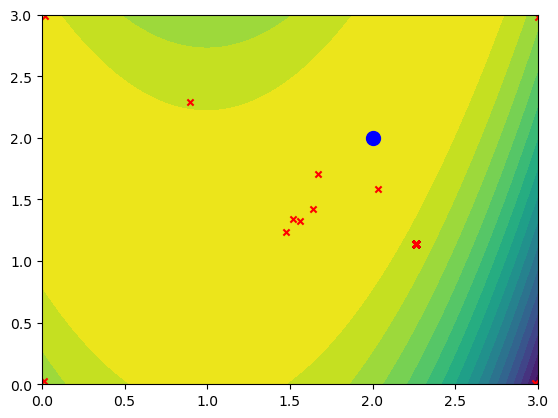

In [63]:
u1=np.linspace(0,3,100)
v1=np.linspace(0,3,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

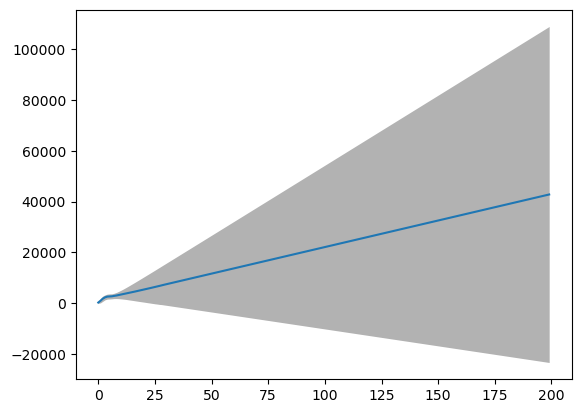

In [64]:
plt.plot(mean_regret_ei)
plt.fill_between(range(200), mean_regret_ei+np.sqrt(var_regret_ei),mean_regret_ei-np.sqrt(var_regret_ei),color="black" , alpha=.3, linewidth=0)

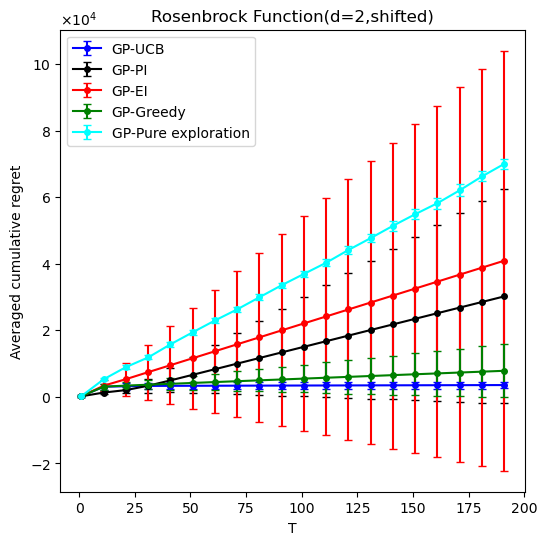

In [65]:






T = np.arange(1, 201)  

# Define the interval for showing error bars (e.g., every 10 points)
interval = 10

plt.figure(figsize=(6,6))

# Plot GP-UCB with error bars
plt.errorbar(T[::interval], mean_regret_gpucb[::interval], yerr=np.sqrt(var_regret_gpucb)[::interval],
             label="GP-UCB", fmt='-o', color='blue', capsize=3, markersize=4)

# Plot GP-PI with error bars
plt.errorbar(T[::interval], mean_regret_pi[::interval], yerr=np.sqrt(var_regret_pi)[::interval],
             label="GP-PI", fmt='-o', color='black', capsize=3, markersize=4)

# Plot GP-EI with error bars
plt.errorbar(T[::interval], mean_regret_ei[::interval], yerr=np.sqrt(var_regret_ei)[::interval],
             label="GP-EI", fmt='-o', color='red', capsize=3, markersize=4)

# Plot GP-Greedy with error bars
plt.errorbar(T[::interval], mean_regret_greedy[::interval], yerr=np.sqrt(var_regret_greedy)[::interval],
             label="GP-Greedy", fmt='-o', color='green', capsize=3, markersize=4)

# Plot GP-Pure exploration with error bars
plt.errorbar(T[::interval], mean_regret_pexp[::interval], yerr=np.sqrt(var_regret_pexp)[::interval],
             label="GP-Pure exploration", fmt='-o', color='cyan', capsize=3, markersize=4)

# Set labels and legend
plt.xlabel("T")
plt.ylabel("Averaged cumulative regret")
plt.legend()
plt.title("Rosenbrock Function(d=2,shifted)")
# Use ScalarFormatter to set scientific notation on the y-axis
plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
plt.ticklabel_format(axis='y', style='sci', scilimits=(4,4))  # Set scientific notation with exponent 4

plt.show()


## Simulation for 3rd function d=3

## GPUCB

In [66]:
# for f_2
S=30
regret_gpucb=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_3(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[10000,3])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = GPUCB(data_sim, env,d=3,r=1,RS=s)
    for i in range(200):
        agent.learn()
    f_values_gpucb=agent.T
    f_max=3.86278                   # remember to change this value #5
                                                              #0
    regret_simple_gpucb=f_max-np.array(f_values_gpucb)
    regret_gpucb.append(np.cumsum(regret_simple_gpucb))

regret_gpucb = np.asarray(regret_gpucb) #/np.arange(1,201)
mean_regret_gpucb = np.mean(regret_gpucb, axis=0)
var_regret_gpucb = np.var(regret_gpucb, axis=0)

start of iteration number: 1
(10000, 3)
inf
(python) Sampled:  [0.67262694 0.58582164 0.34396074]  result: 0.152631
74.59317191919003
(python) Sampled:  [0.05839688 0.03626125 0.99323016]  result: 0.189865
165.276940749154
(python) Sampled:  [0.05235669 0.97471226 0.98675971]  result: 0.459400
232.5779113513497
(python) Sampled:  [0.01671675 0.07259551 0.000491  ]  result: 0.086695
286.70970246988287
(python) Sampled:  [0.98259269 0.06172581 0.98077174]  result: 0.199362
332.34517988184234
(python) Sampled:  [0.05572313 0.99206127 0.01645022]  result: -0.033997
371.9976808481174
(python) Sampled:  [0.97983983 0.98439033 0.96783584]  result: 0.382255
407.1831502869088
(python) Sampled:  [0.97234305 0.03237351 0.00259646]  result: 0.059616
438.8914570813766
(python) Sampled:  [0.98726302 0.91776811 0.01536441]  result: -0.029093
467.80738427551455
(python) Sampled:  [0.00278023 0.61017549 0.58891325]  result: 1.927800
494.4258991943651
(python) Sampled:  [0.00100821 0.0315249  0.53657682

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


814.3081284740296
(python) Sampled:  [0.78684025 0.02038176 0.54481527]  result: 0.082369
825.0426711629706
(python) Sampled:  [0.82156829 0.99988095 0.07929809]  result: -0.018856
835.5019449766588
(python) Sampled:  [0.34453565 0.97354397 0.98376647]  result: 0.631184
845.7009067456897
(python) Sampled:  [0.99592884 0.32133322 0.2616436 ]  result: 0.234065
855.6532903636262
(python) Sampled:  [0.26075596 0.99922485 0.47074314]  result: 1.873722
865.3717386066755
(python) Sampled:  [0.00774732 0.03645991 0.82634278]  result: 0.391487
874.8679174934224
(python) Sampled:  [5.51826985e-01 2.50704278e-04 9.92008214e-01]  result: 0.107926
884.1526159054731
(python) Sampled:  [0.17001097 0.99845725 0.80570604]  result: 0.934854
893.235832705507
(python) Sampled:  [0.99253693 0.3663962  0.95784023]  result: 1.838741
902.1268532013078
(python) Sampled:  [0.19089773 0.66617282 0.92859944]  result: 2.973094
910.8343164917053
(python) Sampled:  [0.99894353 0.71307738 0.28666906]  result: -0.0178

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


755.8757730592297
(python) Sampled:  [0.74016377 0.9974846  0.29470628]  result: 0.101665
768.2660446141454
(python) Sampled:  [0.9867873  0.43462053 0.01556573]  result: 0.076163
780.2815906916846
(python) Sampled:  [0.99285858 0.02556889 0.73573611]  result: 0.293145
791.9463539180078
(python) Sampled:  [0.28887268 0.01036194 0.79314698]  result: 0.318202
803.2819845329901
(python) Sampled:  [0.36539496 0.0174472  0.05136978]  result: 0.281927
814.3081284740296
(python) Sampled:  [0.05930906 0.99939243 0.29891731]  result: 0.336186
825.0426711629706
(python) Sampled:  [0.02986406 0.77363762 0.97819713]  result: 1.731236
835.5019449766588
(python) Sampled:  [0.25056244 0.72613376 0.07858589]  result: 0.069716
845.7009067456897
(python) Sampled:  [0.03232962 0.57204533 0.78671661]  result: 3.488885
855.6532903636262
(python) Sampled:  [0.99507981 0.71913536 0.01214433]  result: -0.043961
865.3717386066755
(python) Sampled:  [0.13342802 0.57016717 0.90006669]  result: 3.601382
874.86791

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


791.9463539180078
(python) Sampled:  [0.97919731 0.05565433 0.64583421]  result: 0.218534
803.2819845329901
(python) Sampled:  [0.01264452 0.01803702 0.64026345]  result: 0.086844
814.3081284740296
(python) Sampled:  [0.01676918 0.68745305 0.81875457]  result: 3.151855
825.0426711629706
(python) Sampled:  [0.23580354 0.56577689 0.88858019]  result: 3.730189
835.5019449766588
(python) Sampled:  [0.19747544 0.59748482 0.8791945 ]  result: 3.815839
845.7009067456897
(python) Sampled:  [0.19419104 0.65504736 0.89515012]  result: 3.421383
855.6532903636262
(python) Sampled:  [0.91959994 0.73581171 0.02260475]  result: 0.020600
865.3717386066755
(python) Sampled:  [0.77459073 0.72113789 0.89987505]  result: 2.681392
874.8679174934224
(python) Sampled:  [0.00128435 0.3582879  0.82184538]  result: 2.677275
884.1526159054731
(python) Sampled:  [0.12803222 0.99982805 0.747825  ]  result: 1.107991
893.235832705507
(python) Sampled:  [0.3015942  0.00666966 0.9013152 ]  result: 0.219731
902.1268532

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


74.59317191919003
(python) Sampled:  [0.93690327 0.03267203 0.00204489]  result: 0.109570
165.276940749154
(python) Sampled:  [0.02540603 0.92315457 0.03051041]  result: 0.062372
232.5779113513497
(python) Sampled:  [0.04843169 0.00167147 0.96574851]  result: 0.111263
286.70970246988287
(python) Sampled:  [0.98618933 0.97166355 0.94804242]  result: 0.560269
332.34517988184234
(python) Sampled:  [0.92501199 0.01095763 0.97290473]  result: 0.151175
371.9976808481174
(python) Sampled:  [0.02865231 0.99948114 0.93653765]  result: 0.589082
407.1831502869088
(python) Sampled:  [0.99106808 0.98374748 0.01745547]  result: -0.029560
438.8914570813766
(python) Sampled:  [0.02979722 0.0126829  0.04630301]  result: 0.133421
467.80738427551455
(python) Sampled:  [0.56648242 0.44246773 0.42232161]  result: 0.341410
494.4258991943651
(python) Sampled:  [0.36680249 0.5117187  0.9978451 ]  result: 2.034048
519.1173056408606
(python) Sampled:  [0.48647635 0.99053571 0.94149503]  result: 0.548475
542.166

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


671.9325709641818
(python) Sampled:  [0.00499601 0.79746053 0.76802109]  result: 2.271963
687.2556113976527
(python) Sampled:  [0.59619585 0.99460257 0.99383592]  result: 0.314419
701.9871410724228
(python) Sampled:  [0.00295496 0.48217543 0.74136055]  result: 2.942300
716.1751127183902
(python) Sampled:  [5.46908552e-01 5.99037764e-05 2.01170175e-02]  result: 0.207561
729.8616987164228
(python) Sampled:  [0.36173819 0.99803736 0.06265379]  result: -0.090362
743.0841985139475
(python) Sampled:  [0.56499205 0.01945884 0.96715999]  result: 0.086042
755.8757730592297
(python) Sampled:  [9.71893302e-01 4.60244249e-01 2.80994548e-04]  result: -0.118553
768.2660446141454
(python) Sampled:  [0.42301648 0.56978015 0.66488984]  result: 2.029822
780.2815906916846
(python) Sampled:  [0.98106049 0.56869057 0.97527814]  result: 2.331888
791.9463539180078
(python) Sampled:  [0.00406914 0.60057724 0.67871372]  result: 2.371134
803.2819845329901
(python) Sampled:  [0.01370271 0.01174304 0.73537487]  r

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


655.9631544390861
(python) Sampled:  [0.01180019 0.78108026 0.76509096]  result: 2.358192
671.9325709641818
(python) Sampled:  [0.00659744 0.4544271  0.96955103]  result: 2.347934
687.2556113976527
(python) Sampled:  [0.01723478 0.99877534 0.85576869]  result: 0.752243
701.9871410724228
(python) Sampled:  [0.43181638 0.01165072 0.00233318]  result: 0.148939
716.1751127183902
(python) Sampled:  [0.63892697 0.63968935 0.994638  ]  result: 1.875071
729.8616987164228
(python) Sampled:  [0.14120452 0.99784337 0.41542792]  result: 1.327663
743.0841985139475
(python) Sampled:  [0.95686443 0.99613065 0.50995611]  result: 0.315568
755.8757730592297
(python) Sampled:  [0.00789397 0.56696941 0.81265637]  result: 3.657959
768.2660446141454
(python) Sampled:  [0.33554841 0.00413876 0.68764802]  result: 0.241090
780.2815906916846
(python) Sampled:  [0.81122905 0.48234845 0.00152386]  result: 0.052519
791.9463539180078
(python) Sampled:  [0.26471603 0.55430419 0.8734745 ]  result: 3.782417
803.281984

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


584.1902556570759
(python) Sampled:  [0.53655763 0.44783148 0.99655814]  result: 1.866250
603.4914084947029
(python) Sampled:  [0.98777421 0.3918881  0.99641354]  result: 1.422221
621.8222045836352
(python) Sampled:  [0.21242089 0.41067116 0.00925553]  result: 0.023191
639.2841556867899
(python) Sampled:  [0.26190116 0.62438731 0.99129002]  result: 2.194187
655.9631544390861
(python) Sampled:  [0.23540231 0.46066657 0.98533043]  result: 2.202437
671.9325709641818
(python) Sampled:  [0.20757409 0.98907224 0.47549608]  result: 2.117463
687.2556113976527
(python) Sampled:  [0.21479302 0.80419155 0.70333823]  result: 2.341148
701.9871410724228
(python) Sampled:  [0.07576042 0.85191745 0.56252124]  result: 3.037092
716.1751127183902
(python) Sampled:  [0.51917597 0.01302677 0.01143118]  result: 0.257555
729.8616987164228
(python) Sampled:  [0.00202564 0.79867183 0.42508919]  result: 1.665886
743.0841985139475
(python) Sampled:  [0.99539427 0.08687407 0.43945627]  result: 0.146566
755.875773

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


780.2815906916846
(python) Sampled:  [0.50900166 0.15941411 0.11907095]  result: 0.475819
791.9463539180078
(python) Sampled:  [0.97715044 0.0042065  0.35604228]  result: 0.262227
803.2819845329901
(python) Sampled:  [0.68475523 0.9905475  0.98698595]  result: 0.370072
814.3081284740296
(python) Sampled:  [0.99801375 0.55091323 0.98730936]  result: 2.086711
825.0426711629706
(python) Sampled:  [0.72523665 0.06060608 0.23269256]  result: 0.602267
835.5019449766588
(python) Sampled:  [0.98984763 0.24897385 0.04776914]  result: 0.155047
845.7009067456897
(python) Sampled:  [0.26557089 0.03321357 0.23487993]  result: 0.877853
855.6532903636262
(python) Sampled:  [0.44657969 0.82515462 0.79733068]  result: 1.920207
865.3717386066755
(python) Sampled:  [0.79302865 0.20451701 0.94908399]  result: 0.844773
874.8679174934224
(python) Sampled:  [0.01844148 0.21722316 0.16507114]  result: 0.421807
884.1526159054731
(python) Sampled:  [0.95888604 0.72392508 0.99293079]  result: 1.651579
893.235832

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


716.1751127183902
(python) Sampled:  [0.00500697 0.40149294 0.99317709]  result: 1.755241
729.8616987164228
(python) Sampled:  [0.00396369 0.00569128 0.46449862]  result: 0.224240
743.0841985139475
(python) Sampled:  [0.23480811 0.55070193 0.96646577]  result: 2.773450
755.8757730592297
(python) Sampled:  [0.41318462 0.61801637 0.99992104]  result: 2.039496
768.2660446141454
(python) Sampled:  [0.22904106 0.32089176 0.67699777]  result: 1.333100
780.2815906916846
(python) Sampled:  [0.99504396 0.97203852 0.59638918]  result: 0.325846
791.9463539180078
(python) Sampled:  [0.00189961 0.04719377 0.00829787]  result: 0.054840
803.2819845329901
(python) Sampled:  [0.18963925 0.59631414 0.99666539]  result: 2.055966
814.3081284740296
(python) Sampled:  [0.02182526 0.69662805 0.79383069]  result: 2.986932
825.0426711629706
(python) Sampled:  [0.98837674 0.57311692 0.80603528]  result: 3.247480
835.5019449766588
(python) Sampled:  [0.53917799 0.56320079 0.85669486]  result: 3.848179
845.700906

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


814.3081284740296
(python) Sampled:  [0.03603369 0.50171632 0.82998616]  result: 3.694124
825.0426711629706
(python) Sampled:  [0.99393873 0.99399391 0.41156316]  result: 0.195229
835.5019449766588
(python) Sampled:  [0.27622952 0.99744779 0.7790119 ]  result: 0.844462
845.7009067456897
(python) Sampled:  [0.99515647 0.00436201 0.28640522]  result: 0.281255
855.6532903636262
(python) Sampled:  [0.04802136 0.00119885 0.43036759]  result: 0.241913
865.3717386066755
(python) Sampled:  [0.01336562 0.9988281  0.2047485 ]  result: 0.031664
874.8679174934224
(python) Sampled:  [0.00367075 0.50587217 0.00603022]  result: -0.018013
884.1526159054731
(python) Sampled:  [0.99578139 0.78748086 0.72771452]  result: 1.283753
893.235832705507
(python) Sampled:  [0.29605994 0.60122603 0.87193791]  result: 3.766024
902.1268532013078
(python) Sampled:  [0.18321262 0.56180782 0.83866353]  result: 3.932709
910.8343164917053
(python) Sampled:  [0.18321262 0.56180782 0.83866353]  result: 3.846608
919.366274

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


791.9463539180078
(python) Sampled:  [0.82703526 0.17421865 0.37921606]  result: 0.320857
803.2819845329901
(python) Sampled:  [0.99592492 0.3780641  0.00428908]  result: 0.040779
814.3081284740296
(python) Sampled:  [0.25668069 0.24318975 0.4818893 ]  result: 0.341580
825.0426711629706
(python) Sampled:  [0.99985844 0.74017601 0.99447802]  result: 1.503614
835.5019449766588
(python) Sampled:  [0.30219273 0.21196547 0.00438437]  result: 0.161957
845.7009067456897
(python) Sampled:  [0.29631739 0.77748695 0.61871909]  result: 2.571018
855.6532903636262
(python) Sampled:  [0.02045661 0.71106366 0.99931465]  result: 1.701033
865.3717386066755
(python) Sampled:  [6.39090121e-01 9.95049440e-01 5.00138467e-04]  result: -0.020181
874.8679174934224
(python) Sampled:  [0.0741417  0.99769804 0.4080524 ]  result: 1.323379
884.1526159054731
(python) Sampled:  [9.31730363e-01 7.95626368e-04 4.51775669e-01]  result: 0.171049
893.235832705507
(python) Sampled:  [0.04182515 0.51628482 0.00590062]  res

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


687.2556113976527
(python) Sampled:  [0.26530601 0.54482313 0.8563892 ]  result: 3.770204
701.9871410724228
(python) Sampled:  [0.01973121 0.67689601 0.00613653]  result: 0.018366
716.1751127183902
(python) Sampled:  [0.23224044 0.69635198 0.99591425]  result: 1.800543
729.8616987164228
(python) Sampled:  [0.34074267 0.99789294 0.00533329]  result: -0.092397
743.0841985139475
(python) Sampled:  [0.99459144 0.39478306 0.80058483]  result: 2.607075
755.8757730592297
(python) Sampled:  [0.03059936 0.98910409 0.00880791]  result: 0.020131
768.2660446141454
(python) Sampled:  [0.31637646 0.58735415 0.83093924]  result: 3.728336
780.2815906916846
(python) Sampled:  [0.20956212 0.55588447 0.82030185]  result: 3.773786
791.9463539180078
(python) Sampled:  [0.20956212 0.55588447 0.82030185]  result: 3.702355
803.2819845329901
(python) Sampled:  [0.26530601 0.54482313 0.8563892 ]  result: 3.914525
814.3081284740296
(python) Sampled:  [0.26530601 0.54482313 0.8563892 ]  result: 3.865246
825.04267

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


835.5019449766588
(python) Sampled:  [0.56519618 0.00660708 0.94161153]  result: 0.188875
845.7009067456897
(python) Sampled:  [0.10778646 0.37913322 0.00363962]  result: 0.162688
855.6532903636262
(python) Sampled:  [0.44314342 0.56635311 0.8367094 ]  result: 3.798240
865.3717386066755
(python) Sampled:  [0.99955353 0.26688914 0.0374231 ]  result: 0.081943
874.8679174934224
(python) Sampled:  [0.42757765 0.56172041 0.8083152 ]  result: 3.535924
884.1526159054731
(python) Sampled:  [0.65113083 0.00100874 0.14601179]  result: 0.472047
893.235832705507
(python) Sampled:  [0.00557425 0.69348622 0.8373117 ]  result: 3.207917
902.1268532013078
(python) Sampled:  [0.45358085 0.97567819 0.9803933 ]  result: 0.481289
910.8343164917053
(python) Sampled:  [0.7684376  0.47319756 0.89154427]  result: 3.278035
919.3662749769421
(python) Sampled:  [0.6999641  0.6652366  0.07672093]  result: 0.002742
927.7302471093935
(python) Sampled:  [0.23966762 0.0044135  0.20223532]  result: 0.744807
935.9332642

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


835.5019449766588
(python) Sampled:  [0.47279999 0.43859527 0.78290729]  result: 3.043882
845.7009067456897
(python) Sampled:  [0.99312657 0.75327541 0.84035532]  result: 2.299413
855.6532903636262
(python) Sampled:  [0.29010341 0.5731718  0.86525894]  result: 3.819516
865.3717386066755
(python) Sampled:  [0.35617493 0.99923429 0.89258859]  result: 0.636981
874.8679174934224
(python) Sampled:  [0.22765776 0.00255338 0.03861081]  result: 0.206250
884.1526159054731
(python) Sampled:  [0.49674219 0.99438959 0.05373181]  result: -0.027132
893.235832705507
(python) Sampled:  [0.01790257 0.9999473  0.41231379]  result: 1.401356
902.1268532013078
(python) Sampled:  [0.29714188 0.50794984 0.83560874]  result: 3.764935
910.8343164917053
(python) Sampled:  [0.44862577 0.56097472 0.86311277]  result: 3.709052
919.3662749769421
(python) Sampled:  [0.02060734 0.00282765 0.36693058]  result: 0.491963
927.7302471093935
(python) Sampled:  [0.99215674 0.02976492 0.31673479]  result: 0.258255
935.933264

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


845.7009067456897
(python) Sampled:  [0.4292997  0.01813445 0.01152814]  result: 0.200871
855.6532903636262
(python) Sampled:  [0.979284   0.99606501 0.39424513]  result: 0.081772
865.3717386066755
(python) Sampled:  [0.31356016 0.77020962 0.00155035]  result: 0.093356
874.8679174934224
(python) Sampled:  [0.62350879 0.5441823  0.871865  ]  result: 3.706267
884.1526159054731
(python) Sampled:  [0.65544129 0.54496949 0.87271796]  result: 3.740833
893.235832705507
(python) Sampled:  [0.71297512 0.61673906 0.99179094]  result: 2.052184
902.1268532013078
(python) Sampled:  [0.46847129 0.9978483  0.90861019]  result: 0.568299
910.8343164917053
(python) Sampled:  [0.98215126 0.99206563 0.82561939]  result: 0.522653
919.3662749769421
(python) Sampled:  [0.4344786  0.96971235 0.22347865]  result: 0.053523
927.7302471093935
(python) Sampled:  [0.99909452 0.40640324 0.85929741]  result: 2.922319
935.9332642912893
(python) Sampled:  [0.99705314 0.80297186 0.27838973]  result: 0.045328
943.9819126

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


845.7009067456897
(python) Sampled:  [0.99910873 0.65693315 0.78573567]  result: 2.668747
855.6532903636262
(python) Sampled:  [3.31824654e-01 3.26539043e-04 1.85833699e-01]  result: 0.725739
865.3717386066755
(python) Sampled:  [0.87051034 0.02744994 0.00247359]  result: 0.030395
874.8679174934224
(python) Sampled:  [0.02066731 0.37134192 0.95667091]  result: 2.004042
884.1526159054731
(python) Sampled:  [0.72472242 0.99940383 0.18717829]  result: -0.061396
893.235832705507
(python) Sampled:  [5.80528117e-03 5.09731637e-04 7.55094594e-01]  result: 0.281807
902.1268532013078
(python) Sampled:  [0.99312598 0.232779   0.88077049]  result: 1.328979
910.8343164917053
(python) Sampled:  [0.57020833 0.19769753 0.10312748]  result: 0.411671
919.3662749769421
(python) Sampled:  [0.27974463 0.16390453 0.89470019]  result: 0.847628
927.7302471093935
(python) Sampled:  [0.01519335 0.20678493 0.15741251]  result: 0.488936
935.9332642912893
(python) Sampled:  [0.9738435  0.00544326 0.62331837]  res

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


803.2819845329901
(python) Sampled:  [0.00760917 0.26436395 0.55763902]  result: 0.398322
814.3081284740296
(python) Sampled:  [0.32106868 0.16329576 0.0014249 ]  result: 0.081435
825.0426711629706
(python) Sampled:  [0.46478587 0.00623363 0.83979184]  result: 0.235556
835.5019449766588
(python) Sampled:  [0.39064704 0.60605652 0.7048418 ]  result: 2.485242
845.7009067456897
(python) Sampled:  [0.49452038 0.66682981 0.989759  ]  result: 2.067817
855.6532903636262
(python) Sampled:  [0.99813473 0.29998032 0.73646311]  result: 1.663362
865.3717386066755
(python) Sampled:  [0.23014105 0.7172509  0.55514827]  result: 2.479305
874.8679174934224
(python) Sampled:  [0.00217099 0.78958068 0.68558453]  result: 2.504612
884.1526159054731
(python) Sampled:  [0.98957258 0.65104465 0.86642518]  result: 3.175453
893.235832705507
(python) Sampled:  [0.98957258 0.65104465 0.86642518]  result: 3.228624
902.1268532013078
(python) Sampled:  [0.98957258 0.65104465 0.86642518]  result: 3.139916
910.8343164

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


791.9463539180078
(python) Sampled:  [0.00165582 0.51910345 0.85284076]  result: 3.879118
803.2819845329901
(python) Sampled:  [0.99581088 0.96125694 0.15165361]  result: -0.129331
814.3081284740296
(python) Sampled:  [0.00400707 0.93760636 0.30933013]  result: 0.417633
825.0426711629706
(python) Sampled:  [0.22480492 0.47205313 0.0093504 ]  result: 0.023616
835.5019449766588
(python) Sampled:  [0.99262764 0.63160532 0.03480655]  result: -0.080082
845.7009067456897
(python) Sampled:  [0.26451999 0.01351496 0.80607217]  result: 0.268234
855.6532903636262
(python) Sampled:  [0.99978953 0.04851026 0.60412089]  result: 0.074503
865.3717386066755
(python) Sampled:  [0.26250306 0.99857576 0.69767187]  result: 1.495285
874.8679174934224
(python) Sampled:  [3.91007865e-01 9.86550499e-01 7.92176748e-05]  result: 0.075589
884.1526159054731
(python) Sampled:  [0.84204559 0.28243833 0.13500905]  result: 0.264005
893.235832705507
(python) Sampled:  [0.00165582 0.51910345 0.85284076]  result: 3.8011

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


(python) Sampled:  [0.68839487 0.98322565 0.00291536]  result: 0.050583
780.2815906916846
(python) Sampled:  [0.01719923 0.20253569 0.97042939]  result: 0.762536
791.9463539180078
(python) Sampled:  [0.99629962 0.81063975 0.00592063]  result: 0.057675
803.2819845329901
(python) Sampled:  [0.39100823 0.72457969 0.59788996]  result: 2.213531
814.3081284740296
(python) Sampled:  [0.00124037 0.01332251 0.3441683 ]  result: 0.509841
825.0426711629706
(python) Sampled:  [0.74801144 0.26815333 0.55895613]  result: 0.224065
835.5019449766588
(python) Sampled:  [0.74172837 0.66907223 0.99895053]  result: 1.786987
845.7009067456897
(python) Sampled:  [0.00473758 0.98453625 0.64780059]  result: 2.101354
855.6532903636262
(python) Sampled:  [0.99411453 0.01071467 0.64432278]  result: 0.124405
865.3717386066755
(python) Sampled:  [0.0051277  0.81371301 0.53943926]  result: 2.912703
874.8679174934224
(python) Sampled:  [0.0051277  0.81371301 0.53943926]  result: 2.904886
884.1526159054731
(python) S

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


584.1902556570759
(python) Sampled:  [0.40579739 0.51190138 0.00921322]  result: -0.070859
603.4914084947029
(python) Sampled:  [0.05550878 0.99790366 0.50092252]  result: 2.205312
621.8222045836352
(python) Sampled:  [0.00339351 0.66691407 0.726687  ]  result: 2.835045
639.2841556867899
(python) Sampled:  [0.02705339 0.43861642 0.99388198]  result: 1.898546
655.9631544390861
(python) Sampled:  [0.01168457 0.77092523 0.77824992]  result: 2.511314
671.9325709641818
(python) Sampled:  [0.00424303 0.437662   0.7813727 ]  result: 3.163401
687.2556113976527
(python) Sampled:  [0.99011609 0.98999158 0.58598708]  result: 0.285432
701.9871410724228
(python) Sampled:  [0.98655747 0.006727   0.49173726]  result: 0.054592
716.1751127183902
(python) Sampled:  [0.00260441 0.38054341 0.70489411]  result: 1.887150
729.8616987164228
(python) Sampled:  [0.79362057 0.67617562 0.01467952]  result: -0.042722
743.0841985139475
(python) Sampled:  [0.53136886 0.00138419 0.02325472]  result: 0.147569
755.8757

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


563.7974811983568
(python) Sampled:  [0.01261503 0.62535076 0.59986344]  result: 2.152841
584.1902556570759
(python) Sampled:  [6.89232243e-04 5.25124732e-01 9.80882130e-01]  result: 2.411824
603.4914084947029
(python) Sampled:  [0.47181945 0.99909111 0.74817641]  result: 0.898352
621.8222045836352
(python) Sampled:  [0.13020535 0.40650661 0.80509843]  result: 3.086289
639.2841556867899
(python) Sampled:  [0.0119306  0.40683906 0.73256353]  result: 2.373690
655.9631544390861
(python) Sampled:  [0.98650746 0.44218171 0.96012703]  result: 2.177825
671.9325709641818
(python) Sampled:  [0.44855675 0.57997973 0.00366434]  result: -0.045989
687.2556113976527
(python) Sampled:  [0.0233834  0.97525583 0.5538557 ]  result: 2.713664
701.9871410724228
(python) Sampled:  [0.04167276 0.21812435 0.99943311]  result: 0.693353
716.1751127183902
(python) Sampled:  [0.17314265 0.00429033 0.00765696]  result: 0.091740
729.8616987164228
(python) Sampled:  [0.02550397 0.55477984 0.00706716]  result: 0.0815

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


768.2660446141454
(python) Sampled:  [1.04382306e-01 3.95929499e-02 1.43324308e-05]  result: 0.075929
780.2815906916846
(python) Sampled:  [0.04942096 0.65952232 0.84698018]  result: 3.520913
791.9463539180078
(python) Sampled:  [0.6675143  0.66530993 0.79029486]  result: 2.908312
803.2819845329901
(python) Sampled:  [0.24694115 0.66137719 0.83400729]  result: 3.456887
814.3081284740296
(python) Sampled:  [0.01459688 0.64021878 0.86268586]  result: 3.501592
825.0426711629706
(python) Sampled:  [0.80669609 0.45626216 0.08228544]  result: 0.030887
835.5019449766588
(python) Sampled:  [0.08520968 0.62723268 0.84205691]  result: 3.678057
845.7009067456897
(python) Sampled:  [0.14762496 0.58095483 0.84106071]  result: 3.798399
855.6532903636262
(python) Sampled:  [0.19450863 0.53611108 0.81991383]  result: 3.747707
865.3717386066755
(python) Sampled:  [0.84154754 0.28004208 0.82085949]  result: 1.849435
874.8679174934224
(python) Sampled:  [0.17033767 0.55572275 0.85413714]  result: 3.90930

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


768.2660446141454
(python) Sampled:  [0.20412208 0.99819052 0.63554837]  result: 2.139408
780.2815906916846
(python) Sampled:  [0.99570232 0.99665268 0.26486685]  result: 0.028133
791.9463539180078
(python) Sampled:  [0.07530926 0.54321141 0.83112233]  result: 3.740894
803.2819845329901
(python) Sampled:  [0.83927337 0.00392351 0.43687585]  result: 0.212052
814.3081284740296
(python) Sampled:  [0.62370863 0.30018487 0.90741347]  result: 1.816976
825.0426711629706
(python) Sampled:  [0.12524987 0.55466298 0.87624777]  result: 3.778650
835.5019449766588
(python) Sampled:  [0.11892148 0.53783074 0.86484238]  result: 3.875574
845.7009067456897
(python) Sampled:  [3.76740562e-01 7.76574158e-04 9.78946964e-01]  result: 0.140984
855.6532903636262
(python) Sampled:  [0.99925026 0.48623125 0.02703232]  result: 0.030315
865.3717386066755
(python) Sampled:  [0.04654027 0.65822723 0.00241245]  result: 0.033570
874.8679174934224
(python) Sampled:  [0.44772583 0.9985532  0.99212238]  result: 0.41892

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


825.0426711629706
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.757587
835.5019449766588
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.846040
845.7009067456897
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.877960
855.6532903636262
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.811993
865.3717386066755
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.818530
874.8679174934224
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.898729
884.1526159054731
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.865641
893.235832705507
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.855522
902.1268532013078
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.777189
910.8343164917053
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.801517
919.3662749769421
(python) Sampled:  [0.3137911  0.57761708 0.84505075]  result: 3.862360
927.7302471

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


(python) Sampled:  [0.7027953  0.63919172 0.8431793 ]  result: 3.424088
671.9325709641818
(python) Sampled:  [0.69677987 0.71232425 0.76793311]  result: 2.385848
687.2556113976527
(python) Sampled:  [0.00315257 0.18276983 0.69687993]  result: 0.728695
701.9871410724228
(python) Sampled:  [0.01304135 0.39130682 0.01518895]  result: 0.051610
716.1751127183902
(python) Sampled:  [0.99526449 0.43019271 0.00662993]  result: -0.009807
729.8616987164228
(python) Sampled:  [0.65908229 0.3079262  0.80141378]  result: 2.258842
743.0841985139475
(python) Sampled:  [0.00822462 0.99284251 0.4557025 ]  result: 1.854838
755.8757730592297
(python) Sampled:  [0.92260618 0.62839131 0.86021653]  result: 3.346408
768.2660446141454
(python) Sampled:  [0.77937703 0.60201806 0.91615711]  result: 3.086403
780.2815906916846
(python) Sampled:  [0.14709215 0.59285446 0.7885402 ]  result: 3.407160
791.9463539180078
(python) Sampled:  [0.96772088 0.99970774 0.74725311]  result: 0.290437
803.2819845329901
(python) 

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


814.3081284740296
(python) Sampled:  [0.99920339 0.54873491 0.00551135]  result: 0.048568
825.0426711629706
(python) Sampled:  [0.20965643 0.5492133  0.85773355]  result: 3.866214
835.5019449766588
(python) Sampled:  [0.69555271 0.00174902 0.19263841]  result: 0.510688
845.7009067456897
(python) Sampled:  [0.18460518 0.55173009 0.88978946]  result: 3.749370
855.6532903636262
(python) Sampled:  [0.14738601 0.99502295 0.75560582]  result: 1.106835
865.3717386066755
(python) Sampled:  [0.34295064 0.60784754 0.83941012]  result: 3.686231
874.8679174934224
(python) Sampled:  [0.58791513 0.00330372 0.88334964]  result: 0.222135
884.1526159054731
(python) Sampled:  [0.69496225 0.98654187 0.93945542]  result: 0.464941
893.235832705507
(python) Sampled:  [0.03090055 0.99612632 0.37259087]  result: 0.939638
902.1268532013078
(python) Sampled:  [4.66841594e-01 7.69906103e-01 6.36997853e-04]  result: 0.049126
910.8343164917053
(python) Sampled:  [0.93898529 0.99923427 0.54664709]  result: 0.324908

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


791.9463539180078
(python) Sampled:  [0.99563878 0.45862437 0.95766122]  result: 2.402108
803.2819845329901
(python) Sampled:  [0.5105096  0.99584711 0.93100182]  result: 0.506871
814.3081284740296
(python) Sampled:  [0.0050498  0.21746608 0.91289487]  result: 1.163034
825.0426711629706
(python) Sampled:  [0.01516757 0.00173828 0.05974522]  result: 0.119709
835.5019449766588
(python) Sampled:  [0.65625243 0.69057511 0.81148414]  result: 2.874410
845.7009067456897
(python) Sampled:  [0.00455953 0.99820171 0.2573699 ]  result: 0.135237
855.6532903636262
(python) Sampled:  [0.22757555 0.98302095 0.64748388]  result: 2.076153
865.3717386066755
(python) Sampled:  [0.07728641 0.00086764 0.69245943]  result: 0.167652
874.8679174934224
(python) Sampled:  [0.81756368 0.37906318 0.98445196]  result: 1.604811
884.1526159054731
(python) Sampled:  [0.59979342 0.8343043  0.001355  ]  result: -0.058393
893.235832705507
(python) Sampled:  [0.96862486 0.21270103 0.22401969]  result: 0.298842
902.126853

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


791.9463539180078
(python) Sampled:  [0.15096469 0.32653623 0.00160123]  result: 0.142782
803.2819845329901
(python) Sampled:  [0.98187441 0.33438698 0.0017805 ]  result: 0.045067
814.3081284740296
(python) Sampled:  [0.98029569 0.99812096 0.77071337]  result: 0.403800
825.0426711629706
(python) Sampled:  [0.94223041 0.30559643 0.8346152 ]  result: 2.010278
835.5019449766588
(python) Sampled:  [0.57741262 0.00382116 0.82567046]  result: 0.279683
845.7009067456897
(python) Sampled:  [0.1996998  0.42353358 0.81735953]  result: 3.241011
855.6532903636262
(python) Sampled:  [0.15789942 0.98789821 0.30776204]  result: 0.395300
865.3717386066755
(python) Sampled:  [0.03329714 0.70664782 0.00362272]  result: 0.062155
874.8679174934224
(python) Sampled:  [0.14521474 0.6859512  0.866362  ]  result: 3.302185
884.1526159054731
(python) Sampled:  [0.29652261 0.98760036 0.75708518]  result: 1.072642
893.235832705507
(python) Sampled:  [7.43862852e-04 7.01687292e-01 8.68688716e-01]  result: 3.184569

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


845.7009067456897
(python) Sampled:  [0.00832709 0.57352939 0.83332896]  result: 3.910632
855.6532903636262
(python) Sampled:  [0.00832709 0.57352939 0.83332896]  result: 3.739805
865.3717386066755
(python) Sampled:  [0.00832709 0.57352939 0.83332896]  result: 3.862360
874.8679174934224
(python) Sampled:  [0.00832709 0.57352939 0.83332896]  result: 3.932538
884.1526159054731
(python) Sampled:  [0.00143735 0.58118975 0.86140633]  result: 3.793618
893.235832705507
(python) Sampled:  [0.01089144 0.99646521 0.68423914]  result: 1.626938
902.1268532013078
(python) Sampled:  [0.00233547 0.58194062 0.81317902]  result: 3.691455
910.8343164917053
(python) Sampled:  [0.76483595 0.26822957 0.33437555]  result: 0.410750
919.3662749769421
(python) Sampled:  [0.83724294 0.19614093 0.79180977]  result: 1.164522
927.7302471093935
(python) Sampled:  [0.66170311 0.00641212 0.99731231]  result: 0.048328
935.9332642912893
(python) Sampled:  [0.01154791 0.63746838 0.07555321]  result: 0.035661
943.9819126

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


542.16644323565
(python) Sampled:  [0.99524681 0.45668199 0.44411054]  result: 0.149917
563.7974811983568
(python) Sampled:  [0.39077391 0.40238527 0.99309748]  result: 1.621598
584.1902556570759
(python) Sampled:  [5.52205334e-05 4.97753320e-01 4.64531033e-01]  result: 0.665313
603.4914084947029
(python) Sampled:  [0.01987872 0.5228073  0.98182722]  result: 2.352133
621.8222045836352
(python) Sampled:  [0.74527553 0.61679967 0.99519539]  result: 1.980748
639.2841556867899
(python) Sampled:  [0.00809575 0.42442122 0.97305176]  result: 2.057389
655.9631544390861
(python) Sampled:  [0.26634326 0.62831666 0.99864764]  result: 2.061077
671.9325709641818
(python) Sampled:  [0.49215106 0.99256305 0.39859307]  result: 0.915904
687.2556113976527
(python) Sampled:  [0.00135311 0.6526519  0.87941821]  result: 3.507403
701.9871410724228
(python) Sampled:  [0.0199257  0.87588068 0.60977166]  result: 2.938663
716.1751127183902
(python) Sampled:  [0.01314487 0.71908072 0.77905978]  result: 2.827196


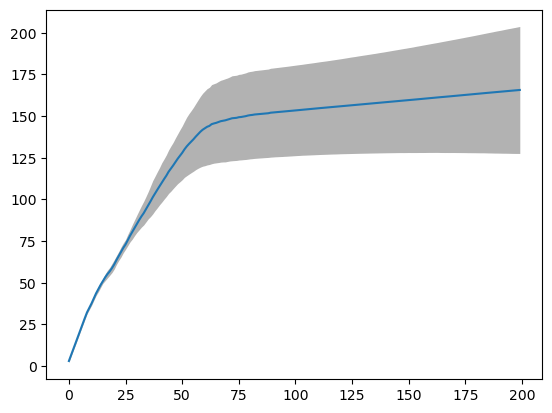

In [67]:
plt.plot(mean_regret_gpucb)
plt.fill_between(range(200), mean_regret_gpucb+np.sqrt(var_regret_gpucb),mean_regret_gpucb-np.sqrt(var_regret_gpucb),color="black" , alpha=.3, linewidth=0)

## Greedy

In [68]:
# for f_2
S=30
regret_greedy=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_3(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[10000,3])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = greedy(data_sim, env,RS=s)
    for i in range(200):
        agent.learn()
    f_values_greedy=agent.T
    f_max=3.86278                   # remember to change this value #5
                                                              #0
    regret_simple_greedy=f_max-np.array(f_values_greedy)
    regret_greedy.append(np.cumsum(regret_simple_greedy))

regret_greedy = np.asarray(regret_greedy) #/np.arange(1,201)
mean_regret_greedy = np.mean(regret_greedy, axis=0)
var_regret_greedy = np.var(regret_greedy, axis=0)

start of iteration number: 1
(10000, 3)
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.244360
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.141380
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.210846
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.222541
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.238848
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.283527
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.216289
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.194123
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.116882
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.333108
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.229322
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.183476
(python) Sampled:  [0.52548922 0.92109816 0.29507004]  result: 0.165123
(python) Sampled:  [0.52

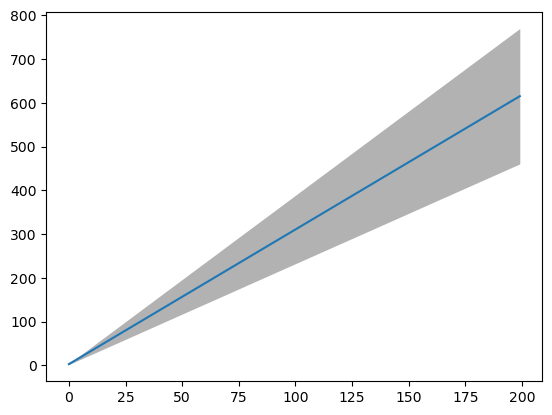

In [69]:
plt.plot(mean_regret_greedy)
plt.fill_between(range(200), mean_regret_greedy+np.sqrt(var_regret_greedy),mean_regret_greedy-np.sqrt(var_regret_greedy),color="black" , alpha=.3, linewidth=0)

## Pure exploration

In [70]:
# for f_2
S=30
regret_pexp=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_3(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[10000,3])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = pure_exploration(data_sim, env,RS=s)
    for i in range(200):
        agent.learn()
    f_values_pexp=agent.T
    f_max=3.86278                  # remember to change this value #5
                                                              #0
    regret_simple_pexp=f_max-np.array(f_values_pexp)
    regret_pexp.append(np.cumsum(regret_simple_pexp))

regret_pexp = np.asarray(regret_pexp) #/np.arange(1,201)
mean_regret_pexp = np.mean(regret_pexp, axis=0)
var_regret_pexp = np.var(regret_pexp, axis=0)

start of iteration number: 1
(10000, 3)
(python) Sampled:  [0.59136086 0.7243399  0.51641944]  result: 1.179622
(python) Sampled:  [0.02673522 0.00259798 0.98675134]  result: 0.117354
(python) Sampled:  [0.94719118 0.00515661 0.03153763]  result: 0.078429
(python) Sampled:  [0.03979267 0.98114354 0.00678159]  result: 0.031571
(python) Sampled:  [0.96935543 0.0154275  0.982108  ]  result: 0.084415
(python) Sampled:  [0.01887066 0.96583065 0.95801286]  result: 0.649053
(python) Sampled:  [0.03638924 0.02323222 0.02147131]  result: 0.067143
(python) Sampled:  [0.98389601 0.99252583 0.02706735]  result: 0.065316
(python) Sampled:  [0.99942917 0.9916098  0.90953179]  result: 0.476759
(python) Sampled:  [0.00284199 0.50770676 0.5404436 ]  result: 0.978626
(python) Sampled:  [0.37848895 0.45510542 0.9992115 ]  result: 1.888514
(python) Sampled:  [0.48322858 0.00155885 0.514576  ]  result: 0.114070
(python) Sampled:  [0.49632887 0.48652737 0.01356218]  result: 0.086922
(python) Sampled:  [0.99

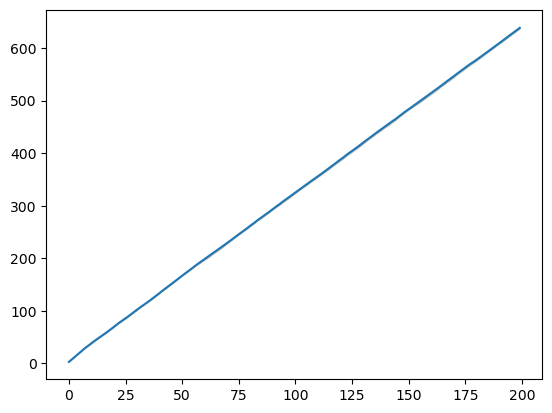

In [71]:
plt.plot(mean_regret_pexp)
plt.fill_between(range(200), mean_regret_pexp+np.sqrt(var_regret_pexp),mean_regret_pexp-np.sqrt(var_regret_pexp),color="black" , alpha=.3, linewidth=0)

## PI

In [72]:
xi_values=[0,0.0001,0.0005,0.0008,0.001,0.003,0.005,0.007,0.01,0.05,0.8,0.1,0.3,0.5,0.7,1,1.5,2,2.5,3]
total_cum_regret=[]
for x in xi_values:
    S=10
    regret_pi=[]
    class DummyEnvironment_sim(object):
        def sample(self, x):
          return black_box_function_3(x)

    for s in range(S):
        print("start of iteration number:",s+1)
        env = DummyEnvironment_sim()
        data_sim=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[1000,3])         # remember to change this value    
                                                                                #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                                # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
        agent = PI(data_sim, env,xi=x,RS=s)
        for i in range(150):
            agent.learn()
        f_values_pi=agent.T
        f_max=3.86278                    # remember to change this value #5
                                                                  #0
        regret_simple_pi=f_max-np.array(f_values_pi)
        regret_pi.append(np.cumsum(regret_simple_pi))
    regret_pi = np.asarray(regret_pi) #/np.arange(1,201)
    mean_regret_pi = np.mean(regret_pi, axis=0)
    total_cum_regret.append(sum(mean_regret_pi))


xi_cv_pi=xi_values[np.argmin(np.array(total_cum_regret))]



    

start of iteration number: 1
(1000, 3)
(python) Sampled:  [0.91787677 0.25982238 0.91174593]  result: 1.377889
(python) Sampled:  [0.91787677 0.25982238 0.91174593]  result: 1.396738
(python) Sampled:  [0.869002   0.33976324 0.84066818]  result: 2.469570
(python) Sampled:  [0.83252962 0.92103673 0.53331841]  result: 0.562969
(python) Sampled:  [0.27421633 0.19635099 0.21319172]  result: 0.866866
(python) Sampled:  [0.7198175  0.55431495 0.79423714]  result: 3.289278
(python) Sampled:  [0.70870838 0.42163377 0.69017479]  result: 1.879614
(python) Sampled:  [0.8734534  0.83404379 0.92075506]  result: 1.519514
(python) Sampled:  [0.03116392 0.4109799  0.05573424]  result: -0.003695
(python) Sampled:  [0.64224343 0.4651988  0.96290382]  result: 2.307915
(python) Sampled:  [0.81750129 0.59874799 0.85053889]  result: 3.544476
(python) Sampled:  [0.44100644 0.9808494  0.90984395]  result: 0.708831
(python) Sampled:  [0.14421006 0.07197235 0.26009718]  result: 0.879363
(python) Sampled:  [0.47

In [73]:
xi_cv_pi

0.0008

In [74]:
# for f_2
S=30
regret_pi=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_3(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[10000,3])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = PI(data_sim, env,xi=xi_cv_pi,RS=s)
    for i in range(200):
        agent.learn()
    f_values_pi=agent.T
    f_max=3.86278                   # remember to change this value #5
                                                              #0
    regret_simple_pi=f_max-np.array(f_values_pi)
    regret_pi.append(np.cumsum(regret_simple_pi))

regret_pi = np.asarray(regret_pi) #/np.arange(1,201)
mean_regret_pi = np.mean(regret_pi, axis=0)
var_regret_pi = np.var(regret_pi, axis=0)

start of iteration number: 1
(10000, 3)
(python) Sampled:  [0.30362316 0.02576971 0.34408631]  result: 0.729625
(python) Sampled:  [0.28599003 0.07433423 0.3594996 ]  result: 0.770245
(python) Sampled:  [0.18863687 0.30411922 0.44453209]  result: 0.346247
(python) Sampled:  [0.35618005 0.15511293 0.31229529]  result: 0.950404
(python) Sampled:  [0.43944246 0.19801932 0.25788863]  result: 0.922789
(python) Sampled:  [0.34768366 0.16101556 0.2393315 ]  result: 0.945712
(python) Sampled:  [0.40977378 0.18059024 0.34185651]  result: 0.768243
(python) Sampled:  [0.36281671 0.14747092 0.24859063]  result: 0.867284
(python) Sampled:  [0.13700338 0.85038239 0.29331939]  result: 0.415957
(python) Sampled:  [0.35302461 0.64879917 0.22216953]  result: 0.145549
(python) Sampled:  [0.23068657 0.30560903 0.16512205]  result: 0.475281
(python) Sampled:  [0.1838519  0.95111827 0.51715162]  result: 2.602169
(python) Sampled:  [0.99619549 0.61235389 0.51156614]  result: 0.334992
(python) Sampled:  [0.05

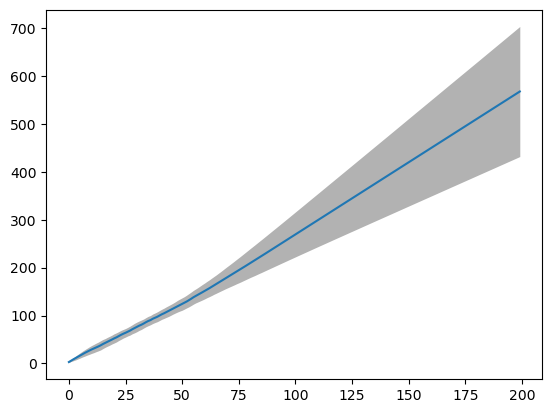

In [75]:
plt.plot(mean_regret_pi)
plt.fill_between(range(200), mean_regret_pi+np.sqrt(var_regret_pi),mean_regret_pi-np.sqrt(var_regret_pi),color="black" , alpha=.3, linewidth=0)

## EI

In [76]:
xi_values=[0,0.0001,0.0005,0.0008,0.001,0.003,0.005,0.007,0.01,0.05,0.8,0.1,0.3,0.5,0.7,1,1.5,2,2.5,3]
total_cum_regret=[]
for x in xi_values:
    S=10
    regret_ei=[]
    class DummyEnvironment_sim(object):
        def sample(self, x):
          return black_box_function_2(x)

    for s in range(S):
        print("start of iteration number:",s+1)
        env = DummyEnvironment_sim()
        data_sim=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[1000,3])         # remember to change this value    
                                                                                #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                                # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
        agent = EI(data_sim, env,xi=x,RS=s)
        for i in range(150):
            agent.learn()
        f_values_ei=agent.T
        f_max=3.86278                 # remember to change this value #5
                                                                  #0
        regret_simple_ei=f_max-np.array(f_values_ei)
        regret_ei.append(np.cumsum(regret_simple_ei))
    regret_ei = np.asarray(regret_ei) #/np.arange(1,201)
    mean_regret_ei = np.mean(regret_ei, axis=0)
    total_cum_regret.append(sum(mean_regret_ei))


xi_cv_ei=xi_values[np.argmin(np.array(total_cum_regret))]



    

start of iteration number: 1
(1000, 3)
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.156600
(python) Sampled:  [0.96640777 0.97832568 0.04712726]  result: -1.022891
(python) Sampled:  [0.96640777 0.97832568 0.04712726]  result: -1.203524
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.086068
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.125129
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.101342
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.144311
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.122262
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.215298
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.218905
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.138690
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -107.043553
(python) Sampled:  [0.39880058 0.33888167 0.52588562]  result: -1

In [77]:
xi_cv_ei

0.8

In [78]:
# for f_2
S=30
regret_ei=[]
class DummyEnvironment_sim(object):
    def sample(self, x):
      return black_box_function_3(x)
       
for s in range(S):
    print("start of iteration number:",s+1)
    env = DummyEnvironment_sim()
    data_sim=np.random.uniform(low=[0,0,0],high=[1,1,1],size=[10000,3])         # remember to change this value    
                                                                            #np.random.uniform(low=[0,0],high=[2,2],size=[10000,2])
                                                                            # np.random.uniform(low=[-2,-1],high=[2,3],size=[10000,2])
    agent = EI(data_sim, env,xi=xi_cv_ei,RS=s)
    for i in range(200):
        agent.learn()
    f_values_ei=agent.T
    f_max=3.86278                   # remember to change this value #5
                                                              #0
    regret_simple_ei=f_max-np.array(f_values_ei)
    regret_ei.append(np.cumsum(regret_simple_ei))

regret_ei = np.asarray(regret_ei) #/np.arange(1,201)
mean_regret_ei = np.mean(regret_ei, axis=0)
var_regret_ei = np.var(regret_ei, axis=0)

start of iteration number: 1
(10000, 3)
(python) Sampled:  [0.29964614 0.13060616 0.90589433]  result: 0.729191
(python) Sampled:  [0.95938092 0.96107559 0.00174932]  result: -0.036078
(python) Sampled:  [0.0055473  0.03283102 0.03722208]  result: 0.143022
(python) Sampled:  [0.03796637 0.96611598 0.98228108]  result: 0.574618
(python) Sampled:  [0.99228266 0.47584557 0.99921635]  result: 1.774413
(python) Sampled:  [0.99125932 0.00723698 0.4879621 ]  result: 0.054704
(python) Sampled:  [0.97112955 0.97156663 0.99532652]  result: 0.404865
(python) Sampled:  [0.02078476 0.99628949 0.0085048 ]  result: -0.064362
(python) Sampled:  [9.88019647e-01 6.77325461e-04 9.55486093e-01]  result: 0.208727
(python) Sampled:  [0.55490103 0.54989013 0.63292884]  result: 1.489016
(python) Sampled:  [0.00092309 0.50117013 0.59700054]  result: 1.325406
(python) Sampled:  [0.99938048 0.37232093 0.00275721]  result: 0.033417
(python) Sampled:  [0.99519895 0.62314715 0.62961836]  result: 0.965670
(python) S

In [79]:
regret_ei.shape

(30, 200)

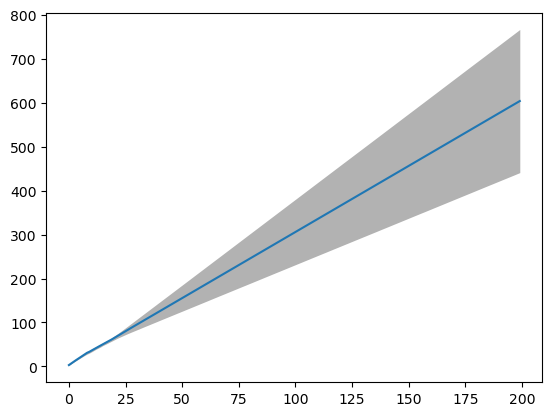

In [80]:
plt.plot(mean_regret_ei)
plt.fill_between(range(200), mean_regret_ei+np.sqrt(var_regret_ei),mean_regret_ei-np.sqrt(var_regret_ei),color="black" , alpha=.3, linewidth=0)

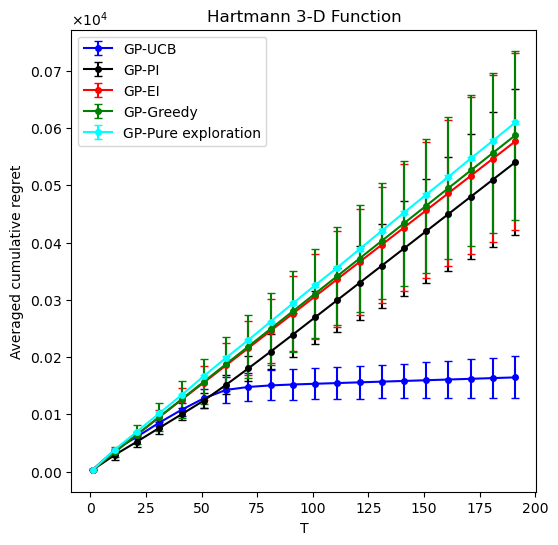

In [81]:






T = np.arange(1, 201)  

# Define the interval for showing error bars (e.g., every 10 points)
interval = 10

plt.figure(figsize=(6,6))

# Plot GP-UCB with error bars
plt.errorbar(T[::interval], mean_regret_gpucb[::interval], yerr=np.sqrt(var_regret_gpucb)[::interval],
             label="GP-UCB", fmt='-o', color='blue', capsize=3, markersize=4)

# Plot GP-PI with error bars
plt.errorbar(T[::interval], mean_regret_pi[::interval], yerr=np.sqrt(var_regret_pi)[::interval],
             label="GP-PI", fmt='-o', color='black', capsize=3, markersize=4)

# Plot GP-EI with error bars
plt.errorbar(T[::interval], mean_regret_ei[::interval], yerr=np.sqrt(var_regret_ei)[::interval],
             label="GP-EI", fmt='-o', color='red', capsize=3, markersize=4)

# Plot GP-Greedy with error bars
plt.errorbar(T[::interval], mean_regret_greedy[::interval], yerr=np.sqrt(var_regret_greedy)[::interval],
             label="GP-Greedy", fmt='-o', color='green', capsize=3, markersize=4)

# Plot GP-Pure exploration with error bars
plt.errorbar(T[::interval], mean_regret_pexp[::interval], yerr=np.sqrt(var_regret_pexp)[::interval],
             label="GP-Pure exploration", fmt='-o', color='cyan', capsize=3, markersize=4)

# Set labels and legend
plt.xlabel("T")
plt.ylabel("Averaged cumulative regret")
plt.legend()
plt.title("Hartmann 3-D Function")
# Use ScalarFormatter to set scientific notation on the y-axis
plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
plt.ticklabel_format(axis='y', style='sci', scilimits=(4,4))  # Set scientific notation with exponent 4
plt.show()


## Contour plots

In [82]:
np.random.seed(100)

## first function

## GP UCB

In [83]:
np.random.seed(100)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_1(x)
        
env = DummyEnvironment()
agent = GPUCB(data1, env,d=2,r=3)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
inf
(python) Sampled:  [0.3381495  1.66000099]  result: 4.038864
4.038864344080092
101.65212366626375
(python) Sampled:  [1.04348973 2.87750702]  result: 1.490210
4.038864344080092
200.02314071891894
(python) Sampled:  [1.70962399 0.84895033]  result: 4.531270
4.5312695764271975
271.82086326512433
(python) Sampled:  [0.35928883 0.00801042]  result: 3.592824
4.5312695764271975
329.143150662339
(python) Sampled:  [2.99061097 2.02134535]  result: 0.043388
4.5312695764271975
377.25336924955576
(python) Sampled:  [2.95862883 0.00307956]  result: 0.195634
4.5312695764271975
418.9278809845833
(python) Sampled:  [0.02131651 2.99320746]  result: 0.080362
4.5312695764271975
455.8229361690333
(python) Sampled:  [2.39628411 2.99497046]  result: -0.983019
4.5312695764271975
489.012153496524
(python) Sampled:  [1.4783153  0.00195106]  result: 3.765638
4.5312695764271975
519.2343363559902
(python) Sampled:  [1.56757456 1.88965078]  result: 3.899131
4.5312695764271975
547.0213367847697
(pyt

C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


4.997929242747073
843.8925429388612
(python) Sampled:  [1.56973062 1.32621154]  result: 4.637071
4.997929242747073
855.9606362455148
(python) Sampled:  [0.94486013 0.74738621]  result: 4.916834
4.997929242747073
867.6854420507261
(python) Sampled:  [2.27534125 2.30722214]  result: 1.667459
4.997929242747073
879.0875662311352
(python) Sampled:  [1.58084303 2.57202264]  result: 2.202486
4.997929242747073
890.1857596919293
(python) Sampled:  [0.83997984 1.16288314]  result: 4.875702
4.997929242747073
900.9971378371887
(python) Sampled:  [0.89366729 0.00840407]  result: 3.967613
4.997929242747073
911.5373682213558
(python) Sampled:  [0.45669538 2.98420021]  result: 0.808592
4.997929242747073
921.8208317951093
(python) Sampled:  [1.16247978 1.04029525]  result: 5.009499
5.009498851991936
931.8607621094397
(python) Sampled:  [1.05591894 0.97244011]  result: 4.973316
5.009498851991936
941.6693660192805
(python) Sampled:  [2.73510835 1.39280498]  result: 1.894584
5.009498851991936
951.25792877

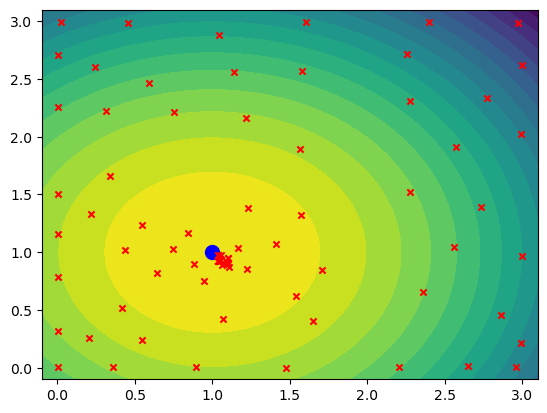

In [84]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## Greedy

In [85]:
np.random.seed(0)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_1(x)
        
env = DummyEnvironment()
agent = greedy(data1, env)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: 4.214555
4.214555235031209
(python) Sampled:  [0.3381495  1.66000099]  result: 4.146360
4.214555235031209
(python) Sampled:  [0.3381495  1.66000099]  result: 4.175290
4.214555235031209
(python) Sampled:  [0.3381495  1.66000099]  result: 4.238397
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.219731
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.077489
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.173857
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.118785
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.121192
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.146883
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.133555
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.199066
4.2383972776929
(python) Sampled:  [0.3381495  1.66000099]  result: 4.16440

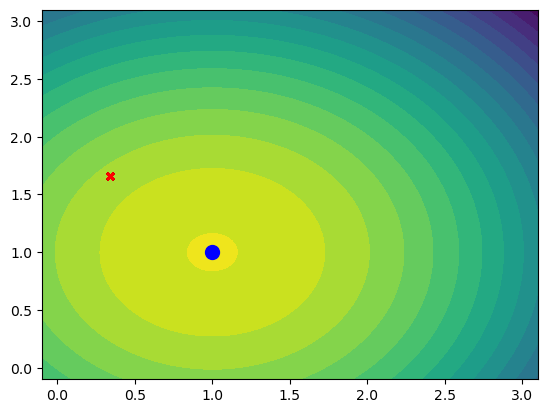

In [86]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## Pure Exploration

In [87]:
np.random.seed(100)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_1(x)
        
env = DummyEnvironment()
agent = pure_exploration(data1, env)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: 4.038864
4.038864344080092
(python) Sampled:  [2.99518541 0.0506775 ]  result: 0.135156
4.038864344080092
(python) Sampled:  [2.97507051 2.98864569]  result: -2.797963
4.038864344080092
(python) Sampled:  [0.00630056 0.00883956]  result: 3.017541
4.038864344080092
(python) Sampled:  [1.23783031 2.99777148]  result: 1.001412
4.038864344080092
(python) Sampled:  [2.04505531 1.38969618]  result: 3.781707
4.038864344080092
(python) Sampled:  [1.4783153  0.00195106]  result: 3.786172
4.038864344080092
(python) Sampled:  [0.02131651 2.99320746]  result: 0.015800
4.038864344080092
(python) Sampled:  [2.99870924 1.70207773]  result: 0.502773
4.038864344080092
(python) Sampled:  [0.84694738 0.79513637]  result: 4.947356
4.947355859891797
(python) Sampled:  [2.12705222 2.41350199]  result: 1.708864
4.947355859891797
(python) Sampled:  [0.00229834 0.93662671]  result: 4.022333
4.947355859891797
(python) Sampled:  [2.99436392 0.8517793

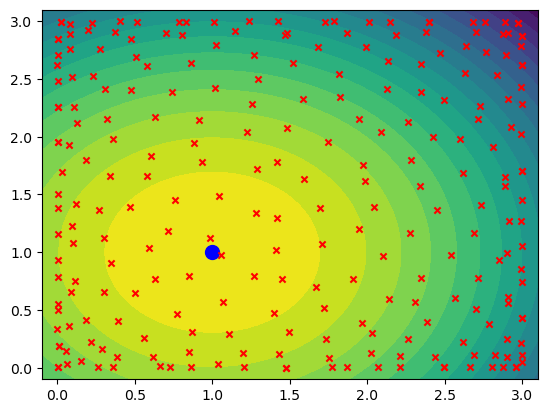

In [88]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## PI

In [89]:
np.random.seed(100)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_1(x)
        
env = DummyEnvironment()
agent = PI(data1, env,xi=0.05)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: 4.038864
4.038864344080092
(python) Sampled:  [0.49274405 1.68757152]  result: 4.287071
4.287070830072821
(python) Sampled:  [0.62705258 1.72485071]  result: 4.393153
4.393153462357543
(python) Sampled:  [0.71785918 1.617044  ]  result: 4.527031
4.527031459066198
(python) Sampled:  [0.79545362 1.48227195]  result: 4.774641
4.774640577892036
(python) Sampled:  [0.86338846 1.12702235]  result: 4.990914
4.990913552724085
(python) Sampled:  [0.97167386 1.22893385]  result: 4.957846
4.990913552724085
(python) Sampled:  [0.47580702 2.40735487]  result: 2.691072
4.990913552724085
(python) Sampled:  [0.02073382 2.20990772]  result: 2.567686
4.990913552724085
(python) Sampled:  [0.85290257 1.23687701]  result: 4.935002
4.990913552724085
(python) Sampled:  [0.48292803 1.02209325]  result: 4.709247
4.990913552724085
(python) Sampled:  [0.13796364 0.5878768 ]  result: 4.108806
4.990913552724085
(python) Sampled:  [2.12256545 1.74304343

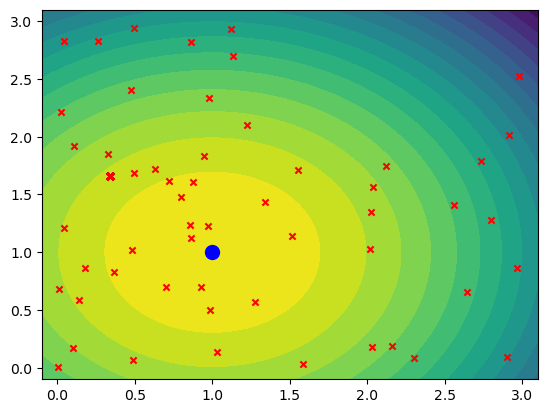

In [90]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## EI

In [91]:
np.random.seed(100)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_1(x)
        
env = DummyEnvironment()
agent = EI(data1, env,xi=0.05)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: 4.038864
4.038864344080092
(python) Sampled:  [0.67207189 1.64157365]  result: 4.497980
4.497980429932077
(python) Sampled:  [0.80327986 1.39241441]  result: 4.864964
4.864963906146471
(python) Sampled:  [0.73240095 1.16901669]  result: 4.887202
4.887202303811272
(python) Sampled:  [0.95285885 1.16707977]  result: 5.018928
5.018928102733284
(python) Sampled:  [1.27408883 1.26075113]  result: 4.882595
5.018928102733284
(python) Sampled:  [1.4230625  0.75520292]  result: 4.772151
5.018928102733284
(python) Sampled:  [1.09059981 0.08672855]  result: 4.104225
5.018928102733284
(python) Sampled:  [2.49622102e+00 2.04683382e-03]  result: 1.755937
5.018928102733284
(python) Sampled:  [2.93837803 1.70469269]  result: 0.758849
5.018928102733284
(python) Sampled:  [0.00630056 0.00883956]  result: 3.007261
5.018928102733284
(python) Sampled:  [1.96437063 2.9885877 ]  result: 0.137266
5.018928102733284
(python) Sampled:  [1.04928214 0.

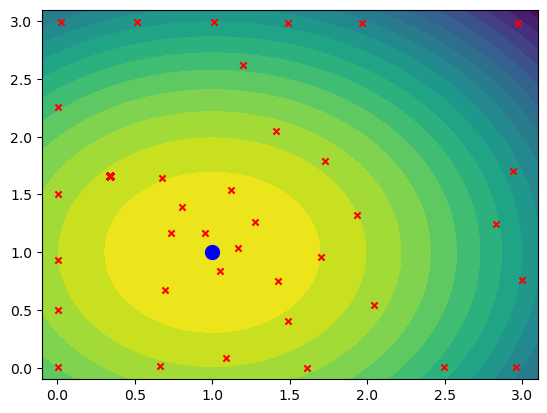

In [92]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_1([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([1],[1],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## Second Function

## GPUCB

In [111]:
np.random.seed(6969)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_2(x)
        
env = DummyEnvironment()
agent = GPUCB(data1, env,d=2,r=3)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
inf
(python) Sampled:  [0.3381495  1.66000099]  result: -7.776251
-7.776250890423896
101.65212366626375
(python) Sampled:  [2.99518541 0.0506775 ]  result: -2431.598283
-7.776250890423896
200.02314071891894
(python) Sampled:  [0.00876969 2.80594877]  result: -71.734611
-7.776250890423896
271.82086326512433
(python) Sampled:  [0.0014035  1.04650761]  result: -94.266731
-7.776250890423896
329.143150662339
(python) Sampled:  [0.86343435 2.13945205]  result: -126.885812
-7.776250890423896
377.25336924955576
(python) Sampled:  [0.01029586 1.90753677]  result: -4.460623
-4.460622681141214
418.9278809845833
(python) Sampled:  [0.12484886 1.77619769]  result: -3.526662
-3.5266623884395885
455.8229361690333
(python) Sampled:  [0.11309617 1.80780087]  result: -3.577036
-3.5266623884395885
489.012153496524
(python) Sampled:  [0.12484886 1.77619769]  result: -3.562514
-3.5266623884395885
519.2343363559902
(python) Sampled:  [0.10114563 1.80777699]  result: -3.580062
-3.5266623884395885


C:\Users\SOUMYA GHATAK\AppData\Local\Temp\ipykernel_7928\759544359.py:29: RuntimeWarning: divide by zero encountered in log
  self.beta_k=2*np.log(self.t**2*2*(np.pi)**2/(3*0.05))*+2*(2)*np.log(self.t**2*(self.d*self.r)*np.sqrt(np.log(4*2/0.05)))


-3.4319728935559817
867.6854420507261
(python) Sampled:  [0.12484886 1.77619769]  result: -3.610755
-3.4319728935559817
879.0875662311352
(python) Sampled:  [0.12484886 1.77619769]  result: -3.492631
-3.4319728935559817
890.1857596919293
(python) Sampled:  [0.12484886 1.77619769]  result: -3.520924
-3.4319728935559817
900.9971378371887
(python) Sampled:  [0.12484886 1.77619769]  result: -3.566650
-3.4319728935559817
911.5373682213558
(python) Sampled:  [0.12484886 1.77619769]  result: -3.557795
-3.4319728935559817
921.8208317951093
(python) Sampled:  [0.12484886 1.77619769]  result: -3.535803
-3.4319728935559817
931.8607621094397
(python) Sampled:  [0.12484886 1.77619769]  result: -3.486806
-3.4319728935559817
941.6693660192805
(python) Sampled:  [0.12484886 1.77619769]  result: -3.529030
-3.4319728935559817
951.2579287786708
(python) Sampled:  [0.12484886 1.77619769]  result: -3.509969
-3.4319728935559817
960.6369059031123
(python) Sampled:  [0.12484886 1.77619769]  result: -3.594626


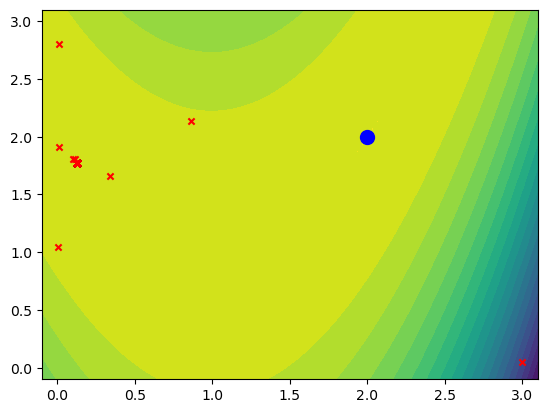

In [112]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## Greedy

In [95]:
np.random.seed(4586)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_2(x)
        
env = DummyEnvironment()
agent = greedy(data1, env)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: -7.638995
-7.638994523088377
(python) Sampled:  [2.99518541 0.0506775 ]  result: -2431.584466
-7.638994523088377
(python) Sampled:  [0.00416357 2.25404437]  result: -10.847226
-7.638994523088377
(python) Sampled:  [0.00471946 1.38502649]  result: -40.671047
-7.638994523088377
(python) Sampled:  [0.82993465 2.42486162]  result: -196.198898
-7.638994523088377
(python) Sampled:  [1.30186404e-03 1.95756918e+00]  result: -4.223634
-4.223633607590159
(python) Sampled:  [1.30186404e-03 1.95756918e+00]  result: -4.127807
-4.127807258262406
(python) Sampled:  [1.30186404e-03 1.95756918e+00]  result: -4.204858
-4.127807258262406
(python) Sampled:  [1.30186404e-03 1.95756918e+00]  result: -4.135239
-4.127807258262406
(python) Sampled:  [1.30186404e-03 1.95756918e+00]  result: -4.125104
-4.125104202118256
(python) Sampled:  [1.30186404e-03 1.95756918e+00]  result: -4.257641
-4.125104202118256
(python) Sampled:  [1.30186404e-03 1.957569

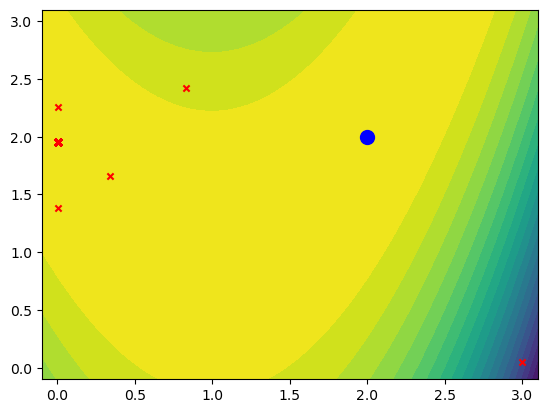

In [96]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## Pure exploration

In [97]:
np.random.seed(4586)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_2(x)
        
env = DummyEnvironment()
agent = pure_exploration(data1, env)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: -7.638995
-7.638994523088377
(python) Sampled:  [2.99518541 0.0506775 ]  result: -2431.584466
-7.638994523088377
(python) Sampled:  [2.97507051 2.98864569]  result: -366.604652
-7.638994523088377
(python) Sampled:  [0.00630056 0.00883956]  result: -395.480231
-7.638994523088377
(python) Sampled:  [1.23783031 2.99777148]  result: -377.375006
-7.638994523088377
(python) Sampled:  [2.04505531 1.38969618]  result: -49.415052
-7.638994523088377
(python) Sampled:  [1.4783153  0.00195106]  result: -150.758816
-7.638994523088377
(python) Sampled:  [0.02131651 2.99320746]  result: -111.169056
-7.638994523088377
(python) Sampled:  [2.99870924 1.70207773]  result: -1085.206664
-7.638994523088377
(python) Sampled:  [0.84694738 0.79513637]  result: -6.512782
-6.512781798524964
(python) Sampled:  [2.12705222 2.41350199]  result: -2.172563
-2.1725631759083677
(python) Sampled:  [0.00229834 0.93662671]  result: -116.086663
-2.1725631759083

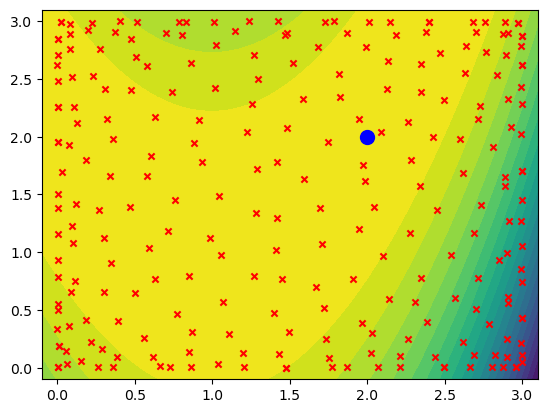

In [98]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## PI

In [99]:
np.random.seed(100)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_2(x)
        
env = DummyEnvironment()
agent = PI(data1, env,xi=0.05)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: -7.775633
-7.7756332763350215
(python) Sampled:  [2.96049212 0.00870433]  result: -2338.458699
-7.7756332763350215
(python) Sampled:  [0.47580702 2.40735487]  result: -130.538486
-7.7756332763350215
(python) Sampled:  [0.48292803 1.02209325]  result: -8.329875
-7.7756332763350215
(python) Sampled:  [0.17864454 0.85936079]  result: -69.733808
-7.7756332763350215
(python) Sampled:  [0.94344092 1.83100914]  result: -69.617581
-7.7756332763350215
(python) Sampled:  [0.29554667 1.42234177]  result: -3.440411
-3.4404112386087764
(python) Sampled:  [0.5433025  1.28765328]  result: -2.800845
-2.800845037950695
(python) Sampled:  [0.09793339 1.76666787]  result: -3.848762
-2.800845037950695
(python) Sampled:  [0.32584924 1.49936851]  result: -2.991535
-2.800845037950695
(python) Sampled:  [0.56997646 1.24604707]  result: -2.441518
-2.441517547172785
(python) Sampled:  [0.05581981 1.60107992]  result: -12.191080
-2.441517547172785
(p

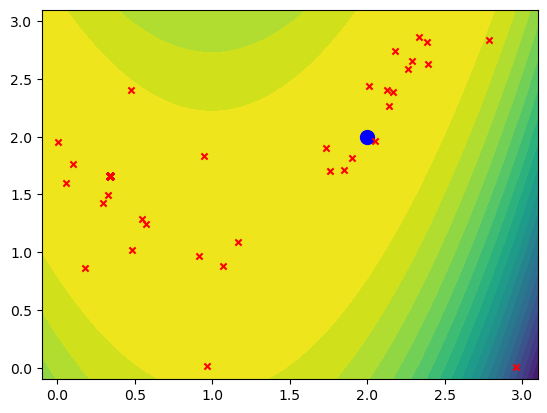

In [100]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')

## EI

In [101]:
np.random.seed(100)
class DummyEnvironment(object):
    def sample(self, x):
      return black_box_function_2(x)
        
env = DummyEnvironment()
agent = EI(data1, env,xi=0.05)
for i in range(250):
    #agent.beta_t()
    agent.learn()
    print(agent.y_max())

(10000, 2)
(python) Sampled:  [0.3381495  1.66000099]  result: -7.775633
-7.7756332763350215
(python) Sampled:  [2.99518541 0.0506775 ]  result: -2431.549365
-7.7756332763350215
(python) Sampled:  [0.00416357 2.25404437]  result: -10.808683
-7.7756332763350215
(python) Sampled:  [0.00471946 1.38502649]  result: -40.663678
-7.7756332763350215
(python) Sampled:  [0.82993465 2.42486162]  result: -196.184666
-7.7756332763350215
(python) Sampled:  [1.30186404e-03 1.95756918e+00]  result: -4.127717
-4.127716549602547
(python) Sampled:  [0.3381495  1.66000099]  result: -7.677086
-4.127716549602547
(python) Sampled:  [0.3381495  1.66000099]  result: -7.741647
-4.127716549602547
(python) Sampled:  [0.3381495  1.66000099]  result: -7.697620
-4.127716549602547
(python) Sampled:  [0.3381495  1.66000099]  result: -7.675395
-4.127716549602547
(python) Sampled:  [0.3381495  1.66000099]  result: -7.711046
-4.127716549602547
(python) Sampled:  [0.3381495  1.66000099]  result: -7.666387
-4.1277165496025

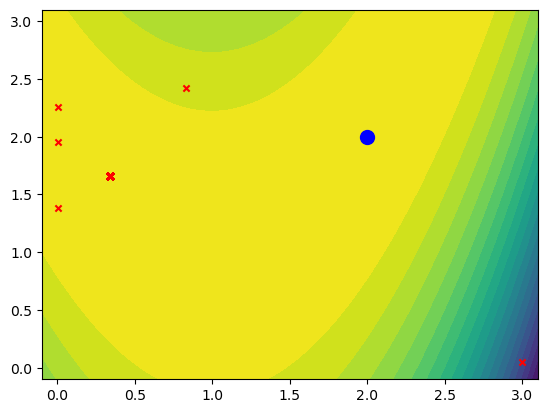

In [102]:
u1=np.linspace(-0.1,3.1,100)
v1=np.linspace(-0.1,3.1,100)
[X,Y]=np.meshgrid(u1,v1)
Z=black_box_function_2([X,Y])
plt.contourf(u1,v1,Z, levels=20, cmap='viridis')
plt.scatter([2],[2],s=100,color="blue",marker='o')
plt.scatter(np.array(agent.X)[0:,0],np.array(agent.X)[0:,1],s=20,color="red",marker='x')